<H1> Denoising of noised crypted images <H1>


# Initialisation

## Install settings

In [1]:
#CNN lib
import tensorflow as tf
from tensorflow import keras

#Viewing data lib
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import plot_confusion_matrix

#Image processing lib
import cv2

#Util lib
import random
import math
import copy


#FOR DRIVE IMAGES MANIPULATION
import os, glob
from os import listdir
from os.path import isfile, join
from google.colab import drive

Instalation of mising library

In [2]:
#!pip install ..

## Image funtions manipulation

Reading function

In [3]:
def goToDriveFile() :
  my_doc_name = 'HAI927I - Projet CNN'
  my_image_db_folder = 'Images'


  %cd '/content/'
  drive.mount(os.getcwd() + '/drive')
  my_path = glob.glob(os.getcwd() + '/**/' + my_doc_name, recursive = True)

  my_path = [my_i for my_i in my_path if len(my_i) in [max([len(my_i) for my_i in my_path])]][0]; 
  my_path += '/' + my_image_db_folder
  %cd $my_path



def readAllImagesFromFilePath(filespath):
  goToDriveFile()
  img_names = []
  img_path = []

  for filepath in filespath :
    #we need to try to read all data in the file path
    if(filepath[-1] == '*'):
      filepath = filepath[:-1]
      imgndir = [ f for f in listdir(filepath) if isfile(join(filepath,f)) ]
      for name in imgndir :
        img_names.append(name)
        img_path.append(join(filepath,name))

    #we need to try to read unic data in the file path
    else :
       if isfile(filepath) :
         img_names.append(os.path.basename(filepath).split('/')[-1])
         img_path.append(filepath)

  img_data = []
  for img_p in img_path :
    img_data.append(cv2.cvtColor(cv2.imread(img_p), cv2.COLOR_BGR2RGB))
  
  return img_data, img_names

Viewing functions

In [4]:
def afficher_img(X,Xnames, figsize = (50,50), color = 'gray', axis = -1) :

  f = plt.figure(figsize=figsize)

  nb_lin = 0
  nb_col = 0
  if (axis ==  0) :
         nb_col = len(X)
         nb_lin = 1
  else :
     if (axis ==  1) :
         nb_lin = len(X)
         nb_col = 1
     else:
        nb_lin = math.sqrt(len(X))
        nb_lin = math.trunc(nb_lin)
        nb_col = (len(X) / nb_lin)+1


  index = 0
  for images in X :
    f.add_subplot(nb_lin, nb_col, index+1)
    ax = plt.gca()
    plt.subplots_adjust(hspace=0)
    
    #ax.get_xaxis().set_visible(False)
    ax.axes.xaxis.set_ticklabels([])
    ax.set_xticks([])
    ax.spines['bottom'].set_visible(False)
    ax.get_yaxis().set_visible(False)

    plt.xlabel(Xnames[index])
    plt.imshow(images, color)
    
    index+=1
  plt.show()


# Noising

Noising functions

In [5]:
def noiseImg_withrange(img, start = (0,0), end = (0,0), nb_pix_in_block_to_noise = 1, bit_mask = (0,0,0,0,0,0,0,0)) :
  mask_val = 0

  dim_x = end[0] - start[0]
  dim_y = end[1] - start[1]
  positions = random.sample(range(0,dim_x*dim_y), nb_pix_in_block_to_noise) 

  if(type(bit_mask) is tuple) :
   reversed(bit_mask)
   for i in range(0,8) :
     mask_val += (bit_mask[i] << i)
  else:
    if(type(bit_mask) is int) :
      mask_val = bit_mask
    else:
      raise Exception("Sorry, only 8 long tuples or int are accepted as bit_mask val")

  for pos in positions :
    y = math.trunc(pos / dim_x)
    x = pos - y * dim_x
    x += start[0]
    y += start[1]

    img[x,y,2] ^= mask_val 
    img[x,y,1] ^= mask_val 
    img[x,y,0] ^= mask_val 



def noiseAllImg(img, bit_mask = (0,0,0,0,0,0,0,0)) :
  noiseAllImg(img,(0,0),(len(img[0]), len(img)), len(img[0]) * len(img),bit_mask)


def noiseAllImg_block(img, block_size = (1,1), bit_mask = (0,0,0,0,0,0,0,0), block_noised_probability = 0.5, nb_pix_in_block_to_noise = 1) :
  nb_block_x = len(img[0]) // block_size[0]
  nb_block_y = len(img) // block_size[1]

  print(nb_block_x)
  print(nb_block_y)

  for i in range(0,nb_block_y): 
   for j in range(0,nb_block_x):

     rdm = random.random()
     if(rdm >= block_noised_probability) :
        start_b = (j * block_size[0],i * block_size[1])
        end_b = ((j+1) * block_size[0],(i+1) * block_size[1])

        noiseImg_withrange(img, start =start_b , end =end_b , nb_pix_in_block_to_noise = nb_pix_in_block_to_noise, bit_mask = bit_mask)



def noise_AES(img,dim, bit_mask = (0,0,0,0,0,0,0,0), noise_probability = 0.5) :
  img_res = bytearray(img)
  mask_val = 0
  if(type(bit_mask) is tuple) :
   reversed(bit_mask)
   for i in range(0,8) :
     mask_val += (bit_mask[i] << i)
  else :
    if(type(bit_mask) is bytes) :
      mask_val = bit_mask
    else:
      raise Exception("Sorry, only 8 long tuples or int are accepted as bit_mask val")

  probability_map = np.random.rand(1,len(img_res))[0]

  res = dim[0] * dim[1] * 3
  for i in range(0,res) :
    if(probability_map[i]<noise_probability):
      img_res[i] = img_res[i] ^ mask_val
  return img_res


def noise_AES_withblocks(img,dim, bit_mask = (0,0,0,0,0,0,0,0), noise_probability = 0.5, block_size = 1):
  img_res = bytearray(img)
  mask_val = 0

  if(type(bit_mask) is tuple) :
   reversed(bit_mask)
   for i in range(0,8) :
     mask_val += (bit_mask[i] << i)
  else :
    if(type(bit_mask) is bytes) :
      mask_val = bit_mask
    else:
      raise Exception("Sorry, only 8 long tuples or int are accepted as bit_mask val")

  nb_b = ( len(img_res)//block_size ) -1

  probability_map_tmp = np.random.rand(nb_b)
  probability_map = np.zeros(nb_b).astype(int)

  probability_map[probability_map_tmp<noise_probability] = random.randint(0,16)
  probability_map[probability_map_tmp>=noise_probability] = -1

  for i in range(0,nb_b) :
    if(probability_map[i]>(-1)):
      ind = probability_map[i] + (i * block_size)
      img_res[ind] = img_res[ind] ^ mask_val
  return img_res

# Encryption

## Crypto library

https://moodle.umontpellier.fr/pluginfile.php/1825673/mod_resource/content/1/Cours_M2_Imagina_Codage_et_Compression.pdf
https://pycryptodome.readthedocs.io/en/latest/index.html


In [6]:
!pip install pycryptodome
!pip install pycryptodome-test-vectors
!python -m Crypto.SelfTest

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 2.3 MB 9.2 MB/s 
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 12.0 MB 8.1 MB/s 
  Created wheel for pycryptodome-test-vectors: filename=pycryptodome_test_vectors-1.0.11-py2.py3-none-any.whl size=12144771 sha256=b1c6e786462953baca2d73de725e4f4bc232f5d999022355d9c2f10687258834
  Stored in directory: /root/.cache/pip/wheels/a1/df/37/64ea735a88ed1cf47520641389632badbd2606c169043cef78
Successfully built pycryptodome-test-vectors
...................................................................................................................................................................................................................................................................................................................................................

In [7]:
from Crypto.Cipher import AES
from Crypto.Random import get_random_bytes
from Crypto.Protocol.SecretSharing import Shamir

#for data block pading
#some kind of alog need special data length
from Crypto.Util.Padding import pad, unpad

#for data visualisation
from base64 import b64encode, b64decode
from binascii import hexlify, unhexlify
import json

## AES encryption

In [8]:
#key creation exemples
key_l = 16
key_val = 1024
key = (key_val).to_bytes(key_l, byteorder='big')


def prepare_image(img) :
  #get images dimensions
  nb_row = len(img)
  nb_col = len(img[0])
  nb_pixels_img = nb_col* nb_row* 3

  #flat the image
  img_flaten = np.reshape(img, (1,nb_pixels_img))[0]
  img_bytes = bytearray(img_flaten)
  return img_bytes, nb_pixels_img 

### Classic modes

#### ECB mode

In [9]:
from Crypto.Util.py3compat import *

def encrypt_AES_ECB(img,key) : 
  prepared_img, dim = prepare_image(img)
  nb_row = len(img)
  nb_col = len(img[0])

  #build encryption engine
  cipher = AES.new(key, AES.MODE_ECB)
  #encrypt image
  ct_bytes = cipher.encrypt(pad(prepared_img, AES.block_size))
  #prepare the image for data visualisation
  array_bytes = bytearray(ct_bytes)[:dim]
  img_crypted = np.reshape(array_bytes, (nb_row, nb_col, 3))

  return ct_bytes, img_crypted, (nb_row,nb_col)

def decrypt_AES_ECB(img,key,dimensions = (0,0)) :
  #build encryption engine
  cipher = AES.new(key, AES.MODE_ECB)
  decrypted_img = bytearray(unpad(cipher.decrypt(img), AES.block_size))
  return np.reshape(decrypted_img, (dimensions[0], dimensions[1], 3))


#### CBC mode

In [10]:
def encrypt_AES_CBC(img,key) : 
  prepared_img, dim = prepare_image(img)
  nb_row = len(img)
  nb_col = len(img[0])

  #build encryption engine
  cipher = AES.new(key, AES.MODE_CBC)
  #encrypt image
  ct_bytes = cipher.encrypt(pad(prepared_img, AES.block_size))
  #get the init vector
  iv = cipher.iv
  #prepare the image for data visualisation
  array_bytes = bytearray(ct_bytes)[:dim]
  img_crypted = np.reshape(array_bytes, (nb_row, nb_col, 3))

  return ct_bytes, img_crypted, (nb_row,nb_col), iv

def decrypt_AES_CBC(img,key,iv,dimensions = (0,0)) :
  #build encryption engine
  cipher = AES.new(key, AES.MODE_CBC,iv)
  decrypted_img = bytearray(unpad(cipher.decrypt(img), AES.block_size))
  return np.reshape(decrypted_img, (dimensions[0], dimensions[1], 3))


#### CTR mode

In [11]:
def encrypt_AES_CTR(img,key) : 
  prepared_img, dim = prepare_image(img)
  nb_row = len(img)
  nb_col = len(img[0])

  #build encryption engine
  cipher = AES.new(key, AES.MODE_CTR)
  #encrypt image
  ct_bytes = cipher.encrypt(prepared_img)
  #get the value of the fixed nonce
  nonce = cipher.nonce
  #prepare the image for data visualisation
  array_bytes = bytearray(ct_bytes)[:dim]
  img_crypted = np.reshape(array_bytes, (nb_row, nb_col, 3))

  return ct_bytes, img_crypted, (nb_row,nb_col), nonce

def decrypt_AES_CTR(img,key,nonce,dimensions = (0,0)) :
  #build encryption engine
  cipher = AES.new(key, AES.MODE_CTR, nonce=nonce)
  decrypted_img = bytearray(cipher.decrypt(img))
  return np.reshape(decrypted_img, (dimensions[0], dimensions[1], 3))


#### CFB mode

In [12]:
def encrypt_AES_CFB(img,key) : 
  prepared_img, dim = prepare_image(img)
  nb_row = len(img)
  nb_col = len(img[0])

  #build encryption engine
  cipher = AES.new(key, AES.MODE_CFB)
  #encrypt image
  ct_bytes = cipher.encrypt(prepared_img)
  #get the init vector value
  iv = cipher.iv
  #prepare the image for data visualisation
  array_bytes = bytearray(ct_bytes)[:dim]
  img_crypted = np.reshape(array_bytes, (nb_row, nb_col, 3))

  return ct_bytes, img_crypted, (nb_row,nb_col), iv

def decrypt_AES_CFB(img,key,iv,dimensions = (0,0)) :
  #build encryption engine
  cipher = AES.new(key, AES.MODE_CFB, iv=iv)
  decrypted_img = bytearray(cipher.decrypt(img))
  return np.reshape(decrypted_img, (dimensions[0], dimensions[1], 3))


#### OFB mode

In [13]:
def encrypt_AES_OFB(img,key) : 
  prepared_img, dim = prepare_image(img)
  nb_row = len(img)
  nb_col = len(img[0])

  #build encryption engine
  cipher = AES.new(key, AES.MODE_OFB)
  #encrypt image
  ct_bytes = cipher.encrypt(prepared_img)
  #get the init vector value
  iv = cipher.iv
  #prepare the image for data visualisation
  array_bytes = bytearray(ct_bytes)[:dim]
  img_crypted = np.reshape(array_bytes, (nb_row, nb_col, 3))

  return ct_bytes, img_crypted, (nb_row,nb_col), iv

def decrypt_AES_OFB(img,key,iv,dimensions = (0,0)) :
  #build encryption engine
  cipher = AES.new(key, AES.MODE_OFB, iv=iv)
  decrypted_img = bytearray(cipher.decrypt(img))
  return np.reshape(decrypted_img, (dimensions[0], dimensions[1], 3))


### Modern Modes

Classic modes of operation such as CBC only provide guarantees over the confidentiality of the message but not over its integrity. In other words, they don’t allow the receiver to establish if the ciphertext was modified in transit or if it really originates from a certain source.

<a href="https://pycryptodome.readthedocs.io/en/latest/src/cipher/modern.html">
 <img src="https://pycryptodome.readthedocs.io/en/latest/_images/aead.png"/>
</a>

#### CCM

In [14]:
def encrypt_AES_CCM(img, name,key) : 
  prepared_img, dim = prepare_image(img)

  nb_row = len(img)
  nb_col = len(img[0])

  #build encryption engine
  cipher = AES.new(key, AES.MODE_CCM)
  #prepare header
  header = bytes(name, 'utf-8')
  cipher.update(header)

  #encrypt image
  ct_bytes, tag = cipher.encrypt_and_digest(prepared_img)
  
  #prepare the image for data visualisation
  array_bytes = bytearray(ct_bytes)[:dim]
  img_crypted = np.reshape(array_bytes, (nb_row, nb_col, 3))

  return ct_bytes, img_crypted, cipher.nonce, tag,(nb_row,nb_col)

def decrypt_AES_CCM(img,key,name, nonce,tag,dimensions = (0,0)) :
  #build encryption engine
  cipher = AES.new(key, AES.MODE_CCM, nonce=nonce)
  #prepare header
  header = bytes(name, 'utf-8')
  cipher.update(header)

  decrypted_img = bytearray(cipher.decrypt_and_verify(img, tag))
  return np.reshape(decrypted_img, (dimensions[0], dimensions[1], 3))


#### GCM

In [15]:
def encrypt_AES_GCM(img, name,key) : 
  prepared_img, dim = prepare_image(img)

  nb_row = len(img)
  nb_col = len(img[0])

  #build encryption engine
  cipher = AES.new(key, AES.MODE_GCM)
  #prepare header
  header = bytes(name, 'utf-8')
  cipher.update(header)

  #encrypt image
  ct_bytes, tag = cipher.encrypt_and_digest(prepared_img)
  
  #prepare the image for data visualisation
  array_bytes = bytearray(ct_bytes)[:dim]
  img_crypted = np.reshape(array_bytes, (nb_row, nb_col, 3))

  return ct_bytes, img_crypted, cipher.nonce, tag,(nb_row,nb_col)

def decrypt_AES_GCM(img,key,name, nonce,tag,dimensions = (0,0)) :
  #build encryption engine
  cipher = AES.new(key, AES.MODE_GCM, nonce=nonce)
  #prepare header
  header = bytes(name, 'utf-8')
  cipher.update(header)

  decrypted_img = bytearray(cipher.decrypt_and_verify(img, tag))
  return np.reshape(decrypted_img, (dimensions[0], dimensions[1], 3))


#### SIV

In [16]:
def encrypt_AES_SIV(img, name,key = get_random_bytes(16*2), nonce = get_random_bytes(16)) : 
  prepared_img, dim = prepare_image(img)

  nb_row = len(img)
  nb_col = len(img[0])

  #build encryption engine
  cipher = AES.new(key, AES.MODE_SIV, nonce=nonce)
  #prepare header
  header = bytes(name, 'utf-8')
  cipher.update(header)

  #encrypt image
  ct_bytes, tag = cipher.encrypt_and_digest(prepared_img)
  
  #prepare the image for data visualisation
  array_bytes = bytearray(ct_bytes)[:dim]
  img_crypted = np.reshape(array_bytes, (nb_row, nb_col, 3))

  return ct_bytes, img_crypted, tag,(nb_row,nb_col)

def decrypt_AES_SIV(img,key,name, nonce,tag,dimensions = (0,0)) :
  #build encryption engine
  cipher = AES.new(key, AES.MODE_SIV, nonce=nonce)
  #prepare header
  header = bytes(name, 'utf-8')
  cipher.update(header)

  decrypted_img = bytearray(cipher.decrypt_and_verify(img, tag))
  return np.reshape(decrypted_img, (dimensions[0], dimensions[1], 3))


#### OCB

In [17]:
def encrypt_AES_OCB(img, name,key) : 
  prepared_img, dim = prepare_image(img)

  nb_row = len(img)
  nb_col = len(img[0])

  #build encryption engine
  cipher = AES.new(key, AES.MODE_OCB)
  #prepare header
  header = bytes(name, 'utf-8')
  cipher.update(header)

  #encrypt image
  ct_bytes, tag = cipher.encrypt_and_digest(prepared_img)
  
  #prepare the image for data visualisation
  array_bytes = bytearray(ct_bytes)[:dim]
  img_crypted = np.reshape(array_bytes, (nb_row, nb_col, 3))

  return ct_bytes, img_crypted, cipher.nonce, tag,(nb_row,nb_col)

def decrypt_AES_OCB(img,key,name, nonce,tag,dimensions = (0,0)) :
  #build encryption engine
  cipher = AES.new(key, AES.MODE_OCB, nonce=nonce)
  #prepare header
  header = bytes(name, 'utf-8')
  cipher.update(header)

  decrypted_img = bytearray(cipher.decrypt_and_verify(img, tag))
  return np.reshape(decrypted_img, (dimensions[0], dimensions[1], 3))


#### EAX

In [18]:
def encrypt_AES_EAX(img, name,key) : 
  prepared_img, dim = prepare_image(img)

  nb_row = len(img)
  nb_col = len(img[0])

  #build encryption engine
  cipher = AES.new(key, AES.MODE_EAX)
  #prepare header
  header = bytes(name, 'utf-8')
  cipher.update(header)

  #encrypt image
  ct_bytes, tag = cipher.encrypt_and_digest(prepared_img)
  
  #prepare the image for data visualisation
  array_bytes = bytearray(ct_bytes)[:dim]
  img_crypted = np.reshape(array_bytes, (nb_row, nb_col, 3))

  return ct_bytes, img_crypted, cipher.nonce, tag,(nb_row,nb_col)

def decrypt_AES_EAX(img,key,name, nonce,tag,dimensions = (0,0)) :
  #build encryption engine
  cipher = AES.new(key, AES.MODE_EAX, nonce=nonce)
  #prepare header
  header = bytes(name, 'utf-8')
  cipher.update(header)

  decrypted_img = bytearray(cipher.decrypt_and_verify(img, tag))
  return np.reshape(decrypted_img, (dimensions[0], dimensions[1], 3))


## Shamir encryption

How to share a secret : https://dl.acm.org/doi/pdf/10.1145/359168.359176
- k, n) threshold scheme with n = 2 k - 1 
- We can recover the original key even when [n/2J = k - 1 
- Safety and convenience of use.
- Based on polynomial interpolation: given k points in the 2-dimensional plane (x,, y, ... (xk, Yk). with distinct xi's , there is one and only one
polynomial q(x) of degree k - 1 such that q(x) =yi for all i.


PyCryptodome formlism :
 - Secret is a byte string of 16 bytes
 - Each share is a byte string of 16 bytes

PyCryptodome

In [19]:
def GF_get_visualisation_datas(shares, dim):
  shares_v = [[] for _ in range(0,len(shares))]
  for j in range(0,len(shares)) :
    for b in shares[j] :
      shares_v[j] = np.append(shares_v[j] , (bytearray(b))).astype(int)
  sh_visu = [] 
  d = dim[0] * dim[1] * 3
  for sh in shares_v :
    sh_visu.append(np.reshape(sh[:d],(dim[0],dim[1],3)))
  return sh_visu


def encrypt_Shamir_GF(img, k, n) :
  nb_row = len(img)
  nb_col = len(img[0])
  prepared_img = np.reshape(img,(1,nb_row *nb_col*3))[0]

  print(len(prepared_img))
  dim = len(prepared_img)
  rest_val = dim%16
  if(rest_val != 0) :
    print('adding ! ', 16-rest_val)
    prepared_img = np.resize(prepared_img,(len(prepared_img) + 16-rest_val))
  
  array_bytes = bytearray(prepared_img)
  
  print(len(array_bytes))
  
  nb_b_img = len(array_bytes)//16
  shares = [[] for _ in range(0,n)]
  #shares_v = [[] for _ in range(0,n)]
  
  step = 0

  
  for i in range(0,nb_b_img) :
    s_b = Shamir.split(k, n, bytes(array_bytes[step : step+16]))
    step+=16

    for (j,val) in s_b :
      shares[j-1].append(bytearray(val))
      #shares_v[j-1] = np.append(shares_v[j-1] , (bytearray(val))).astype(int)

 
  #sh_visu = [] 
  #for sh in shares_v :
  #  sh_visu.append(np.reshape(sh[:dim],(nb_row,nb_col,3)))
  
  return  shares, (nb_row, nb_col) #, sh_visu

def decrypt_Shamir_GF(shares, n, k = [] ,dimensions = (0,0)) :
  #prepare output image
  #flaten_shares = [bytearray(ar) for ar in shares]

  img_decrypted = [] 
  nb_b = len(shares[0])

  for i in range(0,nb_b) :
    elements = [(j,bytes(shares[j-1][i])) for j in k]
    val_img = Shamir.combine(elements)
    img_decrypted = np.append(img_decrypted, bytearray(val_img)).astype(int)
    
  print ('end')
  print(img_decrypted)
  print(len(img_decrypted))

  dim = dimensions[0] * dimensions[1] * 3
  return np.reshape(img_decrypted[:dim], (dimensions[0] , dimensions[1] ,3))

In [20]:
from scipy.interpolate import lagrange
from numpy.polynomial.polynomial import Polynomial

In [21]:
def encrypt_ShamirThienLin(img, k, n) : 
  nb_row = len(img)
  nb_col = len(img[0])
  nb_pixels_img = nb_col* nb_row

  x_for_shares = []
  for i in range(1,n+1) :
    for j in range(0,k) :
      x_for_shares.append(pow(i,j))

  print(x_for_shares)
  
  #flat the image
  img_flaten_r = np.reshape(img[:,:,0:1], (1,nb_pixels_img))[0]
  img_flaten_g = np.reshape(img[:,:,1:2], (1,nb_pixels_img))[0]
  img_flaten_b = np.reshape(img[:,:,2:3], (1,nb_pixels_img))[0]

  #all futures shares
  max_b = nb_pixels_img // k
  rest_el = nb_pixels_img % k
  print(img_flaten_r.shape)
  print(img_flaten_g.shape)
  print(img_flaten_b.shape)

  if(rest_el != 0) : 
    print("need to append !  : ", rest_el)
    max_b+=1
    tabtoappend = [0 for _ in range(0,k - rest_el)]
    print(tabtoappend)

    img_flaten_r = np.append(img_flaten_r, tabtoappend , axis = 0)
    img_flaten_g = np.append(img_flaten_g, tabtoappend , axis = 0)
    img_flaten_b = np.append(img_flaten_b, tabtoappend , axis = 0)

  #shares = n*[(max_b*3)*[0]]
  shares = [[0 for i in range(0,max_b*3)] for j in range(0,n)]
  print(img_flaten_r.shape)
  print(img_flaten_g.shape)
  print(img_flaten_b.shape)

  for i in range(0, max_b) :
    for j in range(0,n) :
      for x_vr in range(0,k) : 
        ai = img_flaten_r[x_vr + i * k]
        xi = x_for_shares[x_vr + j * k]

        shares[j][i*3] +=  ai*xi  
      shares[j][i*3] = shares[j][i*3] % 251

      for x_vg in range(0,k) : 
        ai = img_flaten_g[x_vg + i * k]
        xi = x_for_shares[x_vg + j * k]
        shares[j][i*3+1] +=  ai*xi  
      shares[j][i*3+1] = shares[j][i*3+1] % 251

      for x_vb in range(0,k) : 
        ai = img_flaten_b[x_vb + i * k]
        xi = x_for_shares[x_vb + j * k]
        shares[j][i*3+2] +=  ai*xi  
      shares[j][i*3+2] = shares[j][i*3+2] % 251

  print(len(shares))
  for sh in shares : 
    print("- sbl : ", len(sh))
  return shares, (nb_row, nb_col)


def encrypt_ShamirThienLin_rdmA(img, k, n) : 
  nb_row = len(img)
  nb_col = len(img[0])
  nb_pixels_img = nb_col* nb_row

  x_for_shares = []
  for i in range(1,n+1) :
    for j in range(1,k) :
      x_for_shares.append(pow(i,j))

  #print(x_for_shares)

  shares = np.zeros((n,nb_row,nb_col,3), dtype=int)


  for r in range(0, nb_row) :
    for c in range(0, nb_col) :
      rdm_a = random.sample(range(0,251), k-1)
      for j in range(0,n) :
        for colc in range(0,3) :
          if(img[r][c][colc] <= 250) :
            shares[j][r][c][colc] = img[r][c][colc]
          else :
            shares[j][r][c][colc] = 250
            
          for x_vr in range(0,k-1) : 
            ai = rdm_a[x_vr]
            xi = x_for_shares[x_vr + j * (k-1)]
            shares[j][r][c][colc] +=  ai*xi

          shares[j][r][c][colc] = shares[j][r][c][colc] % 251
  
  return shares, (nb_row, nb_col)

def decrypt_ShamirThienLin(shares, n, k = []) :
  #prepare output image
  nb_c_sh = len(shares[0][0])
  nb_r_sh = len(shares[0])

  img_decrypted = np.zeros((nb_c_sh,nb_r_sh,3), dtype=int)
  
  for cr in range(0,nb_r_sh) :
    for cc in range(0,nb_c_sh) :
      for i in range(0,3) :
        lg_x = []
        lg_y = []
        for index_s in k :
          lg_x.append(index_s)
          lg_y.append(shares[index_s-1][cr][cc][i])

        poly = lagrange(lg_x, lg_y)
        img_decrypted[cr][cc][i] = int(poly.coef[-1] %251)

  return img_decrypted

For images :
We are talking about VSS (https://www.researchgate.net/publication/227487359_PYTHON_IMPLEMENTATION_OF_VISUAL_SECRET_SHARING_SCHEMES)

# Execution 


In [22]:
images_data, images_names = readAllImagesFromFilePath(['./*','./test/*'])

/content
Mounted at /content/drive
/content/drive/MyDrive/HAI927I - Projet CNN/Images


25
25


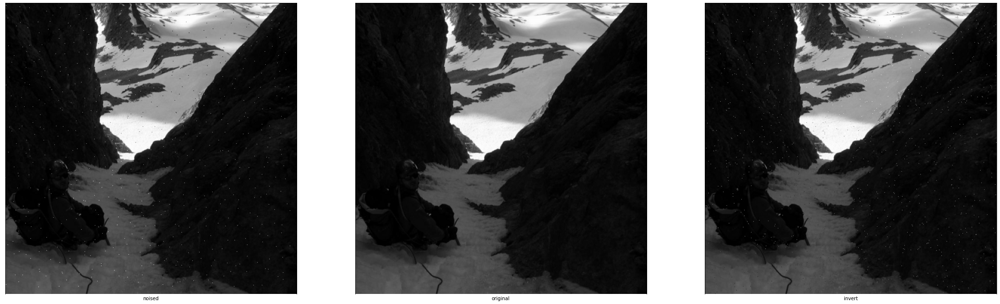

In [ ]:
img = copy.deepcopy(images_data[1])
img_2 = copy.deepcopy(images_data[1])

noiseAllImg_block(img, bit_mask = 128, block_size = (20,20), nb_pix_in_block_to_noise = 1, block_noised_probability=0.01)

noiseImg_withrange(img_2, start = (0,0), end = (len(img_2[0]),len(img_2)), bit_mask = 120,  nb_pix_in_block_to_noise = 1000)

afficher_img([img, images_data[1],img_2],['noised', 'original', 'invert'], color = None)

In [ ]:
k = 3
n = 5
#print( images_data[6][0,:10,:])
ThienLin_shares, dim = encrypt_ShamirThienLin_rdmA(images_data[6], k, n)

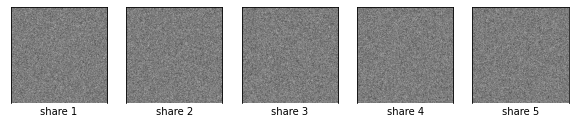

In [ ]:
shnames = ['share ' + str(i) for i in range(1,n+1)]
afficher_img(ThienLin_shares,shnames, color = None, figsize = (10,10), axis=0)

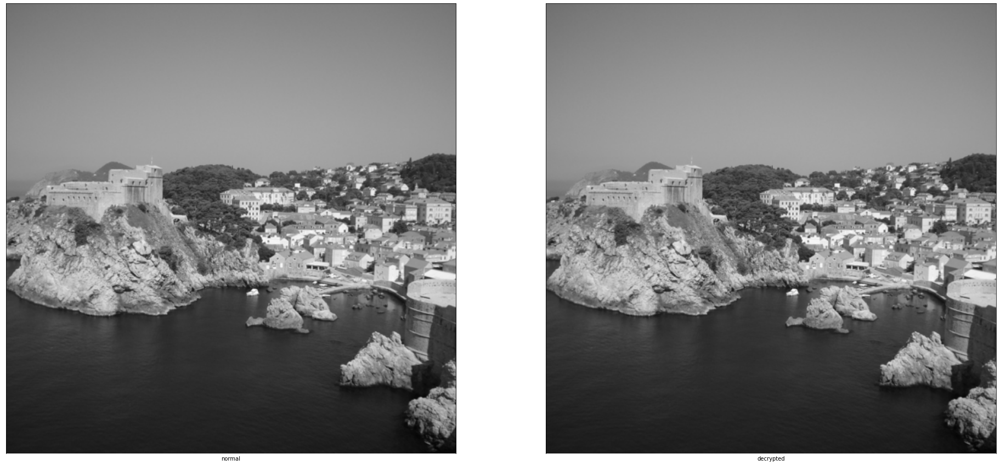

In [ ]:
ThienLin_dec = decrypt_ShamirThienLin(ThienLin_shares, n, k = [1,2,3] ,dimensions = dim)
afficher_img([images_data[6], ThienLin_dec],['normal', 'decrypted'], color = None)

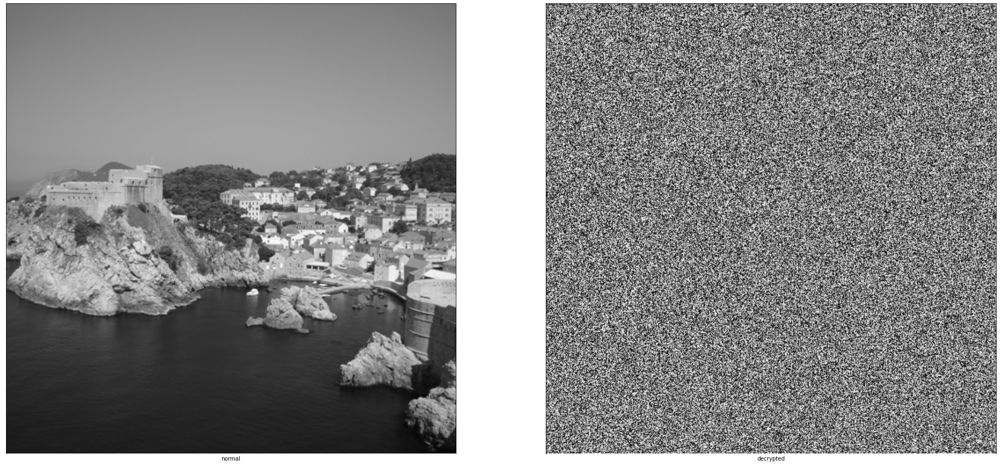

In [ ]:
ThienLin_dec_sub = decrypt_ShamirThienLin(ThienLin_shares, n, k = [1,2] ,dimensions = dim)
afficher_img([images_data[6], ThienLin_dec_sub],['normal', 'decrypted'], color = None)

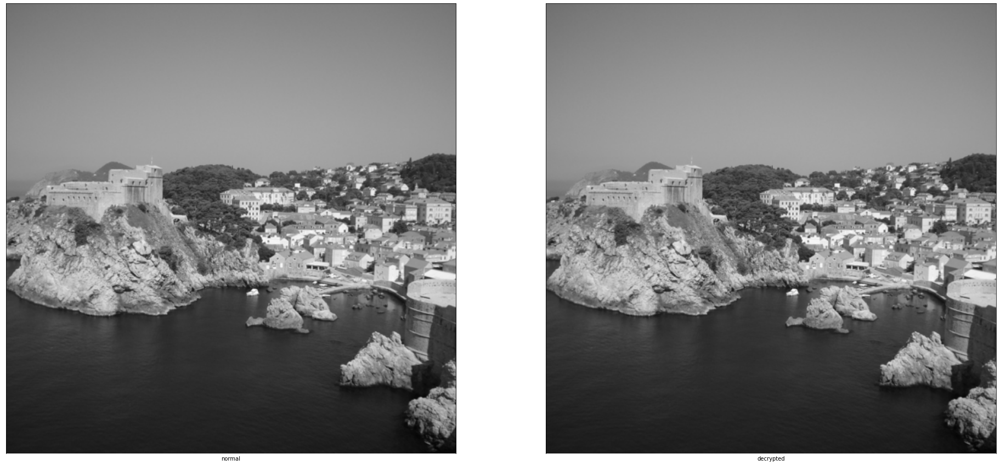

In [ ]:
ThienLin_dec_up = decrypt_ShamirThienLin(ThienLin_shares, n, k = [1,2,3,4] ,dimensions = dim)
afficher_img([images_data[6], ThienLin_dec_up],['normal', 'decrypted'], color = None)

In [ ]:
#shares_GF, dim_GF, shares_GF_v = encrypt_Shamir_GF(images_data[8][:5,:100,:],2,5)
shares_GF,dim_GF = encrypt_Shamir_GF(images_data[8][:,:,:],2,5)

786432
786432


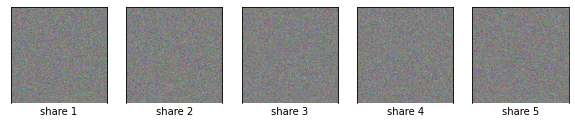

In [ ]:
shnames = ['share ' + str(i) for i in range(1,6)]
GF_visualisation = GF_get_visualisation_datas(shares_GF, dim_GF)

afficher_img(GF_visualisation,shnames, color = None, figsize = (10,10), axis=0)

end
[217 217 217 ...  17  17  17]
786432


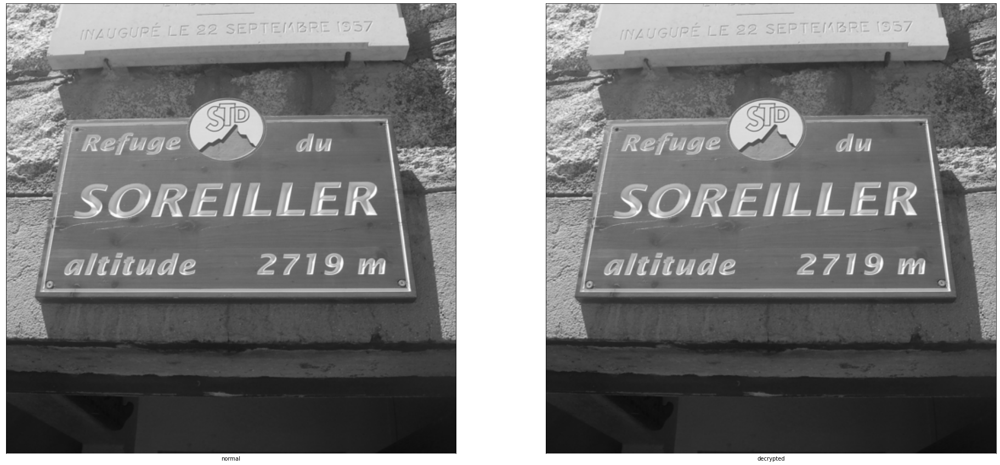

In [ ]:
GF_dec = decrypt_Shamir_GF(
    shares_GF, 
    5,
    k = [1,2],
    dimensions = dim_GF
  )

afficher_img([images_data[8][:,:,:], GF_dec],['normal', 'decrypted'], color = None)

## AES encryption scenarios

In [ ]:
#img_cypher = copy.deepcopy(images_data[2])
#
#nb_row = len(img_cypher)
#nb_lin = len(img_cypher[0])
#nb_pixels_img = nb_lin* nb_row* 3
#
#img = np.reshape(img_cypher, (1,nb_pixels_img))[0]
#imgbyte = bytearray(img)
#
#key = (1024).to_bytes(16, byteorder='big')
#print("Key {} : {}".format(key,int.from_bytes(key, byteorder='big')))
#
## AES encyption
#CBC_cipher = AES.new(key, AES.MODE_ECB)
#CBC_ct_bytes = CBC_cipher.encrypt(pad(imgbyte, AES.block_size))
#
#CBC_array_bytes = bytearray(CBC_ct_bytes)[:nb_pixels_img]
#img_crypted = np.reshape(CBC_array_bytes, (nb_lin, nb_row, 3))
#
#
#CBC_decrypted_img =  bytearray(unpad(CBC_cipher.decrypt(CBC_ct_bytes), AES.block_size))
#img_decrypted = np.reshape(CBC_decrypted_img, (nb_lin, nb_row, 3))
#
#
#afficher_img([img_cypher, img_crypted,img_decrypted],['cypher', 'crypted', 'decrypted'], color = None)
#


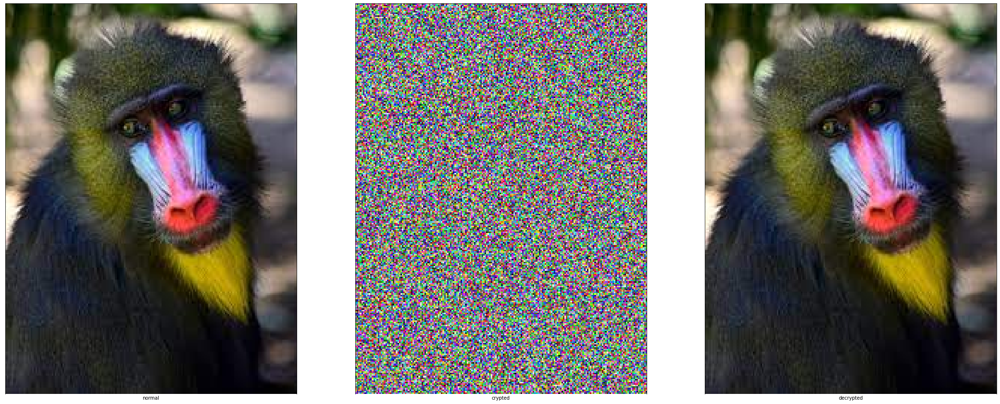

In [ ]:
key = (654654).to_bytes(16, byteorder='big')
key = get_random_bytes(16)

crypted_AES_ECB_ctb, crypted_AES_ECB_img, dim = encrypt_AES_ECB(images_data[0],key)
decrypted_AES_ECB_img = decrypt_AES_ECB(crypted_AES_ECB_ctb,key,dim)
afficher_img([images_data[0], crypted_AES_ECB_img,decrypted_AES_ECB_img],['normal', 'crypted', 'decrypted'], color = None)

#crypted_AES_CBC_ctb, crypted_AES_CBC_img, dim, iv = encrypt_AES_CBC(images_data[5],key)
#decrypted_AES_CBC_img = decrypt_AES_CBC(crypted_AES_CBC_ctb,key,iv,dim)
#afficher_img([images_data[5], crypted_AES_CBC_img,decrypted_AES_CBC_img],['normal', 'crypted', 'decrypted'], color = None)

#crypted_AES_CTR_ctb, crypted_AES_CTR_img, dim, nonce = encrypt_AES_CTR(images_data[10],key)
#decrypted_AES_CTR_img = decrypt_AES_CTR(crypted_AES_CTR_ctb,key,nonce,dim)
#afficher_img([images_data[10], crypted_AES_CTR_img,decrypted_AES_CTR_img],['normal', 'crypted', 'decrypted'], color = None)

#crypted_AES_CFB_ctb, crypted_AES_CFB_img, dim, iv = encrypt_AES_CFB(images_data[8],key)
#decrypted_AES_CFB_img = decrypt_AES_CFB(crypted_AES_CFB_ctb,key,iv,dim)
#afficher_img([images_data[8], crypted_AES_CFB_img,decrypted_AES_CFB_img],['normal', 'crypted', 'decrypted'], color = None)

#crypted_AES_OFB_ctb, crypted_AES_OFB_img, dim, iv = encrypt_AES_OFB(images_data[6],key)
#decrypted_AES_OFB_img = decrypt_AES_OFB(crypted_AES_OFB_ctb,key,iv,dim)
#afficher_img([images_data[6], crypted_AES_OFB_img,decrypted_AES_OFB_img],['normal', 'crypted', 'decrypted'], color = None)

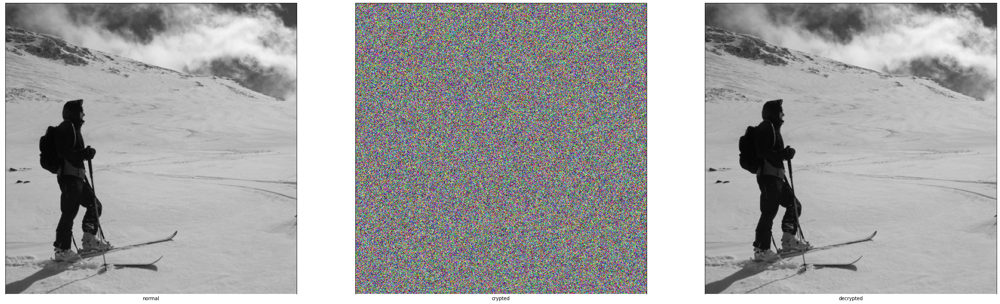

In [ ]:
key = get_random_bytes(16)

#crypted_AES_CCM_ctb, crypted_AES_CCM_img, CCM_nonce, CCM_tag, dim = encrypt_AES_CCM(images_data[0],'img_ccm',key)
#decrypted_AES_CCM_img = decrypt_AES_CCM(crypted_AES_CCM_ctb,key,'img_ccm',CCM_nonce, CCM_tag,dim)
#afficher_img([images_data[0], crypted_AES_CCM_img,decrypted_AES_CCM_img],['normal', 'crypted', 'decrypted'], color = None)

#crypted_AES_EAX_ctb, crypted_AES_EAX_img, EAX_nonce, EAX_tag, dim = encrypt_AES_EAX(images_data[4],'img_eax',key)
#decrypted_AES_EAX_img = decrypt_AES_EAX(crypted_AES_EAX_ctb,key,'img_eax',EAX_nonce, EAX_tag,dim)
#afficher_img([images_data[4], crypted_AES_EAX_img,decrypted_AES_EAX_img],['normal', 'crypted', 'decrypted'], color = None)

#crypted_AES_GCM_ctb, crypted_AES_GCM_img, GCM_nonce, GCM_tag, dim = encrypt_AES_GCM(images_data[4],'img_gcm',key)
#decrypted_AES_GCM_img = decrypt_AES_GCM(crypted_AES_GCM_ctb,key,'img_gcm',GCM_nonce, GCM_tag,dim)
#afficher_img([images_data[4], crypted_AES_GCM_img,decrypted_AES_GCM_img],['normal', 'crypted', 'decrypted'], color = None)

#key_SIV = get_random_bytes(16*2)
#nonce_SIV = get_random_bytes(16)
#crypted_AES_SIV_ctb, crypted_AES_SIV_img, SIV_tag, dim = encrypt_AES_SIV(images_data[9],'img_siv',key_SIV, nonce_SIV)
#decrypted_AES_SIV_img = decrypt_AES_SIV(crypted_AES_SIV_ctb,key_SIV,'img_siv',nonce_SIV, SIV_tag,dim)
#afficher_img([images_data[9], crypted_AES_SIV_img,decrypted_AES_SIV_img],['normal', 'crypted', 'decrypted'], color = None)

crypted_AES_OCB_ctb, crypted_AES_OCB_img,OCB_nonce, OCB_tag, dim = encrypt_AES_OCB(images_data[7],'img_ocb',key)
decrypted_AES_OCB_img = decrypt_AES_OCB(crypted_AES_OCB_ctb,key,'img_ocb',OCB_nonce, OCB_tag,dim)
afficher_img([images_data[7], crypted_AES_OCB_img,decrypted_AES_OCB_img],['normal', 'crypted', 'decrypted'], color = None)

# Scenarios

## Working pipeline (actual pipeline)

In [23]:
MAX_VALUE_PSNR = 20 * math.log(255, 10)
deno_ENTROPY = math.log(2)

def PSNR(imgA, imgB):
  MSE = np.average((imgA - imgB)**2)
  if (MSE == 0):
    return math.inf
  else:
    return MAX_VALUE_PSNR - 10 * math.log(MSE, 10)

def UACI (imgA, imgB):
  ia = np.reshape(imgA, -1)
  ib = np.reshape(imgB, -1)
  val = 0
  for i in range(len(ia)) : 
    val+=abs(ia[i] - ib[i])
  val = val * 100 / (len(ia) * 255)
  return val

def NPCR (imgA, imgB) :
  ia = np.reshape(imgA, -1)
  ib = np.reshape(imgB, -1)
  val = 0

  for i in range(len(ia)) : 
    if(ia[i] != ib[i]) :
      val+=1

  return (val/(len(ia))) * 100

def entropy(image) : 
  somme = 0
  histo = np.zeros(256)

  for i in range(len(image)) : 
    histo[image[i]] +=1
  
  for val in histo :
    if(val != 0) :
      pi = val / len(image)
      somme = somme -  pi * (math.log(pi) / deno_ENTROPY)
  return somme

def entropy_with_separation(image, sep) : 
  somme = 0
  histo = np.zeros(sep)

  for i in range(len(image)) : 
    histo[ math.trunc( image[i] / 256 * sep) ] +=1
  
  for val in histo :
    if(val != 0) :
      pi = val / len(image)
      somme = somme -  pi * (math.log(pi) / deno_ENTROPY)
  return somme

In [24]:
#import threading
class WrongPipelineError(Exception):
    def __init__(self, msg):
        self.msg = msg

class GraphPipelineError(Exception):
    def __init__(self, msg):
        self.msg = msg

class Pipeline() :
  def __init__(self, debug = False):
    self.debug = debug
  
  #check the validity of the pipeline call
  def __check_validity(self,images, operations, params) :
    if(type(images) is not list or type(operations) is not list or type(params) is not list) :
      raise WrongPipelineError("All of the three parameters need to be a list !")
    if(len(operations) != len(params)) :
      if(self.debug) :
        print(operations)
        print(params)
      raise WrongPipelineError("encription_methods list and encription_informations list need to be a list of the exact same size !")


  #internal function to prepare layers connection (precedence connection)
  def __prepare_layers(self, operations, params) :
    layers = []
    for i in range(0, len(operations)) :
       op = operations[i]
       infos = params[i]

       if(infos.get("layer_precedence") != None) :
        layers.append({"operation" : op, "params" : {k:infos[k] for k in infos.keys() if k != "layer_precedence"}, "level" : (infos["layer_precedence"]+1) })
       else :
        layers.append({"operation" : op, "params" : {k:infos[k] for k in infos.keys() if k != "layer_precedence"}, "level" : i })
       
    return layers

  #construct all the graph connection and return all the first nodes
  def __construct_graph_execution(self,layers) :
    root = layers[0]
    root["prec"] = None
    root["suiv"] = []
    
    cur_node_injection = root

    ind_debub = 0

    for i in range(1, len(layers)) :
      ind_debub+=1

      cur_layer = layers[i]
      cur_layer["suiv"] = []

      if(cur_layer["level"]>cur_node_injection["level"]) : 
        #we continue the graph
        #print("dont backtrack ! ")
        cur_layer["prec"] = cur_node_injection
        cur_node_injection["suiv"].append(cur_layer)
        cur_node_injection = cur_layer
      else :
        #we backtrack to get the right node to apply this
        cur_node_injection = cur_node_injection["prec"]
        #print("backtrack ! ")
        #print(cur_node_injection)

        while((cur_node_injection != None) and (cur_node_injection["level"] >= cur_layer["level"])) :
          #print("cur injection level : ", cur_node_injection["level"])
          #print("cur layer level : ", cur_layer["level"])
 
          cur_node_injection = cur_node_injection["prec"]
      
        if(cur_node_injection == None) :
          raise GraphPipelineError("Pipeline creation failed : can't create the execution graph for value : (ind : " + str(ind_debub) + ")")
        
        #we continue the graph
        cur_layer["prec"] = cur_node_injection
        cur_node_injection["suiv"].append(cur_layer)
        cur_node_injection = cur_layer
    return root

  #function called for executing a node 
  def __execute_node(self,img,node, res_images, sup_values) :
    if(node == None) :
      return
    
    if(self.debug) :
      #print("    ================    ")
      print("node execution ! ")
      #print(img)
      print(node)
      #print(res_images)
      print(sup_values)
      print("    ================    ")

    meth = node["operation"]
    p = node["params"]

    try :
    #if(True) :
      res_img, res_infos = meth(img,{**sup_values,**p})

      if(p.get("keep_results") == True) : 
        name = ""
        if( p.get("image_name") != None) :
          name = p["image_name"]
        else :
          if(res_infos.get("image_name") != None) :
            name = res_infos["image_name"]
          else :
            if(sup_values.get("image_name") != None) :
              name = sup_values["image_name"]
      
        #print(name)
        #print(res_img)
        
        if(p.get("original_shape") == True) :
          for i in range(0,len(res_img)) :
            imgs, params = ImageOperation.convertToOriginalDataShape(res_img[i], {**sup_values, **res_infos, **p})
            res_images.append({"data" : imgs[0], "name" : name[i]})

        else:
          for i in range(0,len(res_img)) :
            res_images.append({"data" : res_img[i], "name" : name[i]})
      
      if(p.get("dont_split_data") == True) :
          for s in node["suiv"] :
            self.__execute_node(res_img,s, res_images, {**sup_values, **res_infos})
      else :
        for img_r in  res_img :
          for s in node["suiv"] :
            self.__execute_node(img_r,s, res_images, {**sup_values, **res_infos})
    
    except ValueError as v:
      print(str(v))
    return 
  
  def __print_graph(self,node, depth = 0) :
    if (node == None) : return
    meth = node["operation"]
    p = node["params"]
    

    print("==== level : ", node["level"])
    print("depth : ", depth)
    print(meth)
    print("params : ")
    for k in p.keys() :
      print(" - [", k, end = " ] : ")
      print(p[k])

    print("suivant : ", len(node["suiv"]))
    #self.__print_graph(node.get("prec"))
    for s in node["suiv"] :
      self.__print_graph(s, depth+1)
    
  def __call__(self, images, operations, params) :
    self.__check_validity(images, operations, params)
    layers = self.__prepare_layers(operations, params)

    root = self.__construct_graph_execution(layers)

    if(self.debug) :
      print(" ==== LAYERS ==== ")
      for l in layers :
        print (l)
    #  
    #  print(" ==== GRAPH ==== ")
    #  self.__print_graph(root)

    current_images = images
    res_img = []

    print("START !")

    for img in current_images :
      self.__execute_node(img,root, res_img, {})
    return res_img
        

### Global Pipeline part

In [25]:
from enum import Enum, Flag, auto

class MissingParamsError(Exception):
    def __init__(self, msg):
        self.msg = msg


class ColorRes(Flag):
    color_R = auto()
    color_G = auto()
    color_B = auto()

    color_RGB = color_R | color_G | color_B


class ImageOperation(Enum) :

  def flat_image(image, params) :
    dim = (len(image), len(image[0]), 3)
    nb_values_img = dim[0] * dim[1] * dim[2]
    #return [np.reshape(image, (1,nb_values_img))[0]], {"flat": True, "nb_values_img" :nb_values_img, "dim" : dim}
    return [np.reshape(image, -1)], {"flat": True, "nb_values_img" :nb_values_img, "dim" : dim}

  def bytes_image(image, params) :
    return [bytearray(image)], {"bytearray" : True}

  def convertColor(image, params) :
    if(params.get("mode") == None) :
      raise MissingParamsError("Need to have mode set to apply the conversion to other colormode (str)")
    
    if(params["mode"] == 'toNB') :
      #print("TONB !")
      #print(image.shape)
      #print(np.array(image[:,:, 1]).shape)

      return [ image[:,:, 1] ], {"isRGB" : False}
    
    raise MissingParamsError("Need to have a good mode : toNB")
    
    #if(params["mode"] == 'toRGB') :
    #  return [np.reshape(image[::1], -1)], {"isRGB" : True}
      
  
  def convertToOriginalDataShape(image, params) : 
    #print("<CONVERT>")
    #if(params.get("nb_values_img") == None) : 
    #  raise MissingParamsError("Need to have nb_values_img set to apply the conversion to orignal data shape (int)")
    if(params.get("flag") == None) : 
      raise MissingParamsError("Need to have flag set to apply the conversion to orignal data shape (ColorRes)")
    
    if(params.get("flat") == True) :
      if(params.get("nb_values_img") == None) : 
        raise MissingParamsError("Need to have nb_values_img set to apply the conversion to orignal data shape (int)")
      if(params.get("dim") == None) : 
        raise MissingParamsError("Need to have dim set to apply the conversion to orignal data shape (list 3D)")
      

      if(params.get("bytearray") == True) :
        array_bytes = image[:params["nb_values_img"]]
      else : 
        array_bytes = bytearray(image)[:params["nb_values_img"]]
        
      start_c   = -1 
      end_c     = -1
      ind_j     = 1

      if(ColorRes.color_RGB in params["flag"]) :
        start_c   = 0 
        end_c     = 3
        ind_j     = 1
      else :
        if((ColorRes.color_R in params["flag"]) and (ColorRes.color_G in params["flag"]) ) :
          start_c   = 0 
          end_c     = 2
          ind_j     = 1
        else :
          if((ColorRes.color_R in params["flag"]) and (ColorRes.color_B in params["flag"]) ) :
            start_c   = 0 
            end_c     = 3
            ind_j     = 2
          else :
            if((ColorRes.color_G in params["flag"]) and (ColorRes.color_B in params["flag"]) ) :
              start_c   = 1 
              end_c     = 3
              ind_j     = 1
            else :
              if(ColorRes.color_R in params["flag"]) :
                start_c   = 0 
                end_c     = 1
                ind_j     = 1
              else :
                if(ColorRes.color_G in params["flag"]) :
                  start_c   = 1 
                  end_c     = 2
                  ind_j     = 1
                else :
                  if(ColorRes.color_B in params["flag"]) :
                    start_c   = 2 
                    end_c     = 3
                    ind_j     = 1
      
      return [np.reshape(array_bytes, params["dim"])[:,:,start_c:end_c:ind_j]], {"flat" : False, "bytearray" : True}
    
    print("Warning : convertToOriginalDataShape pass is useless here ! ")
    return [image], {}

### Noising Pipeline part

Autoencoder utils functions 

In [26]:
# ======================================================================================= 
# ======================================= from grayScale blocks values to grayscale image 
# ======================================================================================= 
def blocksToImg(blocks, height, width, pad_v = 1, pad_h = 1):
  image_ctr = np.zeros((height, width, 4), dtype='float32')
  i = 0
  j = 0
  c = 0
  for b in blocks:
    image_ctr[i:i+b.shape[0], j:j+b.shape[1], c] += np.copy(b)
    c += 1
    if c == 3:
      image_ctr[i:i+b.shape[0], j:j+b.shape[1], 3] += 1
      c = 0
      j += pad_h
      if j + b.shape[1] >= width:
        j = 0
        i += pad_v
        if i + b.shape[0] >= height:
          break
  image_ctr[image_ctr[:, :, 3] == 0] = [0, 0, 0, 1]
  image = image_ctr[:, :, :3].astype('float32') / np.repeat(image_ctr[:, :, 3], 3).reshape(height, width, 3)
  image = np.clip(image.astype(int), 0, 255)
  return image

# ======================================================================================= 
# =================================================== from RGB blocks values to RGB image 
# ======================================================================================= 
def blocksToImgRGB(blocks, height, width, pad_v = 1, pad_h = 1):
  image_ctr = np.zeros((height, width, 4), dtype='float32')
  i = 0
  j = 0
  for b in blocks:
    image_ctr[i:i+b.shape[0], j:j+b.shape[1], :3] += np.copy(b)
    image_ctr[i:i+b.shape[0], j:j+b.shape[1], 3]  += 1
    j += pad_h
    if j + b.shape[1] >= width:
      j = 0
      i += pad_v
      if i + b.shape[0] >= height:
        break
  image_ctr[image_ctr[:, :, 3] == 0] = [0, 0, 0, 1]
  image = image_ctr[:, :, :3].astype('float32') / np.repeat(image_ctr[:, :, 3], 3).reshape(height, width, 3)
  image = np.clip(image.astype(int), 0, 255)
  return image

# ======================================================================================= 
# ============================================== from grayscale image to grayscale blocks
# ======================================================================================= 
def imgToBlocks(img_data_original, bl_height = 16, bl_width = 16, pad_v = 1, pad_h = 1):
  img_data = []
  for img in img_data_original:
    irange = img.shape[0] - bl_height
    jrange = img.shape[1] - bl_width
    if irange <= 0 or jrange <= 0:
      continue
    for i in range(0, irange, pad_v):
      for j in range(0, jrange, pad_h):
        for c in range(3):
          img_data.append(np.copy(img[i:i+bl_height, j:j+bl_width, c]).reshape(1, bl_height, bl_width).astype(int))

  return np.array(img_data)

# ======================================================================================= 
# ========================================================== from RGB image to RGB blocks 
# ======================================================================================= 
def imgToBlocksRGB(img_data_original, bl_height = 16, bl_width = 16, pad_v = 1, pad_h = 1):
  img_data = []
  for img in img_data_original:
    irange = img.shape[0] - bl_height
    jrange = img.shape[1] - bl_width
    if irange <= 0 or jrange <= 0:
      continue
    for i in range(0, irange, pad_v):
      for j in range(0, jrange, pad_h):
          img_data.append(np.copy(img[i:i+bl_height, j:j+bl_width]).reshape(1, bl_height, bl_width, 3).astype(int))

  return np.array(img_data)

# ======================================================================================= 
# =========================================================== autoencoder utilisation
# ======================================================================================= 
def denoise_autoencoder(image, autoencoder, bl_height = 16, bl_width = 16, pad_v = 1, pad_h = 1):
    image_blocks_base = imgToBlocks([image], bl_height = bl_height, bl_width = bl_width, pad_v = pad_v, pad_h = pad_h)
    image_blocks_base = image_blocks_base.astype('float32') / 255.
    image_blocks_base = np.reshape(image_blocks_base, (len(image_blocks_base), bl_height, bl_width, 1))
    image_blocks_predict = autoencoder.predict(image_blocks_base, verbose=0)
    image_blocks_predict = (image_blocks_predict * 255)
    image_blocks_predict = np.reshape(image_blocks_predict, (-1, bl_height, bl_width)).astype(int)
    image_predict = blocksToImg(image_blocks_predict, image.shape[0], image.shape[1], pad_v = pad_v, pad_h = pad_h).astype(int)
    return image_predict

# ======================================================================================= 
# ========================================================== autoencoder utilisation (RGB) 
# ======================================================================================= 
def denoiseRGB_autoencoder(image, autoencoder, bl_height = 16, bl_width = 16, pad_v = 1, pad_h = 1):
    image_blocks_base = imgToBlocksRGB([image], bl_height = bl_height, bl_width = bl_width, pad_v = pad_v, pad_h = pad_h)
    image_blocks_base = image_blocks_base.astype('float32') / 255.
    image_blocks_base = np.reshape(image_blocks_base, (len(image_blocks_base), bl_height, bl_width, 3))
    image_blocks_predict = autoencoder.predict(image_blocks_base, verbose=0)
    image_blocks_predict = (image_blocks_predict * 255)
    image_blocks_predict = np.reshape(image_blocks_predict, (-1, bl_height, bl_width, 3)).astype(int)
    image_predict = blocksToImgRGB(image_blocks_predict, image.shape[0], image.shape[1], pad_v = pad_v, pad_h = pad_h).astype(int)
    return image_predict


In [27]:
# ======================================================================================= 
# =========================================================== noising class
# =======================================================================================

class Noising(ImageOperation) :

# ================================================= 
# ====================== Noising function
# =================================================
  def with_mask_and_proba(image,params) :
    if(params.get("byte_mask") == None) :
      raise MissingParamsError("Need to have byte_mask set to apply with_mask_and_proba (byte value or binary 8 long list)")
    if(params.get("noise_probability") == None) :
      raise MissingParamsError("Need to have noise_probability set to apply with_mask_and_proba (float value between 0 and 1)")
    if(params.get("noise_block_size") == None) :
      raise MissingParamsError("Need to have block_size set to apply with_mask_and_proba (int)")
    #if(params.get("with_last_block") == None) :
    #  raise MissingParamsError("Need to have with_last_block set to apply with_mask_and_proba (boolean)")
    
    #print("noising ! ")
    bit_mask = params["byte_mask"]
    noise_probability = params["noise_probability"]
    block_size = params["noise_block_size"]
    with_last_block = (params.get("with_last_block") == True)


    if(params.get("bytearray") != True) : img_res = bytearray(image)
    else : img_res = image

    mask_val = 0
    if(type(bit_mask) is tuple) :
      #print("IS TUPLE ! ")
      #print(bit_mask)

      bit_mask = tuple(reversed(bit_mask))
      #print(bit_mask)
      for i in range(0,8) :
        mask_val += (bit_mask[i] << i)
    else :
      if(type(bit_mask) is bytes) :
        mask_val = bit_mask
      else:
        raise Exception("Sorry, only 8 long tuples or int are accepted as bit_mask val")
    
    #print("BRUITER : ", mask_val)

    nb_b = ( len(img_res)//block_size )

    if(with_last_block == False) :
      #print("not with last block ! ")
      nb_b -=2 

    probability_map_tmp = np.random.rand(nb_b)
    probability_map = np.zeros(nb_b).astype(int)
    probability_map[probability_map_tmp<noise_probability] = random.randint(0,16)
    probability_map[probability_map_tmp>=noise_probability] = -1

    for i in range(0,nb_b) :
      if(probability_map[i]>(-1)):
        ind = probability_map[i] + (i * block_size)
        img_res[ind] = img_res[ind] ^ mask_val

    
    if(params.get("save_as_param") == True) :  
      return [img_res], {"bytearray" : True, "noised_image" : img_res, "byte_mask" : params["byte_mask"], "noise_block_size" : params["noise_block_size"], "noise_probability" : params["noise_probability"], "noise_mask_val" : mask_val}
    else : 
      return [img_res], {"bytearray" : True}
  

  # ================================================= 
  # =============== Noising function for shamir parts
  # =================================================
  def noising_for_shamirpart(image,params) :
    if(params.get("byte_mask") == None) :
      raise MissingParamsError("Need to have byte_mask set to apply noising_for_shamirpart (byte value or binary 8 long list)")
    if(params.get("noise_probability_list") == None) :
      raise MissingParamsError("Need to have noise_probability_list set to apply noising_for_shamirpart (float value between 0 and 1)")
    if(params.get("part_to_affect") == None) :
      raise MissingParamsError("Need to have part_to_affect set to apply noising_for_shamirpart (float value between 0 and 1)")
    
    if(len(params["part_to_affect"]) != len(params["noise_probability_list"])) :
      raise MissingParamsError("part_to_affect and noise_probability_list need to be as exact same size for noising_for_shamirpart !")
    

    #print("noising for shamir! ")
    #print(len(image))
    #print(params)

    if(params.get("isRGB") == True) :
      len_shares = image[0].shape[0] * image[0].shape[1] *image[0].shape[2]
    else:
      len_shares = image[0].shape[0] * image[0].shape[1]
      
    bit_mask = params["byte_mask"]
    noise_probability = params["noise_probability_list"]

    
    mask_val = 0
    if(type(bit_mask) is tuple) :
      #print("IS TUPLE ! ")
      #print(bit_mask)

      bit_mask = tuple(reversed(bit_mask))
      #print(bit_mask)
      for i in range(0,8) :
        mask_val += (bit_mask[i] << i)
    else :
      if(type(bit_mask) is bytes) :
        mask_val = bit_mask
      else:
        raise Exception("Sorry, only 8 long tuples or int are accepted as bit_mask val")
    
    #print("BRUITER : ", mask_val)

    img_res = []
    
    noise_map       = []
    noise_map_names = []

    img_name_res = []

    tab = [k for k in range(0,len_shares)]
    #print("tab pos")
    #print(tab)

    index = 0
    for i in range(len(image)) :
      pre_res = np.reshape(image[i], -1)
      noise_map_names.append("noise map of " + str(i))
      pre_map = np.zeros(len_shares).astype(int)

      if(i in params["part_to_affect"]) :
        img_name_res.append('ShareNoised[' + str(i) + ']')
        sampled_pos = random.sample(tab, min(len_shares , math.trunc(params["noise_probability_list"][index] * len_shares)))
        index+=1

        for el in sampled_pos  : 
          pre_map[el] = 255

          pre_res[el] = pre_res[el] ^ mask_val
      else:
        img_name_res.append('ShareNotNoised[' + str(i) + ']')

      img_res.append(np.reshape(pre_res,image[i].shape))
      noise_map.append(np.reshape(pre_map,image[i].shape))


    #print("images of noise maps !")
    #print(mask_val)

    afficher_img( noise_map , noise_map_names,axis = 0, color = 'gray')
    #"image_name" : ['Share[' + str(i) + ']' for i in range(0,params["n"])]
    if(params.get("save_as_param") != None) :  
      return img_res, {"bytearray" : True, "part_to_affect" :  params["part_to_affect"] ,"noised_image" : img_res, "byte_mask" : params["byte_mask"], "noise_probability_list" : params["noise_probability_list"], "noise_mask_val" : mask_val, "image_name" : img_name_res}
    else : 
      return img_res, {"bytearray" : True, "image_name" : img_name_res}


  # ================================================= 
  # ================ Denoising with opmencv function
  # =================================================
  def denoisingOpenCV(image, params) : 
    if(params.get("templateWindowSize") == None) :
      raise MissingParamsError("Need to have templateWindowSize set to apply denoisingOpenCV ( Size in pixels of the template patch that is used to compute weights. Should be odd. Recommended value 7 pixels )")
    if(params.get("searchWindowSize") == None) :
      raise MissingParamsError("Need to have searchWindowSize set to apply denoisingOpenCV ( Size in pixels of the window that is used to compute weighted average for given pixel. Should be odd. Affect performance linearly: greater searchWindowsSize - greater denoising time. Recommended value 21 pixels )")
    if(params.get("h") == None) :
      raise MissingParamsError("Need to have h set to apply denoisingOpenCV ( Parameter regulating filter strength for luminance component. Bigger h value perfectly removes noise but also removes image details, smaller h value preserves details but also preserves some noise )")
    if(params.get("hColor") == None) :
      raise MissingParamsError("Need to have hColor set to apply denoisingOpenCV ( The same as h but for color components. For most images value equals 10 will be enough to remove colored noise and do not distort colors )")
    
    #afficher_img([image],['test'],axis = -1, color = None)
    return [cv2.fastNlMeansDenoisingColored(np.array(image, dtype="uint8"), None, params["h"], params["hColor"], params["templateWindowSize"], params["searchWindowSize"])], {"image_name" : ['denoised[OpenCV]']}


  # ================================================= 
  # ================ Denoising with entropy
  # =================================================
  def denoising_entopy(image, params) : 
      if(params.get("ciphering_block_size") == None) :
          raise MissingParamsError("Need to have ciphering_block_size set to apply denoising_entopy (16, 24 or 32)")
      if(params.get("min_entopy_tolerate") == None) :
        raise MissingParamsError("Need to have min_entopy_tolerate set to apply denoising_entopy (int)")
      if(params.get("max_entopy_tolerate") == None) :
        raise MissingParamsError("Need to have max_entopy_tolerate set to apply denoising_entopy (int)")
      
      if(params.get("separation") == None) :
        raise MissingParamsError("Need to have separation set to apply denoising_entopy (int)")
      if(params.get("min_dif") == None) :
        raise MissingParamsError("Need to have min_dif set to apply denoising_entopy (int)")
      
      if(params.get("min_dif_tolerate") == None) :
        raise MissingParamsError("Need to have min_dif_tolerate set to apply denoising_entopy (int)")
      
      if(params.get("noise_probability") == None) :
        raise MissingParamsError("Need to have noise_probability set to apply denoising_entopy (float value between 0 and 1)")
      if(params.get("noised_image") == None) : 
        raise MissingParamsError("Need to have noised_image set to prerform denoising_entopy (need to save_as_param : True on a noising step)")
      if(params.get("byte_mask") == None) :
        raise MissingParamsError("Need to have byte_mask set to apply denoising_entopy (byte value or binary 8 long list)")
      if(params.get("noise_block_size") == None) :
        raise MissingParamsError("Need to have block_size set to apply denoising_entopy (int)")
      if(params.get("noise_mask_val") == None) :
        raise MissingParamsError("Need to have noise_mask_val set to apply denoising_entopy (int)")

      image_noised = np.reshape(params["noised_image"], -1)
      flat_img = np.reshape(image, -1)
      b_size = params["ciphering_block_size"]

      image_copy = np.array(flat_img)

      #block construction
      if(params.get("isRGB") == True) :
        #print("IS RGB ! ")
        nb_el_pix = 3
        #pixels_to_see_b = (b_size//3) + 1
        pixels_to_see_b = b_size // 2
      
      else :
        #print("IS NB ! ")
        nb_el_pix = 1
        pixels_to_see_b = b_size


      nb_el_pix = 1
      pixels_to_see_b = b_size

      b_size_pixel = pixels_to_see_b * nb_el_pix

      nb_pixels_image = len(flat_img)//nb_el_pix 

      possible_block_to_correct = []
      
      index_pixel = 0

      max_ent = 0

      #separation = 5

      max_dif_to_see = 0
      cdifmax = 0

      while index_pixel < (len(flat_img)-(nb_el_pix - 1)) :
        ent = 0

        row = index_pixel // params["dim"][1]
        ind = index_pixel%params["dim"][1]
        new_ind_low = (row - 1) * params["dim"][1] + ind
        new_ind_hig = (row + 1) * params["dim"][1] + ind
        
        deno      = 0
        
        dif_to_see = 0
        c_dif = 0
        for rest in range(0,nb_el_pix) :
          ent_vois   = 0
          deno_vois = 0

          t_cur = np.array( flat_img [ index_pixel + rest   : min( index_pixel  + b_size_pixel, len(flat_img)) : nb_el_pix])
          val   = entropy_with_separation(t_cur , params["separation"])
          ent   +=val
          deno  += 1

          t_h = []
          if(new_ind_low >= 0) :
            t_h = np.array( flat_img [ (new_ind_low + rest) : min( new_ind_low  + b_size_pixel, len(flat_img)) : nb_el_pix])
            ent_vois += entropy_with_separation( t_h,params["separation"] )
            deno_vois += 1
          
          t_l = np.array(flat_img [ (new_ind_hig + rest) : min( new_ind_hig + b_size_pixel, len(flat_img)) : nb_el_pix] )
          ent_vois += entropy_with_separation( t_l,params["separation"] )
          if(len(t_l) > 0) :
            if(len(t_h) > 0) : 

              for ind_v in range(min(len(t_h), len(t_l)) ) : 
                t_h[ind_v] = (t_h[ind_v] + t_l[ind_v]) /2
            
            else :
              t_h = t_l
            deno_vois += 1
          

          #print(t_cur)
          #print(t_h)
          for ind_v in range(min(len(t_h), len(t_cur)) ) : 
            t_h[ind_v] = abs(t_h[ind_v] - t_cur[ind_v])
          
          c_dif += np.sum(t_h)
          dif_to_see += abs(val - (ent_vois/deno_vois) )
        #ent = (ent / nb_el_pix) * (b_size_pixel * nb_el_pix  / size)
        ent = (ent / (deno))
        dif_to_see = (dif_to_see /deno_vois )

        c_dif =  c_dif / deno
        
        max_dif_to_see = dif_to_see if(dif_to_see > max_dif_to_see) else max_dif_to_see
        cdifmax = c_dif if(c_dif > cdifmax) else cdifmax
        max_ent = ent if(max_ent<ent) else max_ent

        if((ent > params["min_entopy_tolerate"] )) :
          #if((params["min_dif"] < dif_to_see)) :
          #  for j in range(index_pixel*3, min(index_pixel*3  + b_size_pixel, len(flat_img)) ) :
          #    image_copy[j] = 255

          if((params["min_dif_tolerate"] < c_dif ) and (params["min_dif"] < dif_to_see)) :
            #for j in range(index_pixel*3, min(index_pixel*3  + b_size_pixel, len(flat_img)) ) :
            #  image_copy[j] = 255
            possible_block_to_correct.append( {"val" : ent, "block" : index_pixel})
          
        index_pixel+=nb_el_pix

      
      #print(" max ent : ", max_ent)
      #print(" max cdif : ", cdifmax)
      #print(" max DIF : ", max_dif_to_see)

      #print("possible block to correct : ", len(possible_block_to_correct))
      #print(" ==> IMAGE ENTROPY DENOISING !")

      #block filtration
      block_filtration = []
      if(len(possible_block_to_correct) > 0 ) :
        block_filtration.append( { "val" : possible_block_to_correct[0]["val"], "block" : possible_block_to_correct[0]["block"], "nb_element" : 1,"cur_index" : possible_block_to_correct[0]["block"] } )

        for i in range(1,len(possible_block_to_correct)) : 
          cur_block = possible_block_to_correct[i]
          last_possible_bloc = block_filtration[ len(block_filtration) -1 ]

          if( (last_possible_bloc["cur_index"]+ nb_el_pix ) == cur_block["block"]) :
            last_possible_bloc["nb_element"] += 1
            last_possible_bloc["cur_index"] = cur_block["block"]
            if(last_possible_bloc["val"] < cur_block["val"]) :
              last_possible_bloc["val"]   = cur_block["val"]
              last_possible_bloc["block"] = cur_block["block"]
          else :
            block_filtration.append( { "val" : cur_block["val"], "block" : cur_block["block"], "nb_element" : 1,"cur_index" : cur_block["block"] } )

      #print(" ==> BLOCK FILTRATION ! ")
      #print("block filtration : ", len(block_filtration))

      #for i in block_filtration :
      #  print(i)


      block_corrected = []
      if(params.get("forCFB") == True) :

        #print(" ==> BLOCK TO CORRECT CFB ! ")
        
        for i in block_filtration :
        #for el in range(0,3) :
          #i = block_filtration[el]
          
          #print(" > ELEMENT : ", el)
          #print(i)
          
          for j in range(i["block"], min( i["block"] + b_size + 1 ,len(flat_img))) :
            image_copy[j] = 255
          
          #for j in range(i["block"], i["block"] + i["nb_element"] * nb_el_pix) :
          #  image_copy[j] = 255
        
          b     = i["block"]
          d_2   = i["nb_element"] // 2
          r_d_2 = i["nb_element"] - d_2

          min_b   = (b - (d_2 * nb_el_pix) )
          dep_val = max(0,min_b)
          ecart   = dep_val - min_b
          end_val = min( b +  (r_d_2 + 1)* nb_el_pix + ecart ,  len(flat_img) )
          
          #print("dep val : ", dep_val)
          #print("end_val : ", end_val)
          #print("ecart   : ", ecart)
          #print("size    : ", end_val - dep_val)

          element_to_add = {
              "block" : 0, 
              "val" :  pixels_to_see_b
          }
          
          for pix in range(nb_el_pix) :
          #print("   => for the pixel : ", pix)

            for j in range( dep_val , end_val, nb_el_pix) :
              #print(" > j : ", j)
              min_val   = j - b_size_pixel - nb_el_pix
              deb_tab   = max(0, min_val)
              ecart_tab =  deb_tab - min_val
              max_val   = j + b_size_pixel + nb_el_pix + ecart_tab

              #print(" > min_val   : ", min_val)
              #print(" > max_val   : ", max_val)
              #print(" > ecart_tab : ", ecart_tab)

              tab                 = np.copy( image_noised [deb_tab : min( len(flat_img), max_val ) ] )
              #print(tab)

              el_to_impact_on_tab = b_size_pixel + nb_el_pix - ecart_tab + pix 
              #print(" > impact on tab : ", el_to_impact_on_tab)
              #print( " element : ", tab[ el_to_impact_on_tab ])

              tab[ el_to_impact_on_tab ]  = tab[ el_to_impact_on_tab ] ^ params["noise_mask_val"]

              block_res, el               = params["cipher_algo"](bytearray(tab), {**params, **{"encrypt" : False}}) 

              #print(" > res block : ")
              #print(np.array(bytearray(block_res[0])).astype(bytes))
              #print("R compo")
              #print(np.array(bytearray(block_res[0] [ el_to_impact_on_tab : min( (el_to_impact_on_tab + b_size_pixel + nb_el_pix), len(block_res[0])) : nb_el_pix])).astype(int))

              

              t_cur = np.array( np.array(bytearray( block_res[0] [ el_to_impact_on_tab + rest : min( (el_to_impact_on_tab + b_size + 1), len(block_res[0]) ) : nb_el_pix]) ) )
              ent   = entropy_with_separation(t_cur , 15)
              #ent   = entropy(t_cur)

              if(ent < element_to_add["val"]) :
                element_to_add["val"] = ent
                element_to_add["block"] = j + pix
          
          block_corrected.append(element_to_add)
          #print(element_to_add)
          #print(" ================================= ")
          
      #print("block corrected : ", len(block_corrected))



      #for i in range(len(block_corrected)) :
      #  print("===================")
      #  print(block_filtration[i])
      #  print(block_corrected[i])



      #print(" ==> POSSIBLE BLOCK CORRECTED ! ")
      for ind in range(len(block_corrected )) :
        if( (block_corrected[ind]["val"] < params["max_entopy_tolerate"]) and (block_corrected[ind]["val"] < block_filtration[ind]["val"]) ) :
          
          #for j in range(block_corrected[ind]["block"] , min( block_corrected[ind]["block"] + b_size + 1 ,len(flat_img))) :
          #  image_copy[j] = 0
          image_noised[block_corrected[ind]["block"]] = image_noised[block_corrected[ind]["block"]] ^ params["noise_mask_val"]

      img_res_bis, el = params["cipher_algo"](bytearray(image_noised), {**params, **{"encrypt" : False}})
      i, el = ImageOperation.convertToOriginalDataShape(img_res_bis[0], {**params, **{"flat" : True, "bytearray" : False}})

      #np.reshape( [[gray_image_flat[i],gray_image_flat[i],gray_image_flat[i]] for i in range(len(gray_image_flat))]
      if(params.get("debug") == True) :
          return [ np.reshape(image_copy, params["dim"]), i[0]], {"image_name" : ['blocks finded','denoised[Autoencoder_selection_block]'], "flat" : False}
          #afficher_img([image_autoencoder, cv2.fastNlMeansDenoisingColored(np.array(image, dtype="uint8"), None, 20, 30, 30, 10), np.reshape(image_copy, params["dim"]), np.reshape(image, params["dim"])],['autoencoder', 'openCV', 'possible_bad_blocks', 'img original'],axis = -1, color = None)
      return [i[0]], {"image_name" : ['denoised[Autoencoder_selection_block]'], "flat" : False}


  # ================================================= 
  # ================ Denoising auto-encodeur
  # =================================================
  def denoising_Autoencoder(image, params) :
    if(params.get("autoencoder") == None) :
      raise MissingParamsError("Need to have autoencoder set to apply denoising_Autoencoder (can get with keras.models.load_model)")
    if(params.get("block_height") == None) :
      raise MissingParamsError("Need to have bloc_height set to apply denoising_Autoencoder (int)")
    if(params.get("block_width") == None) :
      raise MissingParamsError("Need to have block_width set to apply denoising_Autoencoder (int)")
    if(params.get("vertical_padding") == None) :
      raise MissingParamsError("Need to have vertical_padding set to apply denoising_Autoencoder (int)")
    if(params.get("horizontal_padding") == None) :
      raise MissingParamsError("Need to have horizontal_padding set to apply denoising_Autoencoder (int)")

    #print("DENOISING autoencoders")
    #if(params.get("bytearray") != True) :
    if(params.get("isRGB") == True) :
      return [denoiseRGB_autoencoder(image, params["autoencoder"], bl_height = params["block_height"], bl_width = params["block_width"], pad_v = params["vertical_padding"], pad_h = params["horizontal_padding"])], {"image_name" : ['denoised(Autoencoders)'], "flat" : False, "bytearray" : False }
    else : 
      return [denoise_autoencoder(image, params["autoencoder"], bl_height = params["block_height"], bl_width = params["block_width"], pad_v = params["vertical_padding"], pad_h = params["horizontal_padding"]) ], {"image_name" : ['denoised(Autoencoders)'], "flat" : False, "bytearray" : False }
    

  # ================================================= 
  # ================ Denoising auto-encodeur block
  # =================================================
  def denoising_Autoencoder_selection_block(image, params) :
    if(params.get("autoencoder") == None) :
      raise MissingParamsError("Need to have autoencoder set to apply denoising_Autoencoder_selection_block (can get with keras.models.load_model)")
    if(params.get("block_height") == None) :
      raise MissingParamsError("Need to have bloc_height set to apply denoising_Autoencoder_selection_block (int)")
    if(params.get("block_width") == None) :
      raise MissingParamsError("Need to have block_width set to apply denoising_Autoencoder_selection_block (int)")
    if(params.get("vertical_padding") == None) :
      raise MissingParamsError("Need to have vertical_padding set to apply denoising_Autoencoder_selection_block (int)")
    if(params.get("horizontal_padding") == None) :
      raise MissingParamsError("Need to have horizontal_padding set to apply denoising_Autoencoder_selection_block (int)")
    if(params.get("difference_tolerate") == None) :
      raise MissingParamsError("Need to have difference_tolerate set to apply denoising_Autoencoder_selection_block (int)")
    if(params.get("second_difference_tolerate") == None) :
      raise MissingParamsError("Need to have second_difference_tolerate set to apply denoising_Autoencoder_selection_block (int)")

    if(params.get("noise_probability") == None) :
      raise MissingParamsError("Need to have noise_probability set to apply denoising_Autoencoder_selection_block (float value between 0 and 1)")
    if(params.get("noised_image") == None) :
      raise MissingParamsError("Need to have noised_image set to prerform denoising_Autoencoder_selection_block (need to save_as_param : True on a noising step)")
    if(params.get("byte_mask") == None) :
      raise MissingParamsError("Need to have byte_mask set to apply denoising_Autoencoder_selection_block (byte value or binary 8 long list)")
    if(params.get("noise_block_size") == None) :
      raise MissingParamsError("Need to have block_size set to apply denoising_Autoencoder_selection_block (int)")
    if(params.get("noise_mask_val") == None) :
      raise MissingParamsError("Need to have noise_mask_val set to apply denoising_Autoencoder_selection_block (int)")
    if(params.get("cipher_algo") == None) :
      raise MissingParamsError("Need to have cipher_algo set to apply denoising_Autoencoder_selection_block (noising_fnc)")


    if(params.get("isRGB") == True) :
      #print("RGB")
      image_autoencoder = denoiseRGB_autoencoder(image, params["autoencoder"], bl_height = params["block_height"], bl_width = params["block_width"], pad_v = params["vertical_padding"], pad_h = params["horizontal_padding"])
      if(params.get("pre_opencv") == True) :
        if(params.get("h") == None) :
          raise MissingParamsError("Need to have h set to apply denoising_Autoencoder_selection_block (for opencv prepro)")
        if(params.get("hColor") == None) :
          raise MissingParamsError("Need to have hColor set to apply denoising_Autoencoder_selection_block (for opencv prepro)")
        if(params.get("templateWindowSize") == None) :
          raise MissingParamsError("Need to have templateWindowSize set to apply denoising_Autoencoder_selection_block (for opencv prepro)")
        if(params.get("searchWindowSize") == None) :
          raise MissingParamsError("Need to have searchWindowSize set to apply denoising_Autoencoder_selection_block (for opencv prepro)")
        
        image_autoencoder = cv2.fastNlMeansDenoisingColored(np.array(image, dtype="uint8"), None, params["h"], params["hColor"], params["templateWindowSize"], params["searchWindowSize"])

    else : 
      #print("NB")
      image_autoencoder = denoise_autoencoder(image, params["autoencoder"], bl_height = params["block_height"], bl_width = params["block_width"], pad_v = params["vertical_padding"], pad_h = params["horizontal_padding"])
      if(params.get("pre_opencv") == True) :
        if(params.get("h") == None) :
          raise MissingParamsError("Need to have h set to apply denoising_Autoencoder_selection_block (for opencv prepro)")
        if(params.get("hColor") == None) :
          raise MissingParamsError("Need to have hColor set to apply denoising_Autoencoder_selection_block (for opencv prepro)")
        if(params.get("templateWindowSize") == None) :
          raise MissingParamsError("Need to have templateWindowSize set to apply denoising_Autoencoder_selection_block (for opencv prepro)")
        if(params.get("searchWindowSize") == None) :
          raise MissingParamsError("Need to have searchWindowSize set to apply denoising_Autoencoder_selection_block (for opencv prepro)")
        
        image_autoencoder = cv2.fastNlMeansDenoising(np.array(image, dtype="uint8"), None, params["h"], params["hColor"], params["templateWindowSize"], params["searchWindowSize"])
      
    if(params.get("pre_blur") == True) : 
      if(params.get("blur_ksize") == None) :
          raise MissingParamsError("Need to have blur_ksize set to apply denoising_Autoencoder_selection_block (for opencv prepro)")
      image_autoencoder = cv2.GaussianBlur(image_autoencoder,params["blur_ksize"],cv2.BORDER_DEFAULT)


    #print("DENOISING auto-encoders block !")
    
    if(params.get("ciphering_block_size") == None) :
      raise MissingParamsError("Need to have ciphering_block_size set to apply denoising_Autoencoder_selection_block (16, 24 or 32)")

    #print("denoise autoencoder block start ! ")
    #for k in params.keys() : 
    #  print(k + " : ", params[k])
    

    image_noised = np.reshape(params["noised_image"], -1)
    flat_img = np.reshape(image, -1)
    image_autoencoder_flat = np.reshape(image_autoencoder, -1)
    
    b_size = params["ciphering_block_size"]
    nb_b = len(flat_img) // b_size
    nb_b -= 2

    possible_bad_block = []
    image_copy = np.array(flat_img)

    #print("WITH BLOCK STRATEGIE") 

    nb_block_before = 0
    nb_block_after  = 1

    block_to_watch  = 0
    block_to_modify = 0


      #if(params.get("forECB") == True) :

    if(params.get("forCBC") == True) :
        #print("CBC")
        nb_block_before = 1
        nb_block_after  = 1
        block_to_watch  = 1
        block_to_modify = 1


    if(params.get("forCFB") == True) :
        #print("CFB")
        nb_block_before = 2 
        nb_block_after  = 2
        block_to_watch  = 1
        block_to_modify = 1
    
    #print(" ==> nb block before : ", nb_block_before)
    #print(" ==> nb block after : ", nb_block_after)
    #print(" ==> block to watch : ", block_to_watch)
    #print(" ==> block to modify : ", block_to_modify)

    for i in range(nb_block_before,nb_b) : 
        val = 0
        for j in range(b_size) :
          val += abs(flat_img[i*b_size + j] - image_autoencoder_flat[i*b_size + j])
      
        if(val > params["difference_tolerate"]) :
          possible_bad_block.append({"block" : i, "block_val" : [ 
            *image_noised [((i - nb_block_before) * b_size) : ((i+nb_block_after) * b_size) ], 
            *image_noised [ (len(image_noised) - (b_size*2)) : (len(image_noised))]  
          ] if (params.get("forCFB") != True) else np.array(image_noised[((i - nb_block_before) * b_size) : ((i+nb_block_after) * b_size) ]) ,
          "val" : val
          })
      
    possible_bad_pix = []
    for block in possible_bad_block :
        #print(" ===== BLOCK_VAL ===== ")
        #for ind in range(nb_block_before + nb_block_after) :
        #  print(block["block_val"][ind * b_size: (ind+1) * b_size])

        block["block_val"][block_to_modify * b_size]  =  block["block_val"][block_to_modify * b_size] ^ params["noise_mask_val"]
        block_res , el = params["cipher_algo"](bytearray(block["block_val"]), {**params, **{"encrypt" : False}})

        #print(" ===== BLOCKDECRRYPT_VAL ===== ")
        #for ind in range(nb_block_before + nb_block_after) :
        #  print(np.array(bytearray(block_res[0])).astype(int)[ind * b_size: (ind+1) * b_size])
        
        
        val = 0
        for i in range(b_size) : 
          image_copy[ block["block"] * b_size + i ] = 255
          val += abs( block_res[0][block_to_watch * b_size + i] - image_autoencoder_flat[block["block"]*b_size + i]) 
      
        element_to_add = {"val" : val, "id" : 0}
        #print("on start avec la valeur : ", val)

        for i in range(1, b_size) :
          #print(" ===== BLOCK_VAL ===== ")
          #for ind in range(nb_block_before + nb_block_after) :
          #  print(block["block_val"][ind * b_size: (ind+1) * b_size])

          block["block_val"][block_to_modify * b_size + i-1] = block["block_val"][block_to_modify * b_size + i-1] ^ params["noise_mask_val"]
          block["block_val"][block_to_modify * b_size + i]   = block["block_val"][block_to_modify * b_size + i]   ^ params["noise_mask_val"]

          block_res, el = params["cipher_algo"](bytearray(block["block_val"]), {**params, **{"encrypt" : False}})
          
          #print(" ===== BLOCKDECRRYPT_VAL ===== ")
          #for ind in range(nb_block_before + nb_block_after) :
          #  print(np.array(bytearray(block_res[0])).astype(int)[ind * b_size: (ind+1) * b_size])

          val = 0
          for j in range(b_size) : 
            val += abs( block_res[0][block_to_watch * b_size + j] - image_autoencoder_flat[block["block"] * b_size + j ]) 

          if(element_to_add["val"] > val) :
          #  print(val) 
            element_to_add["id"]  = i
            element_to_add["val"] = val
          #else : 
          #  print("on ne prend pas : ", end = "")
          #  print(val)

        #print(element_to_add)
        possible_bad_pix.append(element_to_add)

      #print(possible_bad_block)
      #print(possible_bad_pix)
      #print("Elements : ")
    #for i in range(len(possible_bad_pix)) : 
    #    print(" ==> valeur enregistrée : ", end = " = ")
    #    print(possible_bad_block[i]["val"])
    #    print("TAILLE DE L'entrée : ", len(possible_bad_block[i]["block_val"]))
    #    print("valeur optimisée : ", end = " = ")
    #    print(possible_bad_pix[i])

    for ind in range(len(possible_bad_block)) :
        if( (possible_bad_pix[ind]["val"] < params["second_difference_tolerate"]) and (possible_bad_pix[ind]["val"] < possible_bad_block[ind]["val"]) ) :
          image_noised[ ( possible_bad_block[ind]["block"] + block_to_modify - nb_block_before ) * b_size + possible_bad_pix[ind]["id"]] = image_noised[(possible_bad_block[ind]["block"] + block_to_modify - nb_block_before)*b_size + possible_bad_pix[ind]["id"] ] ^ params["noise_mask_val"]
          #image_noised[ ( possible_bad_block[ind]["block"]) * b_size + possible_bad_pix[ind]["id"]] = image_noised[(possible_bad_block[ind]["block"])*b_size + possible_bad_pix[ind]["id"] ] ^ params["noise_mask_val"]
        #else :
        #  print("CANT BE BETTER : ", possible_bad_block[ind]["val"])
        #  print(possible_bad_pix[ind]["val"])

    img_res_bis, el = params["cipher_algo"](bytearray(image_noised), {**params, **{"encrypt" : False}})
    i, el = ImageOperation.convertToOriginalDataShape(img_res_bis[0], {**params, **{"flat" : True, "bytearray" : False}})

    if(params.get("debug") == True) :
        return [image_autoencoder, np.reshape(image_copy, params["dim"]),i[0]], {"image_name" : ['image autoencoder', 'blocks finded','denoised[Autoencoder_selection_block]'], "flat" : False}
        #afficher_img([image_autoencoder, cv2.fastNlMeansDenoisingColored(np.array(image, dtype="uint8"), None, 20, 30, 30, 10), np.reshape(image_copy, params["dim"]), np.reshape(image, params["dim"])],['autoencoder', 'openCV', 'possible_bad_blocks', 'img original'],axis = -1, color = None)
    return [i[0]], {"image_name" : ['denoised[Autoencoder_selection_block]'], "flat" : False}


  # ================================================= 
  # ================ Denoising with slide
  # =================================================
  def denoising_Autoencoder_selection_block_slide(image, params) :
    if(params.get("autoencoder") == None) :
      raise MissingParamsError("Need to have autoencoder set to apply denoising_Autoencoder_selection_block_slide (can get with keras.models.load_model)")
    if(params.get("block_height") == None) :
      raise MissingParamsError("Need to have bloc_height set to apply denoising_Autoencoder_selection_block_slide (int)")
    if(params.get("block_width") == None) :
      raise MissingParamsError("Need to have block_width set to apply denoising_Autoencoder_selection_block_slide (int)")
    if(params.get("vertical_padding") == None) :
      raise MissingParamsError("Need to have vertical_padding set to apply denoising_Autoencoder_selection_block_slide (int)")
    if(params.get("horizontal_padding") == None) :
      raise MissingParamsError("Need to have horizontal_padding set to apply denoising_Autoencoder_selection_block_slide (int)")
    if(params.get("difference_tolerate") == None) :
      raise MissingParamsError("Need to have difference_tolerate set to apply denoising_Autoencoder_selection_block_slide (int)")
    if(params.get("second_difference_tolerate") == None) :
      raise MissingParamsError("Need to have second_difference_tolerate set to apply denoising_Autoencoder_selection_block_slide (int)")
    
    if(params.get("noise_probability") == None) :
      raise MissingParamsError("Need to have noise_probability set to apply denoising_Autoencoder_selection_block_slide (float value between 0 and 1)")
    if(params.get("noised_image") == None) :
      raise MissingParamsError("Need to have noised_image set to prerform denoising_Autoencoder_selection_block_slide (need to save_as_param : True on a noising step)")
    if(params.get("byte_mask") == None) :
      raise MissingParamsError("Need to have byte_mask set to apply denoising_Autoencoder_selection_block_slide (byte value or binary 8 long list)")
    if(params.get("noise_block_size") == None) :
      raise MissingParamsError("Need to have block_size set to apply denoising_Autoencoder_selection_block_slide (int)")
    if(params.get("noise_mask_val") == None) :
      raise MissingParamsError("Need to have noise_mask_val set to apply denoising_Autoencoder_selection_block_slide (int)")
    if(params.get("cipher_algo") == None) :
      raise MissingParamsError("Need to have cipher_algo set to apply denoising_Autoencoder_selection_block_slide (noising_fnc)")
    

    if(params.get("isRGB") == True) :
      #print("RGB")
      image_autoencoder = denoiseRGB_autoencoder(image, params["autoencoder"], bl_height = params["block_height"], bl_width = params["block_width"], pad_v = params["vertical_padding"], pad_h = params["horizontal_padding"])

      if(params.get("pre_opencv") == True) :
        if(params.get("h") == None) :
          raise MissingParamsError("Need to have h set to apply denoising_Autoencoder_selection_block_slide (for opencv prepro)")
        if(params.get("hColor") == None) :
          raise MissingParamsError("Need to have hColor set to apply denoising_Autoencoder_selection_block_slide (for opencv prepro)")
        if(params.get("templateWindowSize") == None) :
          raise MissingParamsError("Need to have templateWindowSize set to apply denoising_Autoencoder_selection_block_slide (for opencv prepro)")
        if(params.get("searchWindowSize") == None) :
          raise MissingParamsError("Need to have searchWindowSize set to apply denoising_Autoencoder_selection_block_slide (for opencv prepro)")
        
        image_autoencoder = cv2.fastNlMeansDenoisingColored(np.array(image, dtype="uint8"), None, params["h"], params["hColor"], params["templateWindowSize"], params["searchWindowSize"])

    else : 
      #print("NB")
      image_autoencoder = denoise_autoencoder(image, params["autoencoder"], bl_height = params["block_height"], bl_width = params["block_width"], pad_v = params["vertical_padding"], pad_h = params["horizontal_padding"])
      if(params.get("pre_opencv") == True) :
        if(params.get("h") == None) :
          raise MissingParamsError("Need to have h set to apply denoising_Autoencoder_selection_block_slide (for opencv prepro)")
        if(params.get("hColor") == None) :
          raise MissingParamsError("Need to have hColor set to apply denoising_Autoencoder_selection_block_slide (for opencv prepro)")
        if(params.get("templateWindowSize") == None) :
          raise MissingParamsError("Need to have templateWindowSize set to apply denoising_Autoencoder_selection_block_slide (for opencv prepro)")
        if(params.get("searchWindowSize") == None) :
          raise MissingParamsError("Need to have searchWindowSize set to apply denoising_Autoencoder_selection_block_slide (for opencv prepro)")
        
        image_autoencoder = cv2.fastNlMeansDenoising(np.array(image, dtype="uint8"), None, params["h"], params["hColor"], params["templateWindowSize"], params["searchWindowSize"])



    if(params.get("pre_blur") == True) : 
      if(params.get("blur_ksize") == None) :
          raise MissingParamsError("Need to have blur_ksize set to apply denoising_Autoencoder_selection_block (for opencv prepro)")
      image_autoencoder = cv2.GaussianBlur(image_autoencoder,params["blur_ksize"],cv2.BORDER_DEFAULT)
    

    if(params.get("ciphering_block_size") == None) :
      raise MissingParamsError("Need to have ciphering_block_size set to apply denoising_Autoencoder_selection_block_slide (16, 24 or 32)")

    #print("start denoising_Autoencoder_selection_block_slide ! ")
    #print(" ========================================================================================== ")
    #for k in params.keys() : 
    #  print(k + " : ", params[k])
    

    image_noised = np.reshape(params["noised_image"], -1)
    flat_img = np.reshape(image, -1)
    image_autoencoder_flat = np.reshape(image_autoencoder, -1)
    b_size = params["ciphering_block_size"]

    possible_bad_block = []
    image_copy = np.array(flat_img)
    

    img_add_windowing = np.zeros(len(flat_img))

    for i in range(len(flat_img)) : 
      for j in range( min(b_size + 1,len(flat_img) - i)) :
        img_add_windowing[i] += abs(flat_img[i + j] - image_autoencoder_flat[i + j])
    
    #print(img_add_windowing)

    for i in range(len(img_add_windowing)) : 
      val = img_add_windowing[i]

      if(val > params["difference_tolerate"]) :
          possible_bad_block.append({"block" : i, "val" : val})
    
    possible_block_to_change = []
    if(len(possible_bad_block) > 0 ) : 
      
      prec_block = possible_bad_block[0]
      possible_block_to_change.append( { "val" : possible_bad_block[0]["val"], "block" : possible_bad_block[0]["block"], "nb_element" : 1,"cur_index" : possible_bad_block[0]["block"] } )

      for i in range(1,len(possible_bad_block)) : 
        cur_block = possible_bad_block[i]
        last_possible_bloc = possible_block_to_change[ len(possible_block_to_change) -1 ]

        if( (last_possible_bloc["cur_index"]+ 1 ) == cur_block["block"]) :
          last_possible_bloc["nb_element"] += 1
          last_possible_bloc["cur_index"] = cur_block["block"]
          if(last_possible_bloc["val"] < cur_block["val"]) :
            last_possible_bloc["val"]   = cur_block["val"]
            last_possible_bloc["block"] = cur_block["block"]
        else :
          possible_block_to_change.append( { "val" : cur_block["val"], "block" : cur_block["block"], "nb_element" : 1,"cur_index" : cur_block["block"] } )


    block_corrected = []

    how_many_elements_before = 1
    
    #print("POSSIBLE BLOCK TO CHANGE ! ")
    for i in possible_block_to_change : 
      #print(i)
      b = i["block"]

      #if(i["nb_element"] < b_size) :
      d_2 = i["nb_element"] // 2
      r_d_2 = i["nb_element"] - d_2
      
      dep_val = max(0,b - d_2)
      #print( (dep_val, min(b + r_d_2+1,len(flat_img))) )
      
      tab = np.copy( image_noised [ max(0,dep_val - b_size - how_many_elements_before)  : min( len(flat_img), (dep_val + b_size + 1) ) ] )
      
      #print(" ------------------ ")
      #print(tab)
      tab[b_size + 1] = tab[b_size + 1] ^ params["noise_mask_val"]
      #print(tab)
      #print(" ------------------ ")

      block_res, el = params["cipher_algo"](bytearray(tab), {**params, **{"encrypt" : False}})

      #print(len(block_res[0]))
      
      val_to_calc = 0
      for j in range(b_size + how_many_elements_before, len(block_res[0])) :
      #for j in range(dep_val , len(block_res[0])) :
      
        val_to_calc += abs( block_res[0][j] - image_autoencoder_flat[dep_val + j +1 ])
      
      element_to_add = {"block" : dep_val, "val" : val_to_calc}
      #print("start with : ", element_to_add)
      #print("with the value of : ", dep_val)
      
      for j in range( dep_val + 1 , min(b + r_d_2 + 1 ,len(flat_img))) :
        
        tab = np.copy(  image_noised[ max(0,j - b_size - how_many_elements_before) : min(len(flat_img), (j + b_size + 1)) ] )
        
        #print(" ------------------ ")
        #print(tab)
        tab[b_size + 1] = tab[b_size + 1] ^ params["noise_mask_val"]
        #print(tab)
        #print(" ------------------ ")
        
        block_res, el = params["cipher_algo"](bytearray(tab), {**params, **{"encrypt" : False}})
        
        #print("size of block res : ", len(block_res[0]))
        #print("for the value of : ", j)


        val_to_calc = 0
        for k in range( b_size + how_many_elements_before , len(block_res[0])) :
        #for k in range( j , len(block_res[0])) :
          val_to_calc += abs( block_res[0][k] - image_autoencoder_flat[j + k +1 ])
        
        if(val_to_calc < element_to_add["val"]) :
          element_to_add["val"] = val_to_calc
          element_to_add["block"] = j
          #print("change for with : ", element_to_add)
        #else :
          #print("dont take : ", val_to_calc)
        
      block_corrected.append(element_to_add)
      #print( image_noised[dep_val : min(len(flat_img), (b + r_d_2 + 1 + b_size)) ] )
    

    #for i in range(len(block_corrected)) :
    #  print(possible_block_to_change[i])
    #  print(block_corrected[i])
    
    #print("POSSIBLE BLOCK CORRECTED ! ")
    for ind in range(len(block_corrected )) :
      #print(i)

      for j in range(block_corrected[ind]["block"] , min( block_corrected[ind]["block"] + b_size + 1 ,len(flat_img))) :
        image_copy[j] = 255
      if( (block_corrected[ind]["val"] < params["second_difference_tolerate"]) and (block_corrected[ind]["val"] < possible_block_to_change[ind]["val"]) ) :
        image_noised[block_corrected[ind]["block"]] = image_noised[block_corrected[ind]["block"]] ^ params["noise_mask_val"]
        
      #else :
      #  print("CANT BE BETTER : ", possible_bad_block[ind]["val"])
      #  print(possible_bad_pix[ind]["val"])

    img_res_bis, el = params["cipher_algo"](bytearray(image_noised), {**params, **{"encrypt" : False}})
    i, el = ImageOperation.convertToOriginalDataShape(img_res_bis[0], {**params, **{"flat" : True, "bytearray" : False}})

    if(params.get("debug") == True) :
        return [image_autoencoder, np.reshape(image_copy, params["dim"]),i[0]], {"image_name" : ['image autoencoder', 'blocks finded','denoised[Autoencoder_selection_block]'], "flat" : False}
        #afficher_img([image_autoencoder, cv2.fastNlMeansDenoisingColored(np.array(image, dtype="uint8"), None, 20, 30, 30, 10), np.reshape(image_copy, params["dim"]), np.reshape(image, params["dim"])],['autoencoder', 'openCV', 'possible_bad_blocks', 'img original'],axis = -1, color = None)
    return [i[0]], {"image_name" : ['denoised[Autoencoder_selection_block]'], "flat" : False}



  # ================================================= 
  # ================ Denoising with selection
  # =================================================
  def denoising_Autoencoder_selection(image, params) :
    if(params.get("autoencoder") == None) :
      raise MissingParamsError("Need to have autoencoder set to apply denoising_Autoencoder_selection (can get with keras.models.load_model)")
    if(params.get("block_height") == None) :
      raise MissingParamsError("Need to have bloc_height set to apply denoising_Autoencoder_selection (int)")
    if(params.get("block_width") == None) :
      raise MissingParamsError("Need to have block_width set to apply denoising_Autoencoder_selection (int)")
    if(params.get("vertical_padding") == None) :
      raise MissingParamsError("Need to have vertical_padding set to apply denoising_Autoencoder_selection (int)")
    if(params.get("horizontal_padding") == None) :
      raise MissingParamsError("Need to have horizontal_padding set to apply denoising_Autoencoder_selection (int)")
    if(params.get("difference_tolerate") == None) :
      raise MissingParamsError("Need to have difference_tolerate set to apply denoising_Autoencoder_selection (int)")
    if(params.get("second_difference_tolerate") == None) :
      raise MissingParamsError("Need to have second_difference_tolerate set to apply denoising_Autoencoder_selection (int)")

    if(params.get("noise_probability") == None) :
      raise MissingParamsError("Need to have noise_probability set to apply denoising_Autoencoder_selection (float value between 0 and 1)")
    if(params.get("noised_image") == None) :
      raise MissingParamsError("Need to have noised_image set to prerform denoising_Autoencoder_selection (need to save_as_param : True on a noising step)")
    if(params.get("byte_mask") == None) :
      raise MissingParamsError("Need to have byte_mask set to apply denoising_Autoencoder_selection (byte value or binary 8 long list)")
    if(params.get("noise_block_size") == None) :
      raise MissingParamsError("Need to have block_size set to apply denoising_Autoencoder_selection (int)")
    if(params.get("noise_mask_val") == None) :
      raise MissingParamsError("Need to have noise_mask_val set to apply denoising_Autoencoder_selection (int)")

    if(params.get("cipher_algo") == None) :
      raise MissingParamsError("Need to have cipher_algo set to apply denoising_Autoencoder_selection (noising_fnc)")

    if(params.get("isRGB") == True) :
      #print("RGB")
      image_autoencoder = denoiseRGB_autoencoder(image, params["autoencoder"], bl_height = params["block_height"], bl_width = params["block_width"], pad_v = params["vertical_padding"], pad_h = params["horizontal_padding"])
      
      if(params.get("pre_opencv") == True) :
        if(params.get("h") == None) :
          raise MissingParamsError("Need to have h set to apply denoising_Autoencoder_selection (for opencv prepro)")
        if(params.get("hColor") == None) :
          raise MissingParamsError("Need to have hColor set to apply denoising_Autoencoder_selection (for opencv prepro)")
        if(params.get("templateWindowSize") == None) :
          raise MissingParamsError("Need to have templateWindowSize set to apply denoising_Autoencoder_selection (for opencv prepro)")
        if(params.get("searchWindowSize") == None) :
          raise MissingParamsError("Need to have searchWindowSize set to apply denoising_Autoencoder_selection (for opencv prepro)")
        
        image_autoencoder = cv2.fastNlMeansDenoisingColored(np.array(image, dtype="uint8"), None, params["h"], params["hColor"], params["templateWindowSize"], params["searchWindowSize"])

    else : 
      #print("NB")
      image_autoencoder = denoise_autoencoder(image, params["autoencoder"], bl_height = params["block_height"], bl_width = params["block_width"], pad_v = params["vertical_padding"], pad_h = params["horizontal_padding"])
      if(params.get("pre_opencv") == True) :
        if(params.get("h") == None) :
          raise MissingParamsError("Need to have h set to apply denoising_Autoencoder_selection (for opencv prepro)")
        if(params.get("hColor") == None) :
          raise MissingParamsError("Need to have hColor set to apply denoising_Autoencoder_selection (for opencv prepro)")
        if(params.get("templateWindowSize") == None) :
          raise MissingParamsError("Need to have templateWindowSize set to apply denoising_Autoencoder_selection (for opencv prepro)")
        if(params.get("searchWindowSize") == None) :
          raise MissingParamsError("Need to have searchWindowSize set to apply denoising_Autoencoder_selection (for opencv prepro)")
        
        image_autoencoder = cv2.fastNlMeansDenoising(np.array(image, dtype="uint8"), None, params["h"], params["hColor"], params["templateWindowSize"], params["searchWindowSize"])

    
    image_possible_pix = np.copy(image)
    
    possible_bad_pixel = []
    for row in range(image_autoencoder.shape[0]) :
      for col in range(image_autoencoder.shape[1]) :
        pixel_difference_score = 0
        for el in range(image_autoencoder.shape[2]) :
          if( params["difference_tolerate"] < abs(image[row][col][el] - image_autoencoder[row][col][el]) ) :
            possible_bad_pixel.append((row, col, el))

            image_possible_pix[row][col][el]        = 255
            image_possible_pix[row][col][(el+1)%3]  = 255
            image_possible_pix[row][col][(el+2)%3]  = 255
  
    image_res = bytearray(params["noised_image"])
    
    #print(possible_bad_pixel)
    #print(params["dim"])

    for pix in possible_bad_pixel :
      image_res[ pix[0] * params["dim"][1]*3 +  pix[1] * 3 + pix[2]] = image_res[ pix[0] * params["dim"][1]*3 +  pix[1] * 3 + pix[2]] ^ params["noise_mask_val"]
    
    #print(params["noise_mask_val"])
    #print(image_res)
    
    img_res_bis, _ = params["cipher_algo"](bytearray(image_res), {**params, **{"encrypt" : False}})
    i, _ = ImageOperation.convertToOriginalDataShape(img_res_bis[0], {**params, **{"flat" : True, "bytearray" : False}})
    
    for pix in possible_bad_pixel :
      if(abs(i[0][pix[0]][pix[1]][pix[2]] - image_autoencoder[pix[0]][pix[1]][pix[2]]) > params["second_difference_tolerate"]) :
        #go back to precedent value
        i[0][pix[0]][pix[1]][pix[2]] = image[pix[0]][pix[1]][pix[2]]

    if(params.get("debug") == True) :
        afficher_img([image_autoencoder, cv2.fastNlMeansDenoisingColored(np.array(image, dtype="uint8"), None, 20, 30, 30, 10), np.reshape(image_possible_pix, params["dim"])],['autoencoder', 'openCV', 'possible_bad_blocks'],axis = -1, color = None)

    return [i[0]], {"image_name" : ['denoised[Autoencoder_selection]'], "flat" : False}


  # ================================================= 
  # ================ Denoising median shamir
  # =================================================
  def denoising_median_filter_shamir(image, params) :
    #print("DENOISING SHAMIR")
    #print(image)
    #print(params)

    if(params.get("shares") == None) :
      raise MissingParamsError("Need to have shares set to apply denoising_median_filter_shamir (tab)")
    if(params.get("w_size") == None) :
      raise MissingParamsError("Need to have w_size set to apply denoising_median_filter_shamir (int)")
    if(params.get("dif_tolerate") == None) :
      raise MissingParamsError("Need to have dif_tolerate set to apply denoising_median_filter_shamir (int)")
    if(params.get("dif_tolerate_after_correction") == None) :
      raise MissingParamsError("Need to have dif_tolerate_after_correction set to apply denoising_median_filter_shamir (int)")
    
    if(params.get("shamir_selection") == None) :
      raise MissingParamsError("Need to have shamir_selection set to apply denoising_median_filter_shamir (tab)")
    if(params.get("noise_mask_val") == None) :
      raise MissingParamsError("Need to have noise_mask_val set to apply denoising_median_filter_shamir (tab)")
    
    #print("mask : ", params["noise_mask_val"])

    ws = params["w_size"] if( (params["w_size"] % 2) == 0) else params["w_size"]//2 
    #print("ws = ", ws)

    element_to_fix = []

    max_dif = 0

    if(params.get("isRGB") != True) :
      image_dif = np.zeros((image.shape[0],image.shape[1])).astype(int)

      img_median    = np.array(image)
      img_decrypted = np.array(image)

      for row in range(ws, (image.shape[0] - ws)) : 
        for col in range(ws, (image.shape[1] - ws)) :
          values = []
          
          for i in range(-ws, ws+1) :
            for j in range(-ws, ws+1) :
              values.append(image[row + i][col+ j])
          
          #s_v = sorted(values)
          val_comp = np.median(values)

          img_median[row][col] = val_comp
          
          dif = abs(val_comp - image[row][col])
          
          max_dif = dif if(dif> max_dif) else max_dif

          if(params["dif_tolerate"] < dif) :
            element_to_fix.append({
                "row" : row,
                "col" : col,
                "dif" : dif,
                "med" : val_comp
            })
      
      #print("MAX DIF : ", max_dif)
      #print("nb elem to fix : ", len(element_to_fix))
      corrected_elem = 0
      for i in element_to_fix :
        #on doit ensuite corriger ces éléments
        
        

        possible_val = []
        
        for elem in params["shamir_selection"] :
          lg_x = []
          lg_y = []
          
          for index_s in params["shamir_selection"] :
            lg_x.append(index_s)

            if(elem == index_s) :
              lg_y.append( params["shares"][index_s-1][i["row"]][i["col"]] ^ params["noise_mask_val"] )
            else :
              lg_y.append( params["shares"][index_s-1][i["row"]][i["col"]])
            #lagrange interpolation
          poly = lagrange(lg_x, lg_y)
          fval = poly.coef[-1] %251
          if(not np.isnan(fval)) :
            possible_val.append(int(fval))

        #print("valeur mediane : ", i["med"])
        #print("valeurs possibleq :  ", possible_val)
        
        best_value = possible_val[0] 
        best_v = abs(possible_val[0] - i["med"])
        for pos_v in range(1,len(possible_val)) :
          d_v = abs(possible_val[pos_v] - i["med"])
          if(d_v<best_v) :
            best_v = d_v 
            best_value = possible_val[pos_v]
        
        if( (best_v < i["dif"]) and (best_v < params["dif_tolerate_after_correction"]) ) :
          image_dif[i["row"]][i["col"]] = i["dif"]
          
          img_decrypted[i["row"]][i["col"]] = best_value
          corrected_elem+=1
      
      #print("corrected_elem : ", corrected_elem)

      afficher_img([ image_dif, img_median ],['dif map', 'median'], color = 'gray')

      if(params.get("with_mediane") == True) :
        return [ img_decrypted , img_median ], { "image_name"  :  [ 'denoised[shamir_med]' , 'denoised[median]' ] }
      else :
        return [ img_decrypted ], { "image_name" : ['denoised[shamir_med]' ] }
      



 # def denoising_Autoencoder_selection_block_old(image, params) :
 #   if(params.get("autoencoder") == None) :
 #     raise MissingParamsError("Need to have autoencoder set to apply denoising_Autoencoder_selection (can get with keras.models.load_model)")
 #   if(params.get("block_height") == None) :
 #     raise MissingParamsError("Need to have bloc_height set to apply denoising_Autoencoder_selection (int)")
 #   if(params.get("block_width") == None) :
 #     raise MissingParamsError("Need to have block_width set to apply denoising_Autoencoder_selection (int)")
 #   if(params.get("vertical_padding") == None) :
 #     raise MissingParamsError("Need to have vertical_padding set to apply denoising_Autoencoder_selection (int)")
 #   if(params.get("horizontal_padding") == None) :
 #     raise MissingParamsError("Need to have horizontal_padding set to apply denoising_Autoencoder_selection (int)")
 #   if(params.get("difference_tolerate") == None) :
 #     raise MissingParamsError("Need to have difference_tolerate set to apply denoising_Autoencoder_selection (int)")
 #   if(params.get("second_difference_tolerate") == None) :
 #     raise MissingParamsError("Need to have second_difference_tolerate set to apply denoising_Autoencoder_selection (int)")
#
 #   if(params.get("noise_probability") == None) :
 #     raise MissingParamsError("Need to have noise_probability set to apply denoising_Autoencoder_selection (float value between 0 and 1)")
 #   if(params.get("noised_image") == None) :
 #     raise MissingParamsError("Need to have noised_image set to prerform denoising_Autoencoder_selection (need to save_as_param : True on a noising step)")
 #   if(params.get("byte_mask") == None) :
 #     raise MissingParamsError("Need to have byte_mask set to apply denoising_Autoencoder_selection (byte value or binary 8 long list)")
 #   if(params.get("noise_block_size") == None) :
 #     raise MissingParamsError("Need to have block_size set to apply denoising_Autoencoder_selection (int)")
 #   if(params.get("noise_mask_val") == None) :
 #     raise MissingParamsError("Need to have noise_mask_val set to apply denoising_Autoencoder_selection (int)")
 #   if(params.get("cipher_algo") == None) :
 #     raise MissingParamsError("Need to have cipher_algo set to apply denoising_Autoencoder_selection (noising_fnc)")
#
#
 #   if(params.get("isRGB") == True) :
 #     print("RGB")
 #     image_autoencoder = denoiseRGB_autoencoder(image, params["autoencoder"], bl_height = params["block_height"], bl_width = params["block_width"], pad_v = params["vertical_padding"], pad_h = params["horizontal_padding"])
 #   else : 
 #     print("NB")
 #     image_autoencoder = denoise_autoencoder(image, params["autoencoder"], bl_height = params["block_height"], bl_width = params["block_width"], pad_v = params["vertical_padding"], pad_h = params["horizontal_padding"])
 #   
 #   print("DENOISING autoencoders block")
#
 #   if(params.get("ciphering_block_size") == None) :
 #     raise MissingParamsError("Need to have ciphering_block_size set to apply denoising_Autoencoder_selection_block (16, 24 or 32)")
#
 # 
 #   image_noised = np.reshape(params["noised_image"], -1)
 #   flat_img = np.reshape(image, -1)
 #   image_autoencoder_flat = np.reshape(image_autoencoder, -1)
 #   
 #   b_size = params["ciphering_block_size"]
 #   nb_b = len(flat_img) // b_size
 #   nb_b -= 2
#
 #   possible_bad_block = []
 #   image_copy = np.array(flat_img)
#
 #   if(params.get("forCFB") == True) :
 #     print("    ============ WITH ALL IMAGE")
 #     print("for cfb !")
 #     for i in range(1,nb_b) : 
 #       val = 0
 #       for j in range(b_size) :
 #         val += abs(flat_img[i * b_size + j] - image_autoencoder_flat[i * b_size + j])
#
 #       if(val > params["difference_tolerate"]) :
 #         possible_bad_block.append(i)
 #           #possible_bad_block.append({"block" : i, "block_val" : [ 
 #           #    *image_noised [ (i-1)*b_size : (i+2)*b_size], 
 #           #    *image_noised [ (len(image_noised) - (b_size*2)) : len(image_noised)]  
 #           #]})
#
 #     print(possible_bad_block)
 #       
 #     possible_bad_pix = []
#
 #     image_noised_copy = np.array(image_noised)
#
 #     for block in possible_bad_block :
 #         image_noised_copy[(block - 1) * b_size] = image_noised_copy[(block - 1) * b_size] ^ params["noise_mask_val"]
 #         image_noised_copy_res, _ = params["cipher_algo"](bytearray(image_noised_copy), {**params, **{"encrypt" : False}})
 #       
 #         val = 0
 #         for i in range(b_size) : 
 #           image_copy[block * b_size + i] = 255
 #           val += abs( image_noised_copy_res[0][(block) * b_size + i] - image_autoencoder_flat[block * b_size + i]) 
 #       
 #         #val += abs( block_res[0][b_size*2] - image_autoencoder_flat[block["block"]*b_size + b_size]) 
 #         element_to_add = {"val" : val, "id" : 0}
 #         
 #         for i in range(1, b_size) : 
 #           image_noised_copy[(block - 1) * b_size + (i-1)] = image_noised_copy[(block - 1) * b_size + (i-1)] ^ params["noise_mask_val"]
 #           image_noised_copy[(block - 1) * b_size + i]     = image_noised_copy[(block - 1) * b_size + i] ^ params["noise_mask_val"]
 #         
 #           image_noised_copy_res, _ = params["cipher_algo"](bytearray(image_noised_copy), {**params, **{"encrypt" : False}})
 #       
 #           val = 0
 #           for j in range(b_size) : 
 #             val += abs( image_noised_copy_res[0][(block) * b_size + j] - image_autoencoder_flat[block * b_size + j])
 #           #val += abs( block_res[0][i+b_size*2] - image_autoencoder_flat[block["block"] * b_size + i+b_size])
#
 #           if( element_to_add["val"] > val ) : 
 #             print(val)
 #             element_to_add["id"]  = i
 #             element_to_add["val"] = val
#
 #         print(element_to_add)
 #         image_noised_copy[(block-1) * b_size + 15] = image_noised_copy[(block - 1) * b_size + 15] ^ params["noise_mask_val"]
 #         possible_bad_pix.append(element_to_add)
#
 #     print(possible_bad_pix)
#
 #     for ind in range(len(possible_bad_block)) :
 #         #if(possible_bad_pix[ind]["val"] < params["second_difference_tolerate"]) :
 #           image_noised[ (possible_bad_block[ind] - 1) * b_size + possible_bad_pix[ind]["id"] ] = image_noised[ (possible_bad_block[ind]- 1) * b_size + possible_bad_pix[ind]["id"] ] ^ params["noise_mask_val"]
 #         #else : 
 #         #  print("CANT BE BETTER : ", possible_bad_pix[ind])
#
 #     img_res_bis, _ = params["cipher_algo"](bytearray(image_noised), {**params, **{"encrypt" : False}})
 #     i, _ = ImageOperation.convertToOriginalDataShape(img_res_bis[0], {**params, **{"flat" : True, "bytearray" : False}})
#
 #     if(params.get("debug") == True) :
 #         afficher_img([image_autoencoder, cv2.fastNlMeansDenoisingColored(np.array(image, dtype="uint8"), None, 20, 30, 30, 10), np.reshape(image_copy, params["dim"]), np.reshape(image, params["dim"])],['autoencoder', 'openCV', 'possible_bad_blocks', 'img original'], color = None)
 #         #afficher_img([image_autoencoder, np.reshape(image_copy, params["dim"]), np.reshape(image, params["dim"])],['autoencoder', 'openCV', 'possible_bad_blocks', 'img original'], color = None)
 #     return [i[0]], {"image_name" : ['denoised[Autoencoder_selection_block]'], "flat" : False}
 #   # ===================================================================================================================================================================
 #   # ===================================================================================================================================================================
 #   # ===================================================================================================================================================================
 #   if(params.get("forECB") == True) :
 #     print("for ecb !")
#
 #     for i in range(nb_b) : 
 #       val = 0
 #       for j in range(b_size) :
 #         val += abs(flat_img[i*b_size + j] - image_autoencoder_flat[i*b_size + j])
 #     
 #       if(val > params["difference_tolerate"]) :
 #         possible_bad_block.append({"block" : i, "block_val" : [ 
 #             *image_noised [ i*b_size : (i+1)*b_size ], 
 #             *image_noised [ (len(image_noised) - (b_size*2)) : len(image_noised)]  
 #         ]})
 #     
 #     possible_bad_pix = []
 #     for block in possible_bad_block :
 #       block["block_val"][0]  =  block["block_val"][0] ^ params["noise_mask_val"]
 #       block_res, _ = params["cipher_algo"](bytearray(block["block_val"]), {**params, **{"encrypt" : False}})
 #       
 #       val = 0
 #       for i in range(b_size) : 
#
 #         image_copy[block["block"] * b_size + i] = 255
 #         val += abs( block_res[0][i] - image_autoencoder_flat[block["block"]*b_size + i]) 
 #     
 #       element_to_add = {"val" : val, "id" : 0}
#
 #       for i in range(1, b_size) : 
 #         block["block_val"][i-1] = block["block_val"][i-1] ^ params["noise_mask_val"]
 #         block["block_val"][i]   = block["block_val"][i]   ^ params["noise_mask_val"]
#
 #         block_res, _ = params["cipher_algo"](bytearray(block["block_val"]), {**params, **{"encrypt" : False}})
 #       
 #         val = 0
 #         for j in range(b_size) : 
 #           val += abs( block_res[0][j] - image_autoencoder_flat[block["block"] * b_size + j ]) 
#
 #         if(element_to_add["val"] > val) : 
 #           element_to_add["id"]  = i
 #           element_to_add["val"] = val
#
 #       possible_bad_pix.append(element_to_add)
#
 #     print(possible_bad_pix)
#
 #     for ind in range(len(possible_bad_block)) :
 #       if(possible_bad_pix[ind]["val"] < params["second_difference_tolerate"]) :
 #         image_noised[possible_bad_block[ind]["block"] *b_size + possible_bad_pix[ind]["id"]] = image_noised[possible_bad_block[ind]["block"]*b_size + possible_bad_pix[ind]["id"] ] ^ params["noise_mask_val"]
#
 #     img_res_bis, _ = params["cipher_algo"](bytearray(image_noised), {**params, **{"encrypt" : False}})
 #     i, _ = ImageOperation.convertToOriginalDataShape(img_res_bis[0], {**params, **{"flat" : True, "bytearray" : False}})
#
 #     if(params.get("debug") == True) :
 #       afficher_img([image_autoencoder, cv2.fastNlMeansDenoisingColored(np.array(image, dtype="uint8"), None, 20, 30, 30, 10), np.reshape(image_copy, params["dim"]), np.reshape(image, params["dim"])],['autoencoder', 'openCV', 'possible_bad_blocks', 'img original'],axis = -1, color = None)
 #     return [i[0]], {"image_name" : ['denoised[Autoencoder_selection_block]'], "flat" : False}
#
#
 #   # ===================================================================================================================================================================
 #   # ===================================================================================================================================================================
 #   # ===================================================================================================================================================================
 #   if(params.get("forCBC") == True) :
 #     print("for cbc !")
 #     for i in range(1,nb_b) : 
 #       val = 0
 #       for j in range(b_size) :
 #         val += abs(flat_img[i*b_size + j] - image_autoencoder_flat[i*b_size + j])
 #       
 #       if(val > params["difference_tolerate"]) :
 #         possible_bad_block.append({"block" : i, "block_val" : [ 
 #             *image_noised [ (i-1)*b_size : (i+1)*b_size ], 
 #             *image_noised [ (len(image_noised) - (b_size*2)) : len(image_noised)]  
 #         ]})
#
 #     print(possible_bad_block)
 #     possible_bad_pix = []
#
 #     for block in possible_bad_block :
#
 #       block["block_val"][b_size]  =  block["block_val"][b_size] ^ params["noise_mask_val"]
 #       block_res, _ = params["cipher_algo"](bytearray(block["block_val"]), {**params, **{"encrypt" : False}})
 #       
 #       val = 0
 #       for i in range(b_size) : 
 #         image_copy[block["block"] * b_size + i] = 255
 #         val += abs( block_res[0][b_size+i] - image_autoencoder_flat[block["block"]*b_size + i]) 
 #       
 #       #val += abs( block_res[0][b_size*2] - image_autoencoder_flat[block["block"]*b_size + b_size]) 
 #       element_to_add = {"val" : val, "id" : 0}
#
#
 #       for i in range(1, b_size) : 
 #         block["block_val"][i-1 + b_size] = block["block_val"][i-1 + b_size] ^ params["noise_mask_val"]
 #         
 #         block["block_val"][i+ b_size]   = block["block_val"][i+ b_size]  ^ params["noise_mask_val"]
#
 #         block_res, _ = params["cipher_algo"](bytearray(block["block_val"]), {**params, **{"encrypt" : False}})
 #       
 #         val = 0
 #         for j in range(b_size) : 
 #           val += abs( block_res[0][j + b_size] - image_autoencoder_flat[block["block"] * b_size + j])
 #         #val += abs( block_res[0][i+b_size*2] - image_autoencoder_flat[block["block"] * b_size + i+b_size])
#
 #         if(element_to_add["val"] > val) : 
 #           element_to_add["id"]  = i
 #           element_to_add["val"] = val
 #       
 #       possible_bad_pix.append(element_to_add)
#
 #     print(possible_bad_pix)
#
 #     for ind in range(len(possible_bad_block)) :
 #       if(possible_bad_pix[ind]["val"] < params["second_difference_tolerate"]) :
 #         image_noised[ possible_bad_block[ind]["block"] * b_size + possible_bad_pix[ind]["id"] ] = image_noised[possible_bad_block[ind]["block"] * b_size + possible_bad_pix[ind]["id"] ] ^ params["noise_mask_val"]
 #       else : 
 #         print("CANT BE BETTER : ", possible_bad_block[ind])
 #         print(possible_bad_pix[ind])
#
 #     img_res_bis, _ = params["cipher_algo"](bytearray(image_noised), {**params, **{"encrypt" : False}})
 #     i, _ = ImageOperation.convertToOriginalDataShape(img_res_bis[0], {**params, **{"flat" : True, "bytearray" : False}})
#
 #     if(params.get("debug") == True) :
 #       #afficher_img([image_autoencoder, cv2.fastNlMeansDenoisingColored(np.array(image, dtype="uint8"), None, 20, 30, 30, 10), np.reshape(image_copy, params["dim"]), np.reshape(image, params["dim"])],['autoencoder', 'openCV', 'possible_bad_blocks', 'img original'], color = None)
 #       afficher_img([image_autoencoder, np.reshape(image_copy, params["dim"]), np.reshape(image, params["dim"])],['autoencoder', 'openCV', 'possible_bad_blocks', 'img original'], color = None)
 #     return [i[0]], {"image_name" : ['denoised[Autoencoder_selection_block]'], "flat" : False}
 #   
 #   # ===================================================================================================================================================================
 #   # ===================================================================================================================================================================
 #   # ===================================================================================================================================================================
 #   if(params.get("forCFB") == True) :
 #     print("for cfb !")
 #     for i in range(1,nb_b) : 
 #       val = 0
 #       for j in range(b_size) :
 #         val += abs(flat_img[i*b_size + j] - image_autoencoder_flat[i*b_size + j])
 #       
 #       if(val > params["difference_tolerate"]) :
 #         possible_bad_block.append(i)
 #         #possible_bad_block.append({"block" : i, "block_val" : [ 
 #         #    *image_noised [ (i-1)*b_size : (i+2)*b_size], 
 #         #    *image_noised [ (len(image_noised) - (b_size*2)) : len(image_noised)]  
 #         #]})
#
 #     print(possible_bad_block)
 #     possible_bad_pix = []
#
 #     image_noised_copy = np.array(image_noised)
#
 #     for block in possible_bad_block :
 #       image_noised_copy[(block-1) * b_size] = image_noised_copy[(block-1) * b_size] ^ params["noise_mask_val"]
 #       image_noised_copy_res, _ = params["cipher_algo"](bytearray(image_noised_copy), {**params, **{"encrypt" : False}})
 #       
 #       val = 0
 #       for i in range(b_size) : 
 #         image_copy[block * b_size + i] = 255
 #         val += abs( image_noised_copy_res[0][block * b_size + i] - image_autoencoder_flat[block * b_size + i]) 
 #       
 #       #val += abs( block_res[0][b_size*2] - image_autoencoder_flat[block["block"]*b_size + b_size]) 
 #       element_to_add = {"val" : val, "id" : 0}
#
 #       for i in range(1, b_size) : 
 #         image_noised_copy[(block-1) * b_size + (i-1)] = image_noised_copy[(block-1) * b_size + (i-1)] ^ params["noise_mask_val"]
 #         image_noised_copy[(block-1) * b_size + i]     = image_noised_copy[(block-1) * b_size + i] ^ params["noise_mask_val"]
 #         
 #         image_noised_copy_res, _ = params["cipher_algo"](bytearray(image_noised_copy), {**params, **{"encrypt" : False}})
 #       
 #         val = 0
 #         for j in range(b_size) : 
 #           val += abs( image_noised_copy_res[0][block * b_size + j] - image_autoencoder_flat[block * b_size + j])
 #         #val += abs( block_res[0][i+b_size*2] - image_autoencoder_flat[block["block"] * b_size + i+b_size])
#
 #         if( element_to_add["val"] > val ) : 
 #           element_to_add["id"]  = i
 #           element_to_add["val"] = val
#
 #       image_noised_copy[(block-1) * b_size + 15] = image_noised_copy[(block-1) * b_size + 15] ^ params["noise_mask_val"]
 #       possible_bad_pix.append(element_to_add)
#
 #     print(possible_bad_pix)
#
 #     for ind in range(len(possible_bad_block)) :
 #       if(possible_bad_pix[ind]["val"] < params["second_difference_tolerate"]) :
 #         image_noised[ (possible_bad_block[ind]-1) * b_size + possible_bad_pix[ind]["id"] ] = image_noised[ (possible_bad_block[ind]-1) * b_size + possible_bad_pix[ind]["id"] ] ^ params["noise_mask_val"]
 #       else : 
 #         print("CANT BE BETTER : ", possible_bad_block[ind])
 #         print(possible_bad_pix[ind])
#
 #     img_res_bis, _ = params["cipher_algo"](bytearray(image_noised), {**params, **{"encrypt" : False}})
 #     i, _ = ImageOperation.convertToOriginalDataShape(img_res_bis[0], {**params, **{"flat" : True, "bytearray" : False}})
#
 #     if(params.get("debug") == True) :
 #       #afficher_img([image_autoencoder, cv2.fastNlMeansDenoisingColored(np.array(image, dtype="uint8"), None, 20, 30, 30, 10), np.reshape(image_copy, params["dim"]), np.reshape(image, params["dim"])],['autoencoder', 'openCV', 'possible_bad_blocks', 'img original'], color = None)
 #       afficher_img([image_autoencoder, np.reshape(image_copy, params["dim"]), np.reshape(image, params["dim"])],['autoencoder', 'openCV', 'possible_bad_blocks', 'img original'], color = None)
 #     return [i[0]], {"image_name" : ['denoised[Autoencoder_selection_block]'], "flat" : False}

### Ciphering Pipeline part

In [28]:
class Cipher(ImageOperation) :
  # ================================================ ECB ================================================
  def AES_ECB(image, params) :
    if(params.get("encrypt") == None) :
      raise MissingParamsError("Need to have encrypt set to apply AES_ECB (boolean)")
    if(params.get("key") == None) :
      raise MissingParamsError("Need to have key set to apply AES_ECB (16 24 or 32)")
    
    cipher = AES.new(params["key"], AES.MODE_ECB)

    if(params["encrypt"]) :
      #print("ECB encrypt! ")
      return [cipher.encrypt(pad(image, AES.block_size))] ,{"key" : params["key"], "image_name" : ['encrypted[ECB]'], "bytearray" : False, "ciphering_block_size" : AES.block_size }
    else :
      #print("ECB decrypt! ")
      #if(params.get("bytearray") == True) :
      #  return [unpad(cipher.decrypt(bytes(image)), AES.block_size)], {"image_name" : ['decrypted[ECB]'], "bytearray" : False}
      #else : 

      #print(bytearray(cipher.decrypt(image)))
      #padding_len = bord(cipher.decrypt(image)[-1])
      #print(padding_len)
      #print(cipher.decrypt(image)[-padding_len:])
      #print(bchr(padding_len)*padding_len)
      return [unpad(cipher.decrypt(image), AES.block_size)], {"image_name" : ['decrypted[ECB]'], "bytearray" : False, "cipher_algo" : Cipher.AES_ECB}

  # ================================================ CBC ================================================
  def AES_CBC(image, params) :
    if(params.get("encrypt") == None) :
      raise MissingParamsError("Need to have encrypt set to apply AES_CBC (boolean)")
    if(params.get("key") == None) :
      raise MissingParamsError("Need to have key set to apply AES_CBC (16 24 or 32)")
    
    if(params["encrypt"]) :
      #print("CBC encrypt! ")
      cipher = AES.new(params["key"], AES.MODE_CBC)
      return [cipher.encrypt(pad(image, AES.block_size))], {"iv" : cipher.iv, "key" : params["key"], "bytearray" : False, "image_name" : ['encrypted[CBC]'], "ciphering_block_size" : AES.block_size}
    else :
      #print("CBC decrypt! ")
      if(params.get("iv") == None) :
        raise MissingParamsError("Need to have iv set to apply AES_CBC (depend on encryption)")
      
      cipher = AES.new(params["key"], AES.MODE_CBC, iv = params["iv"])
      #if(params.get("bytearray") == True) :
      #  return [unpad(cipher.decrypt(bytes(image)), AES.block_size)] , {"image_name" : ['decrypted[CBC]'], "bytearray" : False}
      #else : 
      return [unpad(cipher.decrypt(image), AES.block_size)] , {"image_name" : ['decrypted[CBC]'], "bytearray" : False, "cipher_algo" : Cipher.AES_CBC}

  # ================================================ CTR ================================================
  def AES_CTR(image, params) :
    if(params.get("encrypt") == None) :
      raise MissingParamsError("Need to have encrypt set to apply AES_CTR (boolean)")
    if(params.get("key") == None) :
      raise MissingParamsError("Need to have key set to apply AES_CTR (16 24 or 32)")
    
    if(params["encrypt"]) :
      #print("CTR encrypt! ")
      cipher = AES.new(params["key"], AES.MODE_CTR)
      return [cipher.encrypt(image)], {"key" : params["key"], "nonce" : cipher.nonce, "image_name" : ['encrypted[CTR]'], "bytearray" : False, "ciphering_block_size" : AES.block_size}
    else :
      #print("CTR decrypt! ")
      if(params.get("nonce") == None) :
        raise MissingParamsError("Need to have nonce set to apply AES_CTR (Its length varies from 0 to the block size minus 1)")
      cipher = AES.new(params["key"], AES.MODE_CTR, nonce = params["nonce"])
      return [cipher.decrypt(image)], {"image_name" : ['decrypted[CTR]'], "bytearray" : False, "cipher_algo" : Cipher.AES_CTR}
  
  # ================================================ CFB ================================================
  def AES_CFB(image,params) :
    if(params.get("encrypt") == None) :
      raise MissingParamsError("Need to have encrypt set to apply AES_CFB (boolean)")
    if(params.get("key") == None) :
      raise MissingParamsError("Need to have key set to apply AES_CFB (16 24 or 32)")
    
    cipher = AES.new(params["key"], AES.MODE_CFB, iv = params.get("iv"))

    if(params["encrypt"]) :
      #print("CFB encrypt! ")
      #cipher = AES.new(params["key"], AES.MODE_CFB)
      return [cipher.encrypt(image)],{"key" : params["key"], "iv" : cipher.iv,"image_name" : ['encrypted[CFB]'], "bytearray" : False, "ciphering_block_size" : AES.block_size}
    else :
      #print("CFB decrypt! ")
      return [cipher.decrypt(image)],{"image_name" : ['decrypted[CFB]'], "bytearray" : False, "cipher_algo" : Cipher.AES_CFB}
  
  # ================================================ OFB ================================================
  def AES_OFB(image,params) :
    if(params.get("encrypt") == None) :
      raise MissingParamsError("Need to have encrypt set to apply AES_OFB (boolean)")
    if(params.get("key") == None) :
      raise MissingParamsError("Need to have key set to apply AES_0FB (16 24 or 32)")
    
    if(params["encrypt"]) :
      #print("OFB encrypt! ")
      cipher = AES.new(params["key"], AES.MODE_OFB)
      return [cipher.encrypt(image)],{"key" : params["key"], "iv" : cipher.iv, "image_name" : ['encrypted[OFB]'], "bytearray" : False, "ciphering_block_size" : AES.block_size}
    else :
      #print("OFB decrypt! ")
      if(params.get("iv") == None) :
        raise MissingParamsError("Need to have iv set to apply AES_OFB (depend on encryption)")
      cipher = AES.new(params["key"], AES.MODE_OFB, iv = params["iv"])
      return [cipher.decrypt(image)],{"image_name" : ['decrypted[OFB]'], "bytearray" : False, "cipher_algo" : Cipher.AES_OFB}
  
  # ================================================ CCM ================================================
  def AES_CCM(image,params) :
    if(params.get("encrypt") == None) :
      raise MissingParamsError("Need to have encrypt set to apply AES_CCM (boolean)")
    if(params.get("key") == None) :
      raise MissingParamsError("Need to have key set to apply AES_CCM (16 24 or 32)")
    if(params.get("name") == None) :
      raise MissingParamsError("Need to have name set to apply AES_CCM (string)")
    
    if(params["encrypt"]) :
      #print("CCM encrypt! ")
      cipher = AES.new(params["key"], AES.MODE_CCM)
      header = bytes(params["name"], 'utf-8')
      cipher.update(header)
      img, tag = cipher.encrypt_and_digest(image) 

      return [img],{"tag" : tag, "nonce" : cipher.nonce, "name" : params["name"], "key" : params["key"], "image_name" : ['encrypted[CCM]'], "bytearray" : False}
    else :
      #print("CCM decrypt! ")
      if(params.get("tag") == None) :
        raise MissingParamsError("Need to have tag set to apply AES_CCM (string))")
      if(params.get("nonce") == None) :
        raise MissingParamsError("Need to have nonce set to apply AES_CCM (Its length varies from 0 to the block size minus 1))")
    
      cipher = AES.new(params["key"], AES.MODE_CCM, nonce=params["nonce"])
      header = bytes(params["name"], 'utf-8')
      cipher.update(header)

      return [cipher.decrypt_and_verify(image, params["tag"])],{"image_name" : ['decrypted[CCM]'], "bytearray" : False}

  # ================================================ GCM ================================================
  def AES_GCM(image,params) :
    if(params.get("encrypt") == None) :
      raise MissingParamsError("Need to have encrypt set to apply AES_GCM (boolean)")
    if(params.get("key") == None) :
      raise MissingParamsError("Need to have key set to apply AES_GCM (16 24 or 32)")
    if(params.get("name") == None) :
      raise MissingParamsError("Need to have name set to apply AES_GCM (string)")
    
    if(params["encrypt"]) :
      #print("GCM encrypt! ")
      cipher = AES.new(params["key"], AES.MODE_GCM)
      header = bytes(params["name"], 'utf-8')
      cipher.update(header)
      img, tag = cipher.encrypt_and_digest(image) 
      return [img],{"tag" : tag, "nonce" : cipher.nonce, "name" : params["name"], "key" : params["key"], "image_name" : ['encrypted[GCM]'], "bytearray" : False}
    else :
      #print("GCM decrypt! ")
      if(params.get("tag") == None) :
        raise MissingParamsError("Need to have tag set to apply AES_GCM (string))")
      if(params.get("nonce") == None) :
        raise MissingParamsError("Need to have nonce set to apply AES_GCM (Its length varies from 0 to the block size minus 1))")
    
      cipher = AES.new(params["key"], AES.MODE_GCM, nonce=params["nonce"])
      header = bytes(params["name"], 'utf-8')
      cipher.update(header)
      return [cipher.decrypt_and_verify(image, params["tag"])], {"image_name" : ['decrypted[GCM]'], "bytearray" : False}

  # ================================================ SIV ================================================
  def AES_SIV(image,params) :
    if(params.get("encrypt") == None) :
      raise MissingParamsError("Need to have encrypt set to apply AES_SIV (boolean)")
    if(params.get("key") == None) :
      raise MissingParamsError("Need to have key set to apply AES_SIV (16 24 or 32)")
    if(params.get("name") == None) :
      raise MissingParamsError("Need to have name set to apply AES_SIV (string)")
    if(params.get("nonce") == None) :
        raise MissingParamsError("Need to have nonce set to apply AES_SIV (Its length varies from 0 to the block size minus 1))")
    
    
    cipher = AES.new(params["key"], AES.MODE_SIV, nonce=params["nonce"])
    header = bytes(params["name"], 'utf-8')
    cipher.update(header)

    if(params["encrypt"]) :
      #print("SIV encrypt! ")
      img, tag = cipher.encrypt_and_digest(image)
      return [img],{"tag" : tag, "nonce" : cipher.nonce, "name" : params["name"], "key" : params["key"], "image_name" : ['encrypted[SIV]'], "bytearray" : False}
    else :
      #print("SIV decrypt! ")
      if(params.get("tag") == None) :
        raise MissingParamsError("Need to have tag set to apply AES_SIV (string))")
      
      return [cipher.decrypt_and_verify(image, params["tag"])], {"image_name" : ['decrypted[SIV]'], "bytearray" : False}

  # ================================================ OCB ================================================
  def AES_OCB(image, params) : 
    if(params.get("encrypt") == None) :
      raise MissingParamsError("Need to have encrypt set to apply AES_OCB (boolean)")
    if(params.get("key") == None) :
      raise MissingParamsError("Need to have key set to apply AES_OCB (16 24 or 32)")
    if(params.get("name") == None) :
      raise MissingParamsError("Need to have name set to apply AES_OCB (string)")
    
    if(params["encrypt"]) :
      #print("OCB encrypt! ")
      cipher = AES.new(params["key"], AES.MODE_OCB)
      header = bytes(params["name"], 'utf-8')
      cipher.update(header)
      img, tag = cipher.encrypt_and_digest(image) 
      return [img],{"tag" : tag, "nonce" : cipher.nonce, "name" : params["name"], "key" : params["key"], "image_name" : ['encrypted[OCB]'], "bytearray" : False}
    else :
      #print("OCB decrypt! ")
      if(params.get("tag") == None) :
        raise MissingParamsError("Need to have tag set to apply AES_OCB (string))")
      if(params.get("nonce") == None) :
        raise MissingParamsError("Need to have nonce set to apply AES_OCB (Its length varies from 0 to the block size minus 1))")
    
      cipher = AES.new(params["key"], AES.MODE_OCB, nonce=params["nonce"])
      header = bytes(params["name"], 'utf-8')
      cipher.update(header)
      return [cipher.decrypt_and_verify(image, params["tag"])], {"image_name" : ['decrypted[OCB]'], "bytearray" : False}

  # ================================================ EAX ================================================
  def AES_EAX(image, params) :
    if(params.get("encrypt") == None) :
      raise MissingParamsError("Need to have encrypt set to apply AES_EAX (boolean)")
    if(params.get("key") == None) :
      raise MissingParamsError("Need to have key set to apply AES_EAX (16 24 or 32)")
    if(params.get("name") == None) :
      raise MissingParamsError("Need to have name set to apply AES_EAX (string)")
    
    if(params["encrypt"]) :
      #print("EAX encrypt! ")
      cipher = AES.new(params["key"], AES.MODE_EAX)
      header = bytes(params["name"], 'utf-8')
      cipher.update(header)
      img, tag = cipher.encrypt_and_digest(image) 
      return [img],{"tag" : tag, "nonce" : cipher.nonce, "name" : params["name"], "key" : params["key"], "image_name" : ['encrypted[EAX]'], "bytearray" : False}
    else :
      #print("EAX decrypt! ")
      if(params.get("tag") == None) :
        raise MissingParamsError("Need to have tag set to apply AES_EAX (string))")
      if(params.get("nonce") == None) :
        raise MissingParamsError("Need to have nonce set to apply AES_EAX (Its length varies from 0 to the block size minus 1))")
    
      cipher = AES.new(params["key"], AES.MODE_EAX, nonce=params["nonce"])
      header = bytes(params["name"], 'utf-8')
      cipher.update(header)
      return [cipher.decrypt_and_verify(image, params["tag"])], {"image_name" : ['decrypted[EAX]'], "bytearray" : False}


  # ================================================ SHAMIR ================================================
  #need 2D images
  def Shamir(image, params) :
    if(params.get("k") == None) :
      raise MissingParamsError("Need to have k set to apply Shamir (int < n)")
    
    #print("SHAMIR : ", params)

    if(params.get("encrypt") == True) :
      #print("Shamir encrypt! ")


      
      if(params.get("n") == None) :
        raise MissingParamsError("Need to have n set to apply Shamir encryption (int > k)")
    
      x_for_shares = []
      for i in range(1,params["n"]+1) :
        for j in range(1,params["k"]) :
          x_for_shares.append(pow(i,j))

      if(params.get("isRGB") == True) :
        shares = np.zeros((params["n"],len(image) ,len(image[0]),3), dtype=int)
      else:
        shares = np.zeros((params["n"],len(image) ,len(image[0])), dtype=int)
        
      for r in range(0, image.shape[0]) :
        for c in range(0, image.shape[1]) :
          #get rdm coef for a
          rdm_a = random.sample(range(0,251), params["k"]-1)
          for j in range(0,params["n"]) :
            if(params.get("isRGB") == True) :
              for colc in range(0,image.shape[2]) :
                #initialisation
                if(image[r][c][colc] <= 250) :
                  shares[j][r][c][colc] = image[r][c][colc]
                else :
                  shares[j][r][c][colc] = 250
                #compute ax coef values  
                for x_vr in range(0,params["k"]-1) : 
                  ai = rdm_a[x_vr]
                  xi = x_for_shares[x_vr + j * (params["k"]-1)]
                  shares[j][r][c][colc] +=  ai*xi

                shares[j][r][c][colc] = shares[j][r][c][colc] % 251
            else :
              if(image[r][c] <= 250) :
                shares[j][r][c] = image[r][c]
              else :
                shares[j][r][c] = 250
              #compute ax coef values  
              for x_vr in range(0,params["k"]-1) : 
                  ai = rdm_a[x_vr]
                  xi = x_for_shares[x_vr + j * (params["k"]-1)]
                  shares[j][r][c] +=  ai*xi

              shares[j][r][c] = shares[j][r][c] % 251

      return shares, {"shares" :  shares,"k" : params["k"], "n" : params["n"], "image_name" : ['Share[' + str(i) + ']' for i in range(0,params["n"])], "flat": False}

    else :
       #print("Shamir decrypt! ")

       #print(params)
       #print(len(image))
       
       if(params.get("shamir_selection") == None) :
         raise MissingParamsError("Need to have shamir_selection set to apply Shamir decryption (tab of images index)")

       img_decrypted = np.zeros( ( image[0].shape[0],image[0].shape[1], image[0].shape[2]) , dtype=int) if(params.get("isRGB") == True) else np.zeros( ( image[0].shape[0],image[0].shape[1]) , dtype=int)
       
       for cr in range(0,image[0].shape[0]) :
        for cc in range(0,image[0].shape[1]) :
          if(params.get("isRGB") == True) :  
            for i in range(0,image[0].shape[2]) :
              lg_x = []
              lg_y = []
              for index_s in params["shamir_selection"] :
                lg_x.append(index_s)
                lg_y.append(image[index_s-1][cr][cc][i])

                #lagrange interpolation
              poly = lagrange(lg_x, lg_y)
              img_decrypted[cr][cc][i] = int(poly.coef[-1] %251)
          else :
              lg_x = []
              lg_y = []
              for index_s in params["shamir_selection"] :
                lg_x.append(index_s)
                lg_y.append(image[index_s-1][cr][cc])
                #lagrange interpolation
              poly = lagrange(lg_x, lg_y)
              img_decrypted[cr][cc] = int(poly.coef[-1] %251)
          
       return [img_decrypted], {"shares" :  image , "image_name" : ['decrypted[Shamir]'], "shamir_selection" : params["shamir_selection"] }

  #need 1D image
  def Shamir_GF(image, params) :
    if(params.get("encrypt") == None) :
      raise MissingParamsError("Need to have encrypt set to apply Shamir GF (boolean)")
    if(params.get("k") == None) :
      raise MissingParamsError("Need to have k set to apply Shamir GF (int < n)")
    
    
    if(params["encrypt"]) :
      #print("Shamir GF encrypt! ")
      if(params.get("n") == None) :
        raise MissingParamsError("Need to have n set to apply Shamir (int > k)")
      
      prepared_img = bytearray(image)

      #need to keep a block size equal to 16 bytes
      dim = len(image)
      rest_val = dim%16
      if(rest_val != 0) :
        prepared_img = np.resize(prepared_img,(len(prepared_img) + 16-rest_val))
  
      nb_b_img = len(prepared_img)//16
      shares = [[] for _ in range(0,params["n"])]
      step = 0

      for i in range(0,nb_b_img) :
        s_b = Shamir.split(params["k"], params["n"], bytes(prepared_img[step : step+16]))
        step+=16

        for (j,val) in s_b :
          shares[j-1].append(bytearray(val))
          #shares_v[j-1] = np.append(shares_v[j-1] , (bytearray(val))).astype(int)

      return shares, {"k" : params["k"], "n" : params["n"], "image_name" : ['ShareGF[' + str(i) + ']' for i in range(0,params["n"])], "bytearray" : False}

    else :
        #print("Shamir GF decrypt! ")
        if(params.get("shares") == None) :
          raise MissingParamsError("Need to have shares set to apply Shamir GF (tab of image shares)")
        
        img_decrypted = [] 
        nb_b = len(params["shares"][0])

        for i in range(0,nb_b) :
          elements = [ (j,bytes(params["shares"][j-1][i])) for j in params["k"] ]
          val_img = Shamir.combine(elements)
          img_decrypted = np.append(img_decrypted, bytearray(val_img)).astype(int)
        
        return [img_decrypted], {"image_name" : ['decrypted[ShamirGF]']}

### Pipeline utilisation exemples

In [73]:
autoencoder   = keras.models.load_model('../Code/Models/ImageBlockRgbCnnAutoencoder')
autoencoderNB = keras.models.load_model('../Code/Models/ImageBlockCNNAutoencoder')

START PIPELINE !
START !
END PIPELINE !


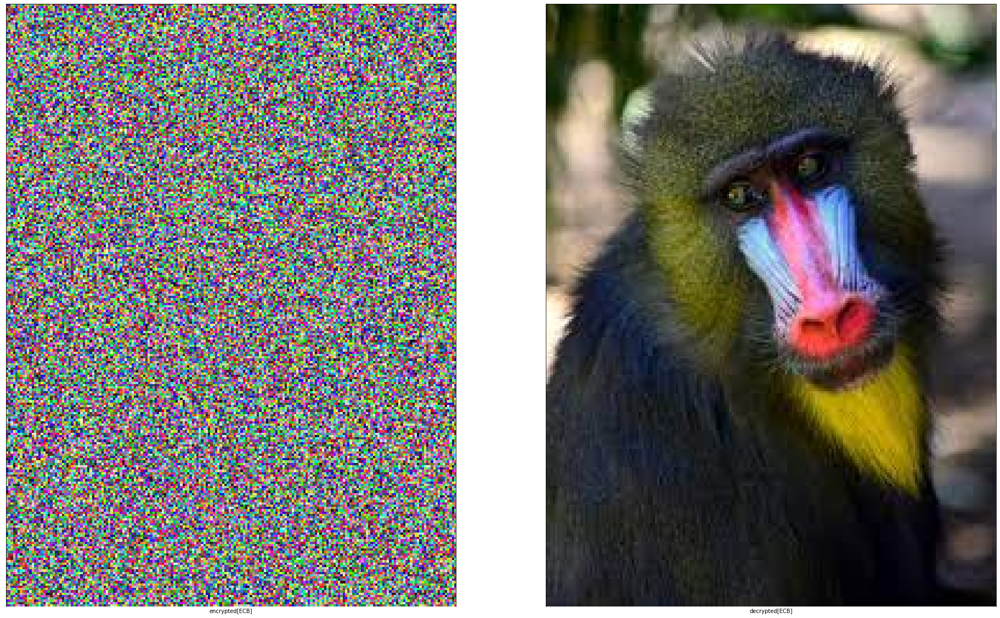

In [74]:
pipeline = Pipeline()
img = images_data[0]

print("START PIPELINE !")

images = pipeline(
    [images_data[0]],
    [ImageOperation.flat_image,ImageOperation.bytes_image, Cipher.AES_ECB, Cipher.AES_ECB],
    [{},{},{"key" : get_random_bytes(16), "encrypt" : True, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB},{"encrypt" : False, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB}] 
)

print("END PIPELINE !")

afficher_img([images[i]["data"] for i in range(len(images))],[images[i]["name"] for i in range(len(images))], color = None)

Cipher + noise

In [75]:
pipeline = Pipeline(False)
img = images_data[0]

print("START PIPELINE !")


images = pipeline(
    [images_data[0]],
    [
     ImageOperation.flat_image, 
     ImageOperation.bytes_image,
     Cipher.AES_ECB, Noising.with_mask_and_proba, Cipher.AES_ECB,
     Cipher.AES_CBC, Noising.with_mask_and_proba, Cipher.AES_CBC,
     Cipher.AES_CTR, Noising.with_mask_and_proba, Cipher.AES_CTR,
     Cipher.AES_CFB, Noising.with_mask_and_proba, Cipher.AES_CFB,
     Cipher.AES_OFB, Noising.with_mask_and_proba, Cipher.AES_OFB,
     Cipher.AES_CCM, Noising.with_mask_and_proba, Cipher.AES_CCM,
     Cipher.AES_GCM, Noising.with_mask_and_proba, Cipher.AES_GCM,
     Cipher.AES_SIV, Noising.with_mask_and_proba, Cipher.AES_SIV,
     Cipher.AES_OCB, Noising.with_mask_and_proba, Cipher.AES_OCB,
     Cipher.AES_EAX, Noising.with_mask_and_proba, Cipher.AES_EAX
     ],
    [
        *[ {},
          {},
          {"key" : get_random_bytes(16), "encrypt" : True, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB},
          {"byte_mask" : (0,0,0,0,0,0,0,1), "noise_probability" : 0.1, "noise_block_size" : 16},
          {"encrypt" : False, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB}
        ],
        *[k[i] for k in [ [{"layer_precedence" : 1, "key" : get_random_bytes(16), "encrypt" : True, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB},{"byte_mask" : (0,0,0,0,0,0,0,1), "noise_probability" : 0.1, "noise_block_size" : 16}, {"encrypt" : False, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB}] for _ in range(0,4)] for i in range(3)],
        *[
          {"layer_precedence" : 1,"key" : get_random_bytes(16), "encrypt" : True, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB, "name" : 'CCM'},
          {"byte_mask" : (0,0,0,0,0,0,0,1), "noise_probability" : 0.1, "noise_block_size" : 16},
          {"encrypt" : False, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB},
          
          {"layer_precedence" : 1,"key" : get_random_bytes(16), "encrypt" : True, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB, "name" : 'GCM'},
          {"byte_mask" : (0,0,0,0,0,0,0,1), "noise_probability" : 0.1, "noise_block_size" : 16},
          {"encrypt" : False, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB},
          
          {"layer_precedence" : 1,"key" : get_random_bytes(16*2), "nonce" : get_random_bytes(16), "encrypt" : True, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB, "name" : 'SIV'},
          {"byte_mask" : (0,0,0,0,0,0,0,1), "noise_probability" : 0.1, "noise_block_size" : 16},
          {"encrypt" : False, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB},
          
          {"layer_precedence" : 1,"key" : get_random_bytes(16), "encrypt" : True, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB, "name" : 'OCB'},
          {"byte_mask" : (0,0,0,0,0,0,0,1), "noise_probability" : 0.1, "noise_block_size" : 16},
          {"encrypt" : False, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB},
          
          {"layer_precedence" : 1,"key" : get_random_bytes(16), "encrypt" : True, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB, "name" : 'EAX'},
          {"byte_mask" : (0,0,0,0,0,0,0,1), "noise_probability" : 0.1, "noise_block_size" : 16},
          {"encrypt" : False, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB}
         ]
    ]    
)

print("END PIPELINE !")
#print(images)

afficher_img([images[i]["data"] for i in range(len(images))],[images[i]["name"] for i in range(len(images))], color = None, figsize=(200,200) )

START PIPELINE !
START !
MAC check failed
MAC check failed
MAC check failed
MAC check failed
MAC check failed
END PIPELINE !


Cipher + noise + denoising autoencodeurs

In [77]:
pipeline = Pipeline(False)
img = images_data[0]

print("START PIPELINE !")

images = pipeline(
    [images_data[0]],
    [
     ImageOperation.flat_image, 
     ImageOperation.bytes_image,
     Cipher.AES_ECB, Noising.with_mask_and_proba, Cipher.AES_ECB, ImageOperation.convertToOriginalDataShape, Noising.denoising_Autoencoder,
     Cipher.AES_CBC, Noising.with_mask_and_proba, Cipher.AES_CBC, ImageOperation.convertToOriginalDataShape, Noising.denoising_Autoencoder,
     Cipher.AES_CTR, Noising.with_mask_and_proba, Cipher.AES_CTR, ImageOperation.convertToOriginalDataShape, Noising.denoising_Autoencoder,
     Cipher.AES_CFB, Noising.with_mask_and_proba, Cipher.AES_CFB, ImageOperation.convertToOriginalDataShape, Noising.denoising_Autoencoder,
     Cipher.AES_OFB, Noising.with_mask_and_proba, Cipher.AES_OFB, ImageOperation.convertToOriginalDataShape, Noising.denoising_Autoencoder
     ],
    [
        *[ 
          {},
          {},
        ],
        *[k[i] for k in [ [{"layer_precedence" : 1, "key" : get_random_bytes(16), "encrypt" : True, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB},{"byte_mask" : (0,0,0,0,0,0,0,1), "noise_probability" : 0.1, "noise_block_size" : 16}, {"encrypt" : False, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB}, {"flag": ColorRes.color_RGB}, {"autoencoder" : autoencoder, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB, "block_height" : 16, "block_width" : 16, "vertical_padding" : 4,"horizontal_padding" : 4 , "isRGB" : True}] for _ in range(5)] for i in range(5)]
    ]    
)

print("END PIPELINE !")

afficher_img([images[i]["data"] for i in range(len(images))],[images[i]["name"] for i in range(len(images))],axis =-1, color = None, figsize=(200,200))

START PIPELINE !
START !
END PIPELINE !


Our method

START PIPELINE !
START !
END PIPELINE !


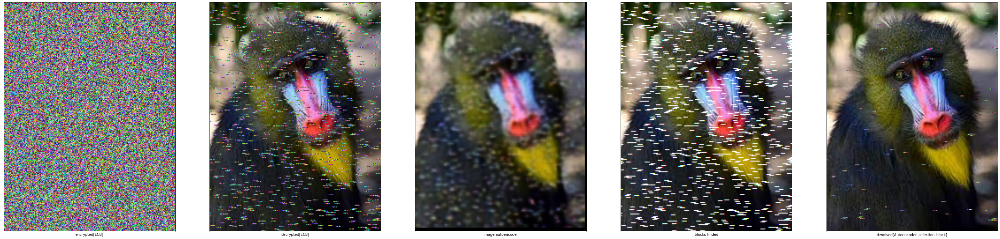

In [78]:
pipeline = Pipeline(False)

print("START PIPELINE !")

images = pipeline(
    [images_data[0]],
     [
     ImageOperation.flat_image, 
     ImageOperation.bytes_image,
     
     Cipher.AES_ECB, Noising.with_mask_and_proba, Cipher.AES_ECB, ImageOperation.convertToOriginalDataShape, Noising.denoising_Autoencoder_selection_block,
     #Cipher.AES_CBC, Noising.with_mask_and_proba, Cipher.AES_CBC, ImageOperation.convertToOriginalDataShape, Noising.denoising_Autoencoder_selection_block,
     
     #Cipher.AES_CFB, Noising.with_mask_and_proba, Cipher.AES_CFB, ImageOperation.convertToOriginalDataShape, Noising.denoising_Autoencoder_selection_block,
     #Cipher.AES_CFB, Noising.with_mask_and_proba, Cipher.AES_CFB, ImageOperation.convertToOriginalDataShape, Noising.denoising_Autoencoder_selection_block_slide
     ],
    [ 
      {},
      {},
      
      #{"layer_precedence" : 1, "key" : get_random_bytes(16), "encrypt" : True, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB},
      #{"byte_mask" : (0,0,0,0,0,0,0,1), "noise_probability" : 0.1, "noise_block_size" : 16, "save_as_param" : True}, 
      #{"encrypt" : False, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB}, 
      #{"flag": ColorRes.color_RGB}, 
      #{"autoencoder" : autoencoder, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB, "block_height" : 16, "block_width" : 16, "vertical_padding" : 4,"horizontal_padding" : 4 , "isRGB" : True, "difference_tolerate" : 800, "second_difference_tolerate" : 900, "forECB" : True, "debug" :True},
      
      {"layer_precedence" : 1, "key" : get_random_bytes(16), "encrypt" : True, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB},
      {"byte_mask" : (1,1,1,0,0,0,0,1), "noise_probability" : 0.1, "noise_block_size" : 16, "save_as_param" : True}, 
      {"encrypt" : False, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB}, 
      {"flag": ColorRes.color_RGB}, 
      {"autoencoder" : autoencoder, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB, "block_height" : 16, "block_width" : 16, "vertical_padding" : 4,"horizontal_padding" : 4 , "isRGB" : True, "difference_tolerate" : 800, "second_difference_tolerate" : 900, "forCBC" : True, "debug" :True},
      #
      #{"layer_precedence" : 1, "key" :get_random_bytes(16), "iv" : (1024).to_bytes(16, byteorder='big'), "encrypt" : True, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB},
      #{"byte_mask" : (1,1,1,1,1,1,1,1), "noise_probability" : 0.01, "noise_block_size" : 16, "save_as_param" : True}, 
      #{"encrypt" : False, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB}, 
      #{"flag": ColorRes.color_RGB}, 
      #{"autoencoder" : autoencoder, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB, "block_height" : 16, "block_width" : 16, "vertical_padding" : 4,"horizontal_padding" : 4 , "isRGB" : True, "difference_tolerate" : 700, "second_difference_tolerate" : 900, "forCFB" : True, "debug" :True},
      #
      #{"layer_precedence" : 1, "key" : (0).to_bytes(16, byteorder='big'), "iv" : (0).to_bytes(16, byteorder='big'), "encrypt" : True, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB},
      #{"byte_mask" : (1,0,0,0,0,0,0,1), "noise_probability" : 0.01, "noise_block_size" : 16, "save_as_param" : True}, 
      #{"encrypt" : False, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB}, 
      #{"flag": ColorRes.color_RGB}, 
      #{"autoencoder" : autoencoder, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB, "block_height" : 16, "block_width" : 16, "vertical_padding" : 4,"horizontal_padding" : 4 , "isRGB" : True, "difference_tolerate" : 800, "second_difference_tolerate" : 900, "forCFB" : True, "debug" :True}
    ]    
)

print("END PIPELINE !")

#print(images)

afficher_img([images[i]["data"] for i in range(len(images))],[images[i]["name"] for i in range(len(images))],axis = 0, color = None)

OpenCV denoising

START PIPELINE !
START !


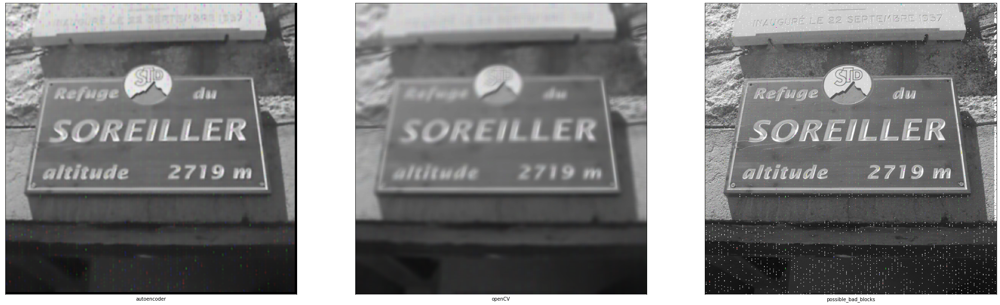

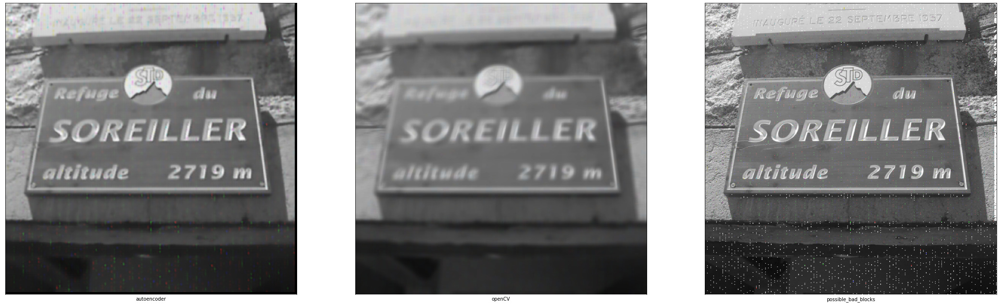

END PIPELINE !


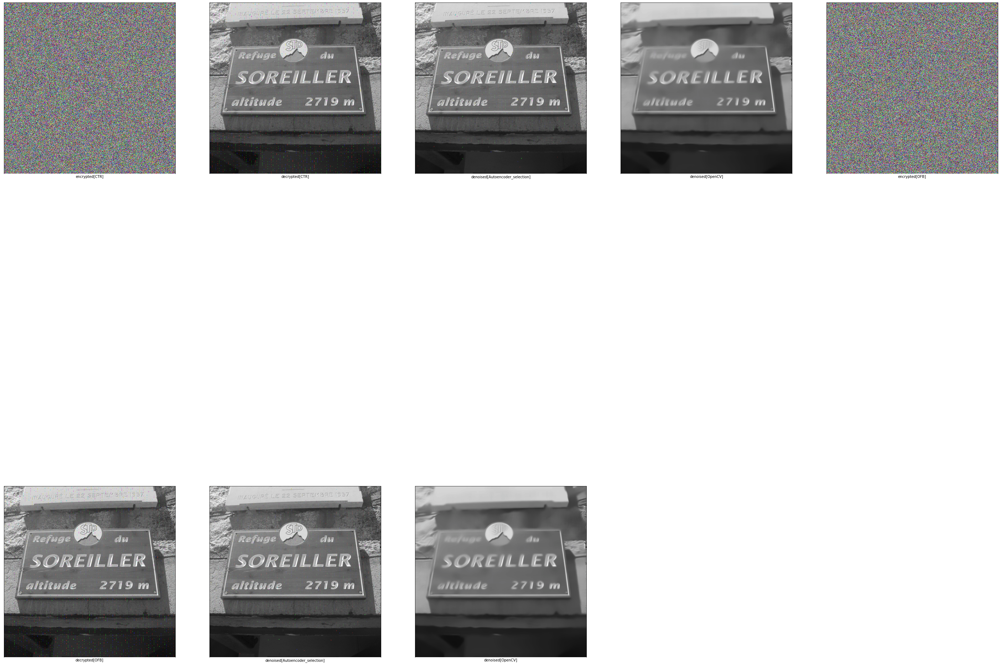

In [79]:
pipeline = Pipeline(False)
#img = images_data[0]

print("START PIPELINE !")

images = pipeline(
    [images_data[8]],
    [
     #ImageOperation.convertColor,
     ImageOperation.flat_image, 
     ImageOperation.bytes_image,
     Cipher.AES_CTR, Noising.with_mask_and_proba, Cipher.AES_CTR, ImageOperation.convertToOriginalDataShape, Noising.denoising_Autoencoder_selection, Noising.denoisingOpenCV,
     Cipher.AES_OFB, Noising.with_mask_and_proba, Cipher.AES_OFB, ImageOperation.convertToOriginalDataShape, Noising.denoising_Autoencoder_selection, Noising.denoisingOpenCV
     ],
    [
        *[ 
            
          #{"mode" : 'toNB'},
          {},
          {},
        ],
        *[
          k[i] for k in [ [
              {"layer_precedence" : 1, "key" : get_random_bytes(16), "encrypt" : True, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB},
              {"byte_mask" : (1,1,0,0,0,0,0,1), "noise_probability" : 0.1, "noise_block_size" : 16, "save_as_param" : True}, 
              {"encrypt" : False, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB}, 
              {"flag": ColorRes.color_RGB}, 
              {"autoencoder" : autoencoderNB, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB, "block_height" : 16, "block_width" : 16, "vertical_padding" : 4,"horizontal_padding" : 4 , "isRGB" : False, "difference_tolerate" : 128, "second_difference_tolerate" : 80, "debug" : True}, 
              {"templateWindowSize" : 10,  "searchWindowSize":20 ,"h": 15,"hColor": 15, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB }] for _ in range(2)] for i in range(6)
        ],
    ]    
)

print("END PIPELINE !")

afficher_img([ images[i]["data"] for i in range(len(images))],[images[i]["name"] for i in range(len(images))],axis = -1, color = 'gray')

START PIPELINE !
START !


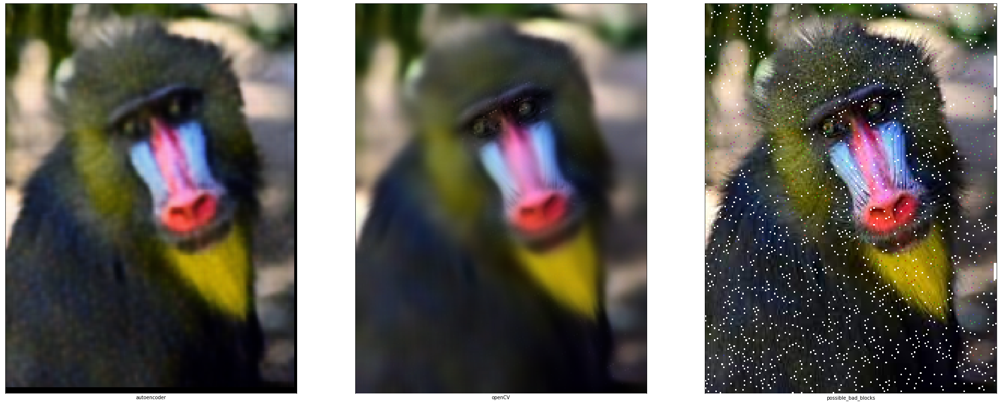

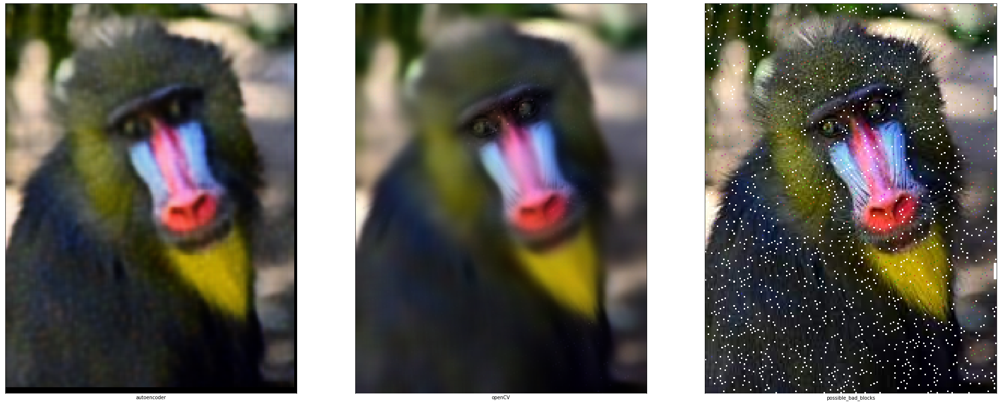

END PIPELINE !


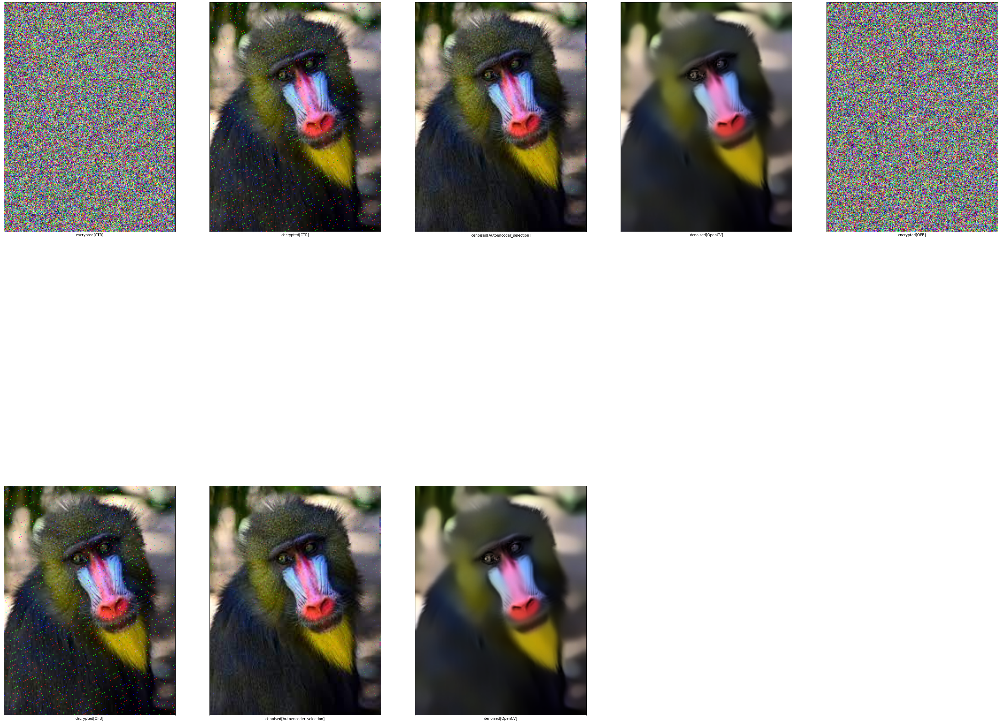

In [80]:
pipeline = Pipeline(False)
img = images_data[0]

print("START PIPELINE !")

images = pipeline(
    [images_data[0]],
    [
     ImageOperation.flat_image, 
     ImageOperation.bytes_image,
     Cipher.AES_CTR, Noising.with_mask_and_proba, Cipher.AES_CTR, ImageOperation.convertToOriginalDataShape, Noising.denoising_Autoencoder_selection, Noising.denoisingOpenCV,
     Cipher.AES_OFB, Noising.with_mask_and_proba, Cipher.AES_OFB, ImageOperation.convertToOriginalDataShape, Noising.denoising_Autoencoder_selection, Noising.denoisingOpenCV

     ],
    [
        *[ 
          {},
          {},
        ],
        *[
          k[i] for k in [ [
              {"layer_precedence" : 1, "key" : get_random_bytes(16), "encrypt" : True, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB},
              {"byte_mask" : (1,1,0,0,0,0,0,1), "noise_probability" : 0.2, "noise_block_size" : 16, "save_as_param" : True}, 
              {"encrypt" : False, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB}, 
              {"flag": ColorRes.color_RGB}, 
              {"autoencoder" : autoencoder, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB, "block_height" : 16, "block_width" : 16, "vertical_padding" : 4,"horizontal_padding" : 4 , "isRGB" : True, "difference_tolerate" : 128, "second_difference_tolerate" : 80, "debug" : True}, 
              {"templateWindowSize" : 10,  "searchWindowSize":20 ,"h": 15,"hColor": 15, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB }] for _ in range(2)] for i in range(6)
        ],
    ]    
)

print("END PIPELINE !")


afficher_img([images[i]["data"] for i in range(len(images))],[images[i]["name"] for i in range(len(images))],axis = -1, color = None)

START PIPELINE !
START !


<ipython-input-27-86326728b9f9>:286: RuntimeWarning: overflow encountered in ubyte_scalars
  t_h[ind_v] = abs(t_h[ind_v] - t_cur[ind_v])
<ipython-input-27-86326728b9f9>:276: RuntimeWarning: overflow encountered in ubyte_scalars
  t_h[ind_v] = (t_h[ind_v] + t_l[ind_v]) /2


END PIPELINE !


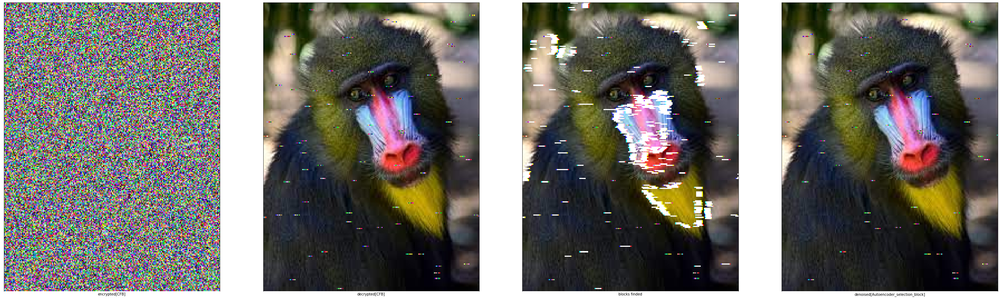

In [81]:
pipeline = Pipeline(False)
print("START PIPELINE !")

images = pipeline(
    [images_data[0]],
    [
     ImageOperation.flat_image, 
     ImageOperation.bytes_image,
     
     #Cipher.AES_ECB, Noising.with_mask_and_proba, Cipher.AES_ECB, ImageOperation.convertToOriginalDataShape, Noising.denoising_Autoencoder_selection_block
     #Cipher.AES_CBC, Noising.with_mask_and_proba, Cipher.AES_CBC, ImageOperation.convertToOriginalDataShape, Noising.denoising_Autoencoder_selection_block
     
     #Cipher.AES_CFB, Noising.with_mask_and_proba, Cipher.AES_CFB, ImageOperation.convertToOriginalDataShape, Noising.denoising_Autoencoder_selection_block,
     Cipher.AES_CFB, Noising.with_mask_and_proba, Cipher.AES_CFB, ImageOperation.convertToOriginalDataShape, Noising.denoising_entopy
     ],
    [ 
      {},
      {},
      
      #{"layer_precedence" : 1, "key" : get_random_bytes(16), "encrypt" : True, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB},
      #{"byte_mask" : (1,1,1,0,0,0,0,1), "noise_probability" : 0.01, "noise_block_size" : 16, "save_as_param" : True}, 
      #{"encrypt" : False, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB}, 
      #{"flag": ColorRes.color_RGB}, 
      #{"autoencoder" : autoencoder, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB, "block_height" : 16, "block_width" : 16, "vertical_padding" : 4,"horizontal_padding" : 4 , "isRGB" : True, "difference_tolerate" : 800, "second_difference_tolerate" : 900, "forECB" : True, "debug" :True},
      
      #{"layer_precedence" : 1, "key" : get_random_bytes(16), "encrypt" : True, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB},
      #{"byte_mask" : (1,1,1,0,0,0,0,1), "noise_probability" : 0.01, "noise_block_size" : 16, "save_as_param" : True}, 
      #{"encrypt" : False, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB}, 
      #{"flag": ColorRes.color_RGB}, 
      #{"autoencoder" : autoencoder, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB, "block_height" : 16, "block_width" : 16, "vertical_padding" : 4,"horizontal_padding" : 4 , "isRGB" : True, "difference_tolerate" : 800, "second_difference_tolerate" : 900, "forCBC" : True, "debug" :True},
      

      #nb : min ent = 4


      {"layer_precedence" : 1, "key" :get_random_bytes(16), "encrypt" : True, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB},
      {"byte_mask" : (0,0,0,0,0,0,0,1), "noise_probability" : 0.01, "noise_block_size" : 16, "save_as_param" : True}, 
      {"encrypt" : False, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB}, 
      {"flag": ColorRes.color_RGB}, 
      {"autoencoder" : autoencoder, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB, "block_height" : 16, "block_width" : 16, "vertical_padding" : 4,"horizontal_padding" : 4 , "isRGB" : True, "min_entopy_tolerate" : 1.6, "max_entopy_tolerate" : 2.4, "forCFB" : True, "debug" :True, "nb_block_submax" : 10, "separation" : 6, "min_dif" : .6, "min_dif_tolerate" : 2000}
      
      #{"layer_precedence" : 1, "key" : (0).to_bytes(16, byteorder='big'), "iv" : (0).to_bytes(16, byteorder='big'), "encrypt" : True, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB},
      #{"byte_mask" : (1,0,0,0,0,0,0,1), "noise_probability" : 0.01, "noise_block_size" : 16, "save_as_param" : True}, 
      #{"encrypt" : False, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB}, 
      #{"flag": ColorRes.color_RGB}, 
      #{"autoencoder" : autoencoder, "keep_results" : True, "original_shape" : True, "flag": ColorRes.color_RGB, "block_height" : 16, "block_width" : 16, "vertical_padding" : 4,"horizontal_padding" : 4 , "isRGB" : True, "difference_tolerate" : 800, "second_difference_tolerate" : 900, "forCFB" : True, "debug" :True}
    ]    
)

print("END PIPELINE !")

#print(images)

afficher_img([images[i]["data"] for i in range(len(images))],[images[i]["name"] for i in range(len(images))],axis = 0, color = None)

With Shamir denoising

START PIPELINE !
START !


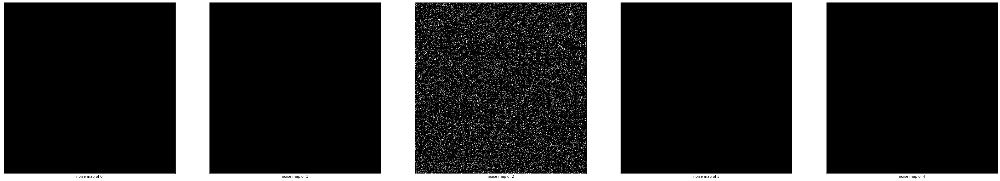

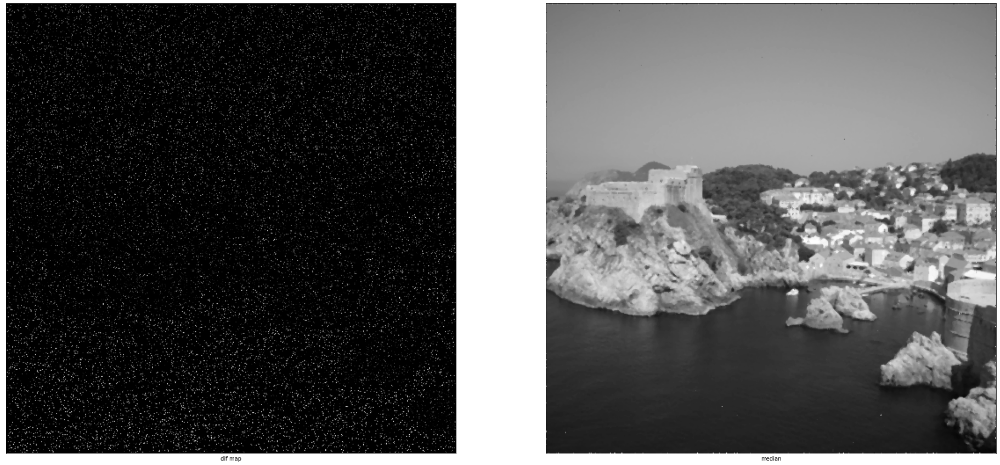

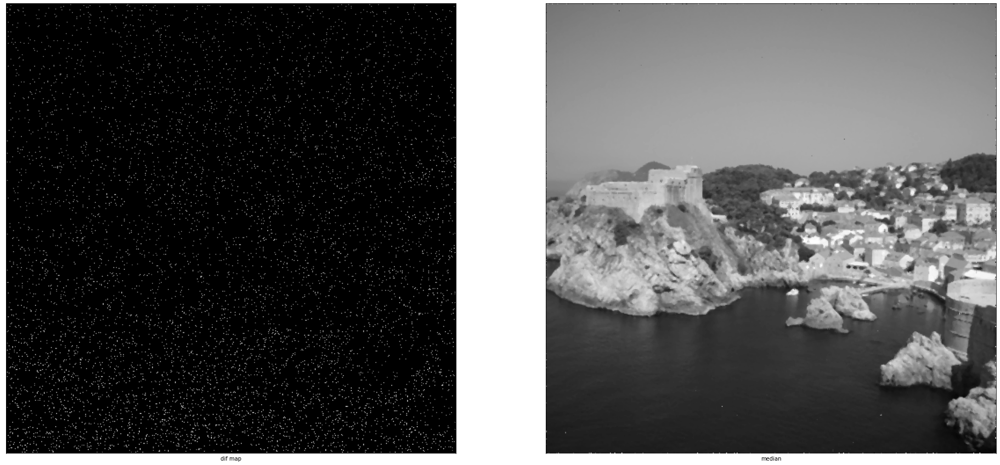

END PIPELINE !


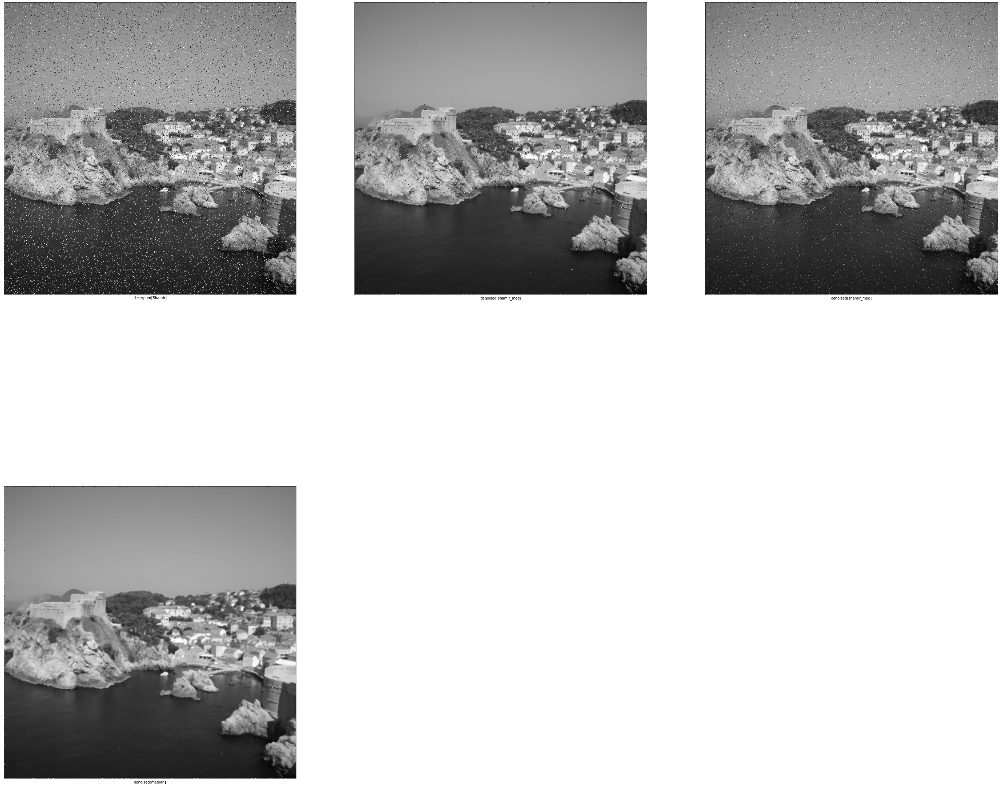

In [82]:
pipeline = Pipeline(False)

print("START PIPELINE !")

images = pipeline(
    [images_data[6]],
    [
     ImageOperation.convertColor,
     Cipher.Shamir,
     Noising.noising_for_shamirpart,
     Cipher.Shamir,
     Noising.denoising_median_filter_shamir,
     
     Noising.denoising_median_filter_shamir,
     #Noising.denoising_median_filter_shamir,
     #Noising.denoising_median_filter_shamir
     ],
    [ 
      {"mode" : 'toNB'},
      {  "k" : 3, "n" : 5, "encrypt" : True, "dont_split_data" : True},
      {  "byte_mask" : (1,1,1,1,1,1,1,1),  "noise_probability_list" : [.1] , "part_to_affect" : [2], "save_as_param" : True, "dont_split_data" : True},
      { "keep_results" : True, "original_shape" : False, "flag": ColorRes.color_R,"shamir_selection" :[1,2,3] },
     
      { "keep_results" : True, "original_shape" : False, "flag": ColorRes.color_R, "w_size" : 3, "dif_tolerate" : 10, "dif_tolerate_after_correction" : 10},
      #{ "layer_precedence" : 3, "keep_results" : True, "original_shape" : False, "flag": ColorRes.color_R, "w_size" : 3, "dif_tolerate" : 20, "dif_tolerate_after_correction" : 10 },
      #{ "layer_precedence" : 3, "keep_results" : True, "original_shape" : False, "flag": ColorRes.color_R, "w_size" : 3, "dif_tolerate" : 50, "dif_tolerate_after_correction" : 20 },
      { "layer_precedence" : 3, "keep_results" : True, "original_shape" : False, "flag": ColorRes.color_R, "w_size" : 3, "dif_tolerate" : 100, "dif_tolerate_after_correction" : 50, "with_mediane" : True }
    ]    
)

print("END PIPELINE !")

#print(images)

afficher_img([images[i]["data"] for i in range(len(images))],[images[i]["name"] for i in range(len(images))],axis = -1, color = 'gray')

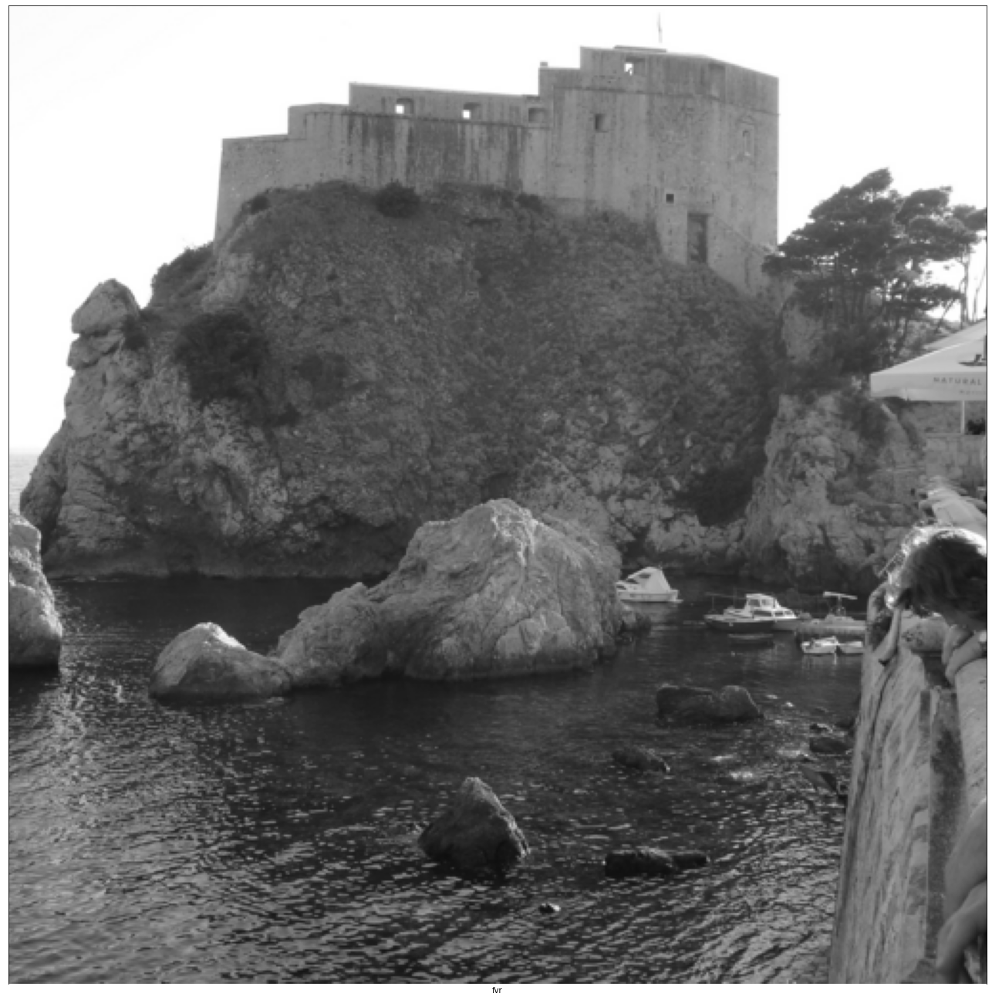

In [83]:
afficher_img( [images_data[4]] ,['fvr'],axis = -1, color = 'gray')

Other tests

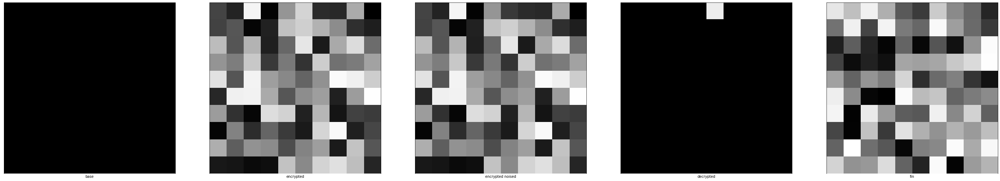

In [84]:
k = get_random_bytes(16)
cipher = AES.new(k, AES.MODE_OFB)

iv = cipher.iv
#nonce = cipher.nonce

img_test = np.zeros(100, dtype=bytes)
img_ciph = cipher.encrypt(pad(bytearray(img_test), AES.block_size ))


img_base = [k for k in [[ bytearray(img_test)[i],bytearray(img_test)[i],bytearray(img_test)[i] ] for i in range(100) ]]
res      = [k for k in [[ bytearray(img_ciph)[i],bytearray(img_ciph)[i],bytearray(img_ciph)[i] ] for i in range(100) ]]

img_ciph = bytearray(img_ciph)
img_ciph[5] = (img_ciph[5] + 100)%255


cipher     = AES.new(k, AES.MODE_OFB, iv = iv)
img_deciph = unpad(cipher.decrypt(img_ciph) , AES.block_size)
img_deciph = bytearray(img_deciph)

res_2      = [k for k in [[ bytearray(img_ciph)[i],bytearray(img_ciph)[i],bytearray(img_ciph)[i] ] for i in range(100) ]]
res_deciph = [k for k in [[ bytearray(img_deciph)[i],bytearray(img_deciph)[i],bytearray(img_deciph)[i] ] for i in range(100) ]]


img_ciph[5] = (img_ciph[5] - 10)%255
#cipher     = AES.new(k, AES.MODE_CFB, iv = iv)
img_deciph = cipher.decrypt(img_ciph)
img_deciph = bytearray(img_deciph)

res_deciph_2 = [k for k in [[ bytearray(img_deciph)[i],bytearray(img_deciph)[i],bytearray(img_deciph)[i] ] for i in range(100) ]]


#print(np.array(bytearray(img_ciph)))
#print(res)

afficher_img([ np.reshape(img_base, (10,10,3)) ,np.reshape(res, (10,10,3)), np.reshape(res_2, (10,10,3)), np.reshape(res_deciph, (10,10 ,3)), np.reshape(res_deciph_2, (10,10 ,3)) ],['base', 'encrypted', 'encrypted noised', 'decrypted', 'fin'],axis = 0,color = 'gray')

In [85]:
for i in range(len(images)) :
  img = images[i]
  print("FOR " + img["name"])
  print("PSNR with original : ", PSNR(images_data[4][:,:,1], img["data"]))
  print("UACI with original : ", UACI(images_data[4][:,:,1], img["data"]))
  print("NPCR with original : ", NPCR(images_data[4][:,:,1], img["data"]))



#print("for next")
#print("PSNR with original : ", PSNR(images[5]["data"], images[6]["data"]))
#print("UACI with original : ", UACI(images[5]["data"], images[6]["data"]))  
#print("NPCR with original : ", NPCR(images[5]["data"], images[6]["data"]))
#
#print("for next")
#print("PSNR with original : ", PSNR(images[7]["data"], images[6]["data"]))
#print("UACI with original : ", UACI(images[7]["data"], images[6]["data"]))  
#print("NPCR with original : ", NPCR(images[7]["data"], images[6]["data"]))

FOR decrypted[Shamir]
PSNR with original :  10.01202408730748
UACI with original :  25.938916673847274
NPCR with original :  99.35340881347656
FOR denoised[shamir_med]
PSNR with original :  10.29219149454925
UACI with original :  25.235362333409928
NPCR with original :  99.31716918945312
FOR denoised[shamir_med]
PSNR with original :  10.202155930726711
UACI with original :  25.430463903090534
NPCR with original :  99.33700561523438
FOR denoised[median]
PSNR with original :  10.358815477906475
UACI with original :  25.06410187365962
NPCR with original :  99.32975769042969


## Encrypt functions (@deprecated)

In [ ]:
from enum import Enum, Flag, auto

class cipher_mode(Enum):
    AES_ECB = (1,0)
    AES_CBC = (1,1)
    AES_CTR = (1,2)
    AES_CFB = (1,3)
    AES_OFB = (1,4)
    AES_CCM = (1,5)
    AES_GCM = (1,6)
    AES_SIV = (1,7)
    AES_OCB = (1,8)
    AES_EAX = (1,9)
    Shamir = (2,0)

class ColorRes(Flag):
    color_R = auto()
    color_G = auto()
    color_B = auto()
    color_RGB = color_R | color_G | color_B

 #================================================== ================================================ ================================================== 
 #================================================ cipher class for perform encryption and data holding ================================================ 
 #================================================== ================================================ ==================================================
class IMG_cipher :
  def __init__(self, raw_data_in_bytesarr, nb_row, nb_col):
    self.data = raw_data_in_bytesarr
    self.dim = (nb_row,nb_col,3)
    self.nb_val = self.dim[0] * self.dim[1] * self.dim[2]

  #================================================ img manipulation ================================================ 
  @staticmethod
  def flat_imgs(img, nb_values) :
    return [ np.reshape(img[i], (1,nb_values[i]))[0] for i in range(0,len(img)) ]

  @staticmethod
  def bytes_imgs(img) :
    return [bytearray(i) for i in img]
  
  @staticmethod
  def get_img2D(img,nb_values, dim, flag = ColorRes.color_RGB) : 
    #array_bytes = bytearray(self.data)[:self.nb_val]
    res = []
    for el in img :
      array_bytes = el[:nb_values]

      start_c   = -1 
      end_c     = -1
      ind_j   = 1

      if(flag in ColorRes.color_R) :
        end_c = 1
        start_c = 0

      if(flag in ColorRes.color_G) :
        end_c = 2
        if(start_c < 0) :
          start_c = 1
      if(flag in ColorRes.color_B) :
        end_c = 3
        if(start_c < 0) :
          start_c = 2
        else :
          ind_j = 2-start_c
    
      res.append(np.reshape(array_bytes, dim)[:,:,start_c:end_c:ind_j])
    
    return res

  @staticmethod
  def noise_data(img, bit_mask = (0,0,0,0,0,0,0,0), noise_probability = 0.1 , block_size = 1, with_last_block = False) :
    res = []
    for el in img :
      img_res = bytearray(el)

      mask_val = 0
      if(type(bit_mask) is tuple) :
        reversed(bit_mask)
        for i in range(0,8) :
          mask_val += (bit_mask[i] << i)
      else :
        if(type(bit_mask) is bytes) :
          mask_val = bit_mask
        else:
          raise Exception("Sorry, only 8 long tuples or int are accepted as bit_mask val")
    

      nb_b = ( len(img_res)//block_size ) 
      if(with_last_block == False) :
        nb_b -=1 

      probability_map_tmp = np.random.rand(nb_b)
      probability_map = np.zeros(nb_b).astype(int)
      probability_map[probability_map_tmp<noise_probability] = random.randint(0,16)
      probability_map[probability_map_tmp>=noise_probability] = -1

      for i in range(0,nb_b) :
        if(probability_map[i]>(-1)):
          ind = probability_map[i] + (i * block_size)
        img_res[ind] = img_res[ind] ^ mask_val
      res.append(img_res)

  def change_dim(self, nb_row, nb_col) :
    self.dim = (nb_row,nb_col,3)
    self.nb_val = self.dim[0] * self.dim[1] * self.dim[2]
  
  
  # ==============================================================================================================
  # ================================================ cipher functions
  # ==============================================================================================================

  # ================================================ ECB ================================================
  def AES_ECB(self, keep_precedent = False, encrypt = False, key = get_random_bytes(16)) :
    cipher = AES.new(key, AES.MODE_ECB)
    if(encrypt) :
      if(keep_precedent) : 
        self.data = cipher.encrypt(pad(self.data, AES.block_size))
      else : 
        return cipher.encrypt(pad(self.data, AES.block_size))
    else :
      if(keep_precedent) : 
        self.data = unpad(cipher.decrypt(self.data), AES.block_size)
      else : 
        return unpad(cipher.decrypt(self.data), AES.block_size)

  # ================================================ CBC ================================================
  def AES_CBC(self, keep_precedent = False, encrypt = False, key = get_random_bytes(16), iv = None ) :
    cipher = AES.new(key, AES.MODE_CBC, iv = iv)
    if(encrypt) :
      if(keep_precedent) : 
        self.data = cipher.encrypt(pad(self.data, AES.block_size))
        return cipher.iv
      else : 
        return cipher.encrypt(pad(self.data, AES.block_size)), cipher.iv
    else :
      if(keep_precedent) : 
        self.data = unpad(cipher.decrypt(self.data), AES.block_size)
      else : 
        return unpad(cipher.decrypt(self.data), AES.block_size)

  # ================================================ CTR ================================================
  def AES_CTR(self, keep_precedent = False, encrypt = False, key = get_random_bytes(16), nonce = None ) :
    cipher = AES.new(key, AES.MODE_CTR, nonce = nonce)
    if(encrypt) :
      if(keep_precedent) : 
        self.data = cipher.encrypt(self.data)
        return cipher.nonce
      else : 
        return cipher.encrypt(self.data), cipher.nonce
    else :
      if(keep_precedent) : 
        self.data = cipher.decrypt(self.data)
      else : 
        return cipher.decrypt(self.data)
  
  # ================================================ CFB ================================================
  def AES_CFB(self, keep_precedent = False, encrypt = False, key = get_random_bytes(16), iv = None ) :
    cipher = AES.new(key, AES.MODE_CFB, iv = iv)
    if(encrypt) :
      if(keep_precedent) : 
        self.data = cipher.encrypt(self.data)
        return cipher.iv
      else : 
        return cipher.encrypt(self.data), cipher.iv
    else :
      if(keep_precedent) : 
        self.data = cipher.decrypt(self.data)
      else : 
        return cipher.decrypt(self.data)
  
  # ================================================ OFB ================================================
  def AES_OFB(self, keep_precedent = False, encrypt = False, key = get_random_bytes(16), iv = None ) :
    cipher = AES.new(key, AES.MODE_OFB, iv = iv)
    if(encrypt) :
      if(keep_precedent) : 
        self.data = cipher.encrypt(self.data)
        return cipher.iv
      else : 
        return cipher.encrypt(self.data), cipher.iv
    else :
      if(keep_precedent) : 
        self.data = cipher.decrypt(img)
      else : 
        return cipher.decrypt(img)
  
  # ================================================ CCM ================================================
  def AES_CCM(self, keep_precedent = False, encrypt = False, key = get_random_bytes(16), nonce = None,name = 'img_ccm', tag = None) :
    cipher = AES.new(key, AES.MODE_CCM, nonce=nonce)
    header = bytes(name, 'utf-8')
    cipher.update(header)

    if(encrypt) :
      if(keep_precedent) : 
        self.data, tag = cipher.encrypt_and_digest(self.data)
        return tag, cipher.nonce, name
      else : 
        return cipher.encrypt_and_digest(self.data), cipher.nonce, name
    else :
      if(keep_precedent) : 
        self.data = cipher.decrypt_and_verify(self.data, tag)
      else : 
        return cipher.decrypt_and_verify(self.data, tag)

  # ================================================ GCM ================================================
  def AES_GCM(self, keep_precedent = False, encrypt = False, key = get_random_bytes(16), nonce = None,name = 'img_gcm', tag = None) :
    cipher = AES.new(key, AES.MODE_GCM, nonce=nonce)
    header = bytes(name, 'utf-8')
    cipher.update(header)

    if(encrypt) :
      if(keep_precedent) : 
        self.data, tag = cipher.encrypt_and_digest(self.data)
        return tag, cipher.nonce, name
      else : 
        return cipher.encrypt_and_digest(self.data), cipher.nonce, name
    else :
      if(keep_precedent) : 
        self.data = cipher.decrypt_and_verify(self.data, tag)
      else : 
        return cipher.decrypt_and_verify(self.data, tag)

  # ================================================ SIV ================================================
  def AES_SIV(self, keep_precedent = False, encrypt = False, key = get_random_bytes(16), nonce= get_random_bytes(16),name = 'img_siv', tag = None) :
    cipher = AES.new(key, AES.MODE_SIV, nonce=nonce)
    header = bytes(name, 'utf-8')
    cipher.update(header)

    if(encrypt) :
      if(keep_precedent) : 
        self.data, tag = cipher.encrypt_and_digest(self.data)
        return tag, nonce, name
      else : 
        return cipher.encrypt_and_digest(self.data), nonce, name
    else :
      if(keep_precedent) : 
        self.data = cipher.decrypt_and_verify(self.data, tag)
      else : 
        return cipher.decrypt_and_verify(self.data, tag)

  # ================================================ OCB ================================================
  def AES_OCB(self, keep_precedent = False, encrypt = False, key = get_random_bytes(16), nonce= None ,name = 'img_ocb', tag = None) :
    cipher = AES.new(key, AES.MODE_OCB, nonce=nonce)
    header = bytes(name, 'utf-8')
    cipher.update(header)

    if(encrypt) :
      if(keep_precedent) : 
        self.data, tag = cipher.encrypt_and_digest(self.data)
        return tag, cipher.nonce, name
      else : 
        return cipher.encrypt_and_digest(self.data), cipher.nonce, name
    else :
      if(keep_precedent) : 
        self.data = cipher.decrypt_and_verify(self.data, tag)
      else : 
        return cipher.decrypt_and_verify(self.data, tag)
  
  # ================================================ EAX ================================================
  def AES_EAX(self, keep_precedent = False, encrypt = False, key = get_random_bytes(16), nonce= None ,name = 'img_eax', tag = None) :
    cipher = AES.new(key, AES.MODE_EAX, nonce=nonce)
    header = bytes(name, 'utf-8')
    cipher.update(header)

    if(encrypt) :
      if(keep_precedent) : 
        self.data, tag = cipher.encrypt_and_digest(self.data)
        return tag, cipher.nonce, name
      else : 
        return cipher.encrypt_and_digest(self.data), cipher.nonce, name
    else :
      if(keep_precedent) : 
        self.data = cipher.decrypt_and_verify(self.data, tag)
      else : 
        return cipher.decrypt_and_verify(self.data, tag)


  # ================================================ SHAMIR ================================================
  def Shamir(self,k,n,keep_precedent = False, encrypt = False) :
    if(encrypt) :
      img = np.reshape(self.data, self.dim)

      x_for_shares = []
      for i in range(1,n+1) :
        for j in range(1,k) :
          x_for_shares.append(pow(i,j))

      shares = np.zeros((n,self.dim[0] ,self.dim[1],self.dim[2]), dtype=int)

      for r in range(0, self.dim[0]) :
        for c in range(0, self.dim[1]) :
          #get rdm coef for a
          rdm_a = random.sample(range(0,251), k-1)
          for j in range(0,n) :
            for colc in range(0,3) :
              #initialisation
              if(img[r][c][colc] <= 250) :
                shares[j][r][c][colc] = img[r][c][colc]
              else :
                shares[j][r][c][colc] = 250
              #compute ax coef values  
              for x_vr in range(0,k-1) : 
                ai = rdm_a[x_vr]
                xi = x_for_shares[x_vr + j * (k-1)]
                shares[j][r][c][colc] +=  ai*xi

              shares[j][r][c][colc] = shares[j][r][c][colc] % 251
      if(keep_precedent) :
        self.shares = shares
      else :
        return shares

    else : 
       img_decrypted = np.zeros(self.dim, dtype=int)
       for cr in range(0,self.dim[0]) :
        for cc in range(0,self.dim[1]) :
          for i in range(0,3) :
            lg_x = []
            lg_y = []
            for index_s in k :
              lg_x.append(index_s)
              lg_y.append(shares[index_s-1][cr][cc][i])

              #lagrange interpolation
              poly = lagrange(lg_x, lg_y)
              img_decrypted[cr][cc][i] = int(poly.coef[-1] %251)
        
        if(keep_precedent) :
          self.data = img_decrypted
        else :
          return img_decrypted

  def Shamir_GF(self,k,n, keep_precedent = False, encrypt = False) :
    
    if(encrypt) :
      prepared_img = bytearray(self.data)

      #need to keep a block size equal to 16 bytes
      dim = len(self.data)
      rest_val = dim%16
      if(rest_val != 0) :
        prepared_img = np.resize(prepared_img,(len(prepared_img) + 16-rest_val))
  
      nb_b_img = len(prepared_img)//16
      shares = [[] for _ in range(0,n)]
      step = 0

      for i in range(0,nb_b_img) :
        s_b = Shamir.split(k, n, bytes(prepared_img[step : step+16]))
        step+=16

        for (j,val) in s_b :
          shares[j-1].append(bytearray(val))
          #shares_v[j-1] = np.append(shares_v[j-1] , (bytearray(val))).astype(int)

      if(keep_precedent) :
        self.shares = shares
      else :
        return shares

    else :
        img_decrypted = [] 
        nb_b = len(self.shares[0])

        for i in range(0,nb_b) :
          elements = [(j,bytes(self.shares[j-1][i])) for j in k]
          val_img = Shamir.combine(elements)
          img_decrypted = np.append(img_decrypted, bytearray(val_img)).astype(int)
        
        if(keep_precedent) :
          self.data = img_decrypted
        else :
          return img_decrypted


 #======================================================================================================================================================
 #======================================================================================================================================================
 #======================================================================================================================================================

# encrypt or decrypt an image with the datas provided
# return the image data value required and a layer to provide informations about the cipher method
def cipher_img_AES(img, layer,encrypt, AESmode,key, iv,nonce,header, tag) :
  layer["key"] = key

  if(AESmode == 0) :
    img.AES_ECB(keep_precedent = True, encrypt = encrypt, key = key)
    return
  if(AESmode == 1) :
    res = img.AES_CBC(keep_precedent = True, encrypt = encrypt, key = key, iv = iv)
    layer["iv"] = res if encrypt else None
    return
  if(AESmode == 2) :
    res = img.AES_CTR(keep_precedent = True, encrypt = encrypt, key = key, nonce = nonce)
    layer["nonce"] = res if encrypt else None
    return
  if(AESmode == 3) :
    res = img.AES_CFB(keep_precedent = True, encrypt = encrypt, key = key, iv = iv)
    layer["iv"] = res if encrypt else None
    return
  if(AESmode == 4) :
    res = img.AES_OFB(keep_precedent = True, encrypt = encrypt, key = key, iv = iv)
    layer["iv"] = res if encrypt else None
    return

  if(AESmode == 5) :
    res = None
    if(len(header) > 0) :
      res = img.AES_CCM(keep_precedent = True, encrypt = encrypt, key = key, nonce = nonce,name = header, tag = tag)  
    else :
      res = img.AES_CCM(keep_precedent = True, encrypt = encrypt, key = key, nonce = nonce, tag = tag) 

    layer["tag"]    = res[0] if encrypt else None
    layer["nonce"]  = res[1] if encrypt else None 
    layer["name"]   = res[2] if encrypt else None 

    return
  if(AESmode == 6) :
    res = None
    if(len(header) > 0) :
      img.AES_GCM(keep_precedent = True, encrypt = encrypt, key = key, nonce = nonce, name = header, tag = tag)
    else : 
      img.AES_GCM(keep_precedent = True, encrypt = encrypt, key = key, nonce = nonce, tag = tag)

    layer["tag"]    = res[0] if encrypt else None
    layer["nonce"]  = res[1] if encrypt else None 
    layer["name"]   = res[2] if encrypt else None 

    return
  if(AESmode == 7) :
    res = None
    if(len(header) > 0) :
      img.AES_SIV(keep_precedent = True, encrypt = encrypt, key = key, nonce = nonce, name = header, tag = tag)
    else : 
      img.AES_SIV(keep_precedent = True, encrypt = encrypt, key = key, nonce = nonce, tag = tag)

    layer["tag"]    = res[0] if encrypt else None
    layer["nonce"]  = res[1] if encrypt else None 
    layer["name"]   = res[2] if encrypt else None 
    return
  if(AESmode == 8) :
    res = None
    if(len(header) > 0) :
      img.AES_OCB(keep_precedent = True, encrypt = encrypt, key = key, nonce = nonce, name = header, tag = tag)
    else : 
      img.AES_OCB(keep_precedent = True, encrypt = encrypt, key = key, nonce = nonce, tag = tag)
    
    layer["tag"]    = res[0] if encrypt else None
    layer["nonce"]  = res[1] if encrypt else None 
    layer["name"]   = res[2] if encrypt else None 
    return
  if(AESmode == 9) :
    res = None
    if(len(header) > 0) :
      img.AES_EAX(keep_precedent = True, encrypt = encrypt, key = key, nonce = nonce, name = header, tag = tag)
    else : 
      img.AES_EAX(keep_precedent = True, encrypt = encrypt, key = key, nonce = nonce, tag = tag)
    
    layer["tag"]    = res[0] if encrypt else None
    layer["nonce"]  = res[1] if encrypt else None 
    layer["name"]   = res[2] if encrypt else None 
    return
  raise ValueError("AES mode need to be between 0 and 9 : \n- ")
  
def cipher_img_Shamir(img, layer, SHAMIRmode, encrypt ,n, k) :
  layer["k"]    = k if encrypt else None  
  layer["n"]    = n
    
  if(SHAMIRmode == 0) :
    img.Shamir(k,n,keep_precedent = True, encrypt = encrypt)
    return
  if(SHAMIRmode == 1) :
    img.Shamir_GF(k,n,keep_precedent = True, encrypt = encrypt)
    return
  raise ValueError("Shamir mode need to be between 0 and 1 : \n- ")

def cipher_img ( 
    img, 
    cp_mode = cipher_mode.AES_ECB,
    encrypt = False,

    #for AES 
    key = get_random_bytes(16),
    iv = None,
    nonce = None,
    header = '',
    tag = None,

    #for Shamir
    part_n = 5,
    part_k = 2 
 ) :

  """cipher images with a special mode.
  Args:
    img (list of one byte values [0:255]):
      All the pixels values of an image (3 for RGB)
    cp_mode (cipher_mode):
      The mode for cypher the image
    key (key to encrypt datas [for AES only]) :
      key with a length of 16, 24 or 32 bytes
    iv (initialisation vector, if needed [for AES only]) :
      initialisation vector that fit the length of the key
    nonce ([for AES only]) : 
      value used on specials modes of AES (only one time with the same key to provide good security)
    header ([for modern AES modes only]) : 
      non-confidential associated data to the image
  Return:
    Values of the encryption (depend on cypher mode)
  """
  imgtoCP = None
  if(type(img) is IMG_cipher) :
    imgtoCP = img
  else : 
    imgtoCP = IMG_cipher(
      IMG_cipher.bytes_imgs(IMG_cipher.flat_imgs([img], [len(img) * len(img[0]) * len(img[0][0])]))[0],
      len(img),
      len(img[0])
    )
  
  #layer informations
  layer = {
    "mode" : cp_mode,
    "encript" :  encrypt
  }

  try:
    if(cp_mode.value[0] == 1):
      cipher_img_AES(imgtoCP, layer,encrypt,cp_mode.value[1],key,iv,nonce,header,tag)
      return [imgtoCP,layer]
    if(cp_mode.value == 2):
      cipher_img_Shamir(imgtoCP, layer, cp_mode.value[1], encrypt , part_n, part_k)
      return [imgtoCP,layer]

  except Exception as e:
    print("EXCEPTION CATCHED WHILE RUNNING : "  + ("ENCRIPTION" if encrypt else "DECRIPTION") + "(", cp_mode.name, end = " )\n")
    print(e)
    print("====================================/!\====================================")

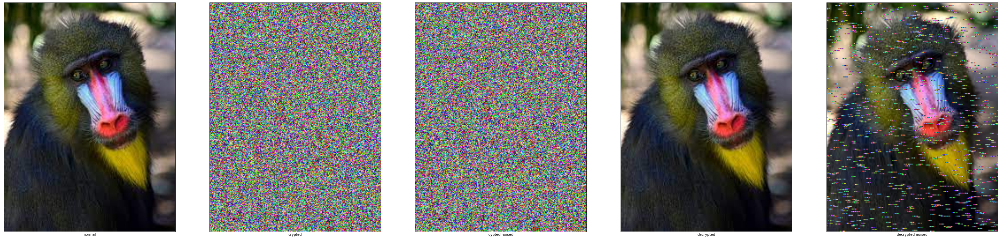

In [ ]:
img = images_data[0]

crypted_AES_ECB_ctb, crypted_AES_ECB_img, dim = encrypt_AES_ECB(img,key)
crypted_AES_ECB_ctb_noised, crypted_AES_ECB_img_noised, dim_n = encrypt_AES_ECB(img,key)

#crypted_AES_ECB_ctb_noised = bytes(noise_AES(crypted_AES_ECB_ctb_noised, dim_n, bit_mask = (0,0,0,0,0,0,0,1), noise_probability=0.01))
#crypted_AES_ECB_img_noised = np.reshape(bytearray(crypted_AES_ECB_ctb_noised[:(dim_n[0] * dim_n[1] * 3)]), (dim_n[0], dim_n[1], 3))

crypted_AES_ECB_ctb_noised = bytes(noise_AES_withblocks(crypted_AES_ECB_ctb_noised, dim_n, bit_mask = (0,0,0,0,0,0,0,1), noise_probability=.1, block_size = AES.block_size))
crypted_AES_ECB_img_noised = np.reshape(bytearray(crypted_AES_ECB_ctb_noised[:(dim_n[0] * dim_n[1] * 3)]), (dim_n[0], dim_n[1], 3))

decrypted_AES_ECB_img = decrypt_AES_ECB(crypted_AES_ECB_ctb,key,dim)
decrypted_AES_ECB_img_noised  = decrypt_AES_ECB(crypted_AES_ECB_ctb_noised,key,dim_n)

afficher_img([img, crypted_AES_ECB_img,crypted_AES_ECB_img_noised,decrypted_AES_ECB_img, decrypted_AES_ECB_img_noised],['normal', 'crypted', 'cypted noised', 'decrypted', 'decrypted noised'], color = None, axis = 0)

In [ ]:
# Pipeline utilisation
img = cipher_img(images_data[0], encrypt = True)
print(img)

[<__main__.IMG_cipher object at 0x7f5073a44460>, {'mode': <cipher_mode.AES_ECB: (1, 0)>, 'encript': True, 'key': b'U\xbc#5\x98S\xf12G\xdb\x11\x9f\x99\xc4\xc1e'}]
